In [2]:
import numpy as np
import matplotlib.pyplot as plt
from netCDF4 import Dataset
from scipy import interpolate
from datetime import datetime as dt
import cmocean
import datetime
from matplotlib.dates import DateFormatter
import glob
import math
# from astropy.convolution import convolve
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import matplotlib as mpl
import matplotlib.dates as mdates
from scipy.optimize import curve_fit
import pandas as pd
import csv
myFmt = mdates.DateFormatter('%m-%d')

### General functions

In [16]:
def load_netcdf(filepath, in_vars):
    """ open netcdf file, load variables (in_vars should be a list) and
        output dictionary of variables"""

    out_vars = {}

    open_netcdf = Dataset(filepath, mode = 'r')
    if len(in_vars)>0:
        for var in in_vars:
            out_vars[var] = open_netcdf.variables[var][:]
    else:
        for var in open_netcdf.variables.keys():
            out_vars[var] = open_netcdf.variables[var][:]

    try:
        out_vars['time_unit'] = open_netcdf.variables['time'].units
    except:
        None
    open_netcdf.close()

    return out_vars

In [3]:
def round_up_to_even(f):
    if np.isnan(f):
        return np.nan
    else:
        return math.ceil(f / 2.) * 2

def round_down_to_even(f):
    if np.isnan(f):
        return np.nan
    else:
        return 2 * (f // 2)

In [4]:
def calc_sw_ext(sw_sfc, kappa, depths_in, f_nir=0.5):
    """ swc_sfc is net SW from the atmosphere (SWD-SWU) 
    kappa is snow extinction coefficient, which is going to be used as a tuning parameter
    f_nir is the fraction of SW that is assumed to be NIR (as opposed to visible)
    depths is assumed to be centimeters below the surface with intervals of 2cm, i.e., 2, 4, 6 etc 
    should depths start at 0 or 2? """

    ## so that absorbed SW, clacluated as the difference between levels, covers the temperature
    # depths_in += .01

    ## transmitted SW at each level
    sw_t = f_nir*sw_sfc*np.ma.exp(-kappa*np.abs(depths_in))

    ## absorbed SW at each level
    # indexing will need to change to use SWN timeseries
    sw_a = sw_t[:,:-1] - sw_t[:,1:]

    sfc_sw_a = sw_sfc[:,0]-sw_t[:,1]

    sw_a = np.concatenate((sfc_sw_a[:, np.newaxis], sw_a), axis=1)
    
    return sw_a, sw_t

In [5]:
def nearest(items, pivot):
    return min(items, key=lambda x: abs(x - pivot))

In [6]:
def get_percentile_bin_vals(x_in, y_in, bins_in, p=90):
    bins_xs = []
    bins_ys = []
    # print('input', bins_in)
    for b0, b1 in zip(bins_in[:-1], bins_in[1:]):
        bin_idx = np.where((x_in>=b0)&(x_in<b1))[0]
        # get median of upper quartile (check impact of that choice)

        y_in_bin = y_in[bin_idx]

        # original version of only taking the mean/median
        bins_xs.append( np.median([b0,b1]) )
        
        if y_in_bin.shape[0]<1:
            bins_ys.append(np.nan)
            # print(x_in_bin.shape)
            continue
            
        bin_upper_quart_val = np.percentile(y_in_bin[~y_in_bin.mask], p)
        bin_upper_quart_idx = np.ma.where(y_in_bin>=bin_upper_quart_val)
        
        bin_med = np.ma.median(y_in_bin[bin_upper_quart_idx])
        bins_ys.append(bin_med)

        ## new version using all the data
        
        # if y_in_bin.shape[0]<1:
        #     # bins_ys.append(np.nan)
        #     # bins_xs.append(np.nan)
            
        #     if b0==bins_in[0]:
        #         # print('making nan arrays')
        #         bins_xs = np.array([np.nan])
        #         bins_ys = np.array([np.nan])

        #     continue
            
        # bin_upper_quart_val = np.percentile(y_in_bin[~y_in_bin.mask], p)
        # bin_upper_quart_idx = np.ma.where(y_in_bin>=bin_upper_quart_val)

        # y_bin_vals = y_in_bin[bin_upper_quart_idx]
        # x_bin_vals = x_in[bin_idx][bin_upper_quart_idx]

        # if b0==bins_in[0]:
        #     bins_xs = x_bin_vals
        #     bins_ys = y_bin_vals
        # else:
        #     bins_xs = np.ma.concatenate((bins_xs, x_bin_vals))
        #     bins_ys = np.ma.concatenate((bins_ys, y_bin_vals))

    
    bins_xs = np.ma.masked_invalid(bins_xs)
    bins_ys = np.ma.masked_invalid(bins_ys)
    
    return bins_xs, bins_ys

In [7]:
def get_max_bin_vals(x_in, y_in, bins_in):
    bins_xs = []
    bins_ys = []

    # x_in = x_in[y_in.mask]
    # y_in = y_in[y_in.mask]

        
    # if len(y_in)<1:
    #     bins_xs.append( np.mean([b0,b1]) )
    #     bins_ys.append(np.nan)
    # print('input counts', x_in.count(), y_in.count())
    # for b0, b1 in zip(percentiles[:-1], percentiles[1:]):
    for b0, b1 in zip(bins_in[:-1], bins_in[1:]):
        
        bin_idx = np.ma.where((x_in>=b0)&(x_in<b1))[0]
        # print('bin len', len(bin_idx))
        bins_xs.append( np.mean([b0,b1]) )
        if len(bin_idx)<1:
            bins_ys.append(np.nan)
        else:
            bin_max = y_in[bin_idx].max()
            bins_ys.append(bin_max)
    
    bins_xs = np.ma.masked_invalid(bins_xs)
    bins_ys = np.ma.masked_invalid(bins_ys)
    
    return bins_xs, bins_ys

def inverse_hyperbolic_sine(x, theta):
    return np.arcsinh(x / theta)

In [8]:
def inverse_hyperbolic_sine(x, theta):
    # return 0.01*np.arcsinh(x ** (1./theta))
    # return np.arcsinh( (x**(1./theta)) * theta)
    return np.arcsinh( x* theta)

In [9]:
def arctan_func(x, a, b, c, d):
    return a * np.arctan(b * (x - c)) + d

In [10]:
def func(x, a, b):
  # return 1 - 1/(1 + a*x)
  return b*(x / (a + x))


In [11]:
def exponential_func(x, a, b, c):
    return a * np.exp(b * x) + c

In [12]:
def calc_func_temp_correct(sw_in, wspd_in, params_from_wind, fit='spline'):

    
    if fit=='linear':
        par_a = params_from_wind['a']['slope']*wspd_in + params_from_wind['a']['intercept']
        par_b = params_from_wind['b']['slope']*wspd_in + params_from_wind['b']['intercept']
    elif fit=='spline':
        par_a = params_from_wind['a']['spline'](wspd_in)
        par_b = params_from_wind['b']['spline'](wspd_in)

    temp_corrs = func(sw_in, par_a, par_b)

    
    return temp_corrs

In [13]:
def calc_func_correct_bins(sw_in, wspd_in, params_from_wind):
    xs = np.linspace(0,100,21)

    temp_corrs = np.zeros(sw_in.shape)

    sw_mask = sw_in.mask.copy()
    sw_in[np.where(sw_in<0)] = 0
    
    for (wl, wh) in params_from_wind.keys():
        w_idx = np.where((wspd_in>=wl)&(wspd_in<wh))
        wind_temp_corrs = func(sw_in, params_from_wind[(wl, wh)][0], params_from_wind[(wl, wh)][1])
        temp_corrs[w_idx] = wind_temp_corrs[w_idx]

        
        print((wl, wh), np.ma.max(wind_temp_corrs[w_idx]), np.ma.max(sw_in[w_idx]))
        # plt.plot(xs, func(xs, params_from_wind[(wl, wh)][0], params_from_wind[(wl, wh)][1]), label=wl)

    # plt.legend(loc='best')
    # plt.show()
    temp_corrs = np.ma.masked_array(temp_corrs, mask=sw_mask)
    sw_in = np.ma.masked_array(sw_in, mask=sw_mask)
    return temp_corrs

In [14]:
def calc_ihs_temp_correct(sw_in, wspd_in, ihs_param_from_wind, fit='spline'):

    if fit=='linear':
        theta = ihs_param_from_wind['slope']*wspd_in+ihs_param_from_wind['intercept']
    elif fit=='spline':
        theta = ihs_param_from_wind['spline'](wspd_in)
        
    temp_corrs = abs(inverse_hyperbolic_sine(sw_in, theta))

    
    return temp_corrs

### Load data

In [17]:
simba_filepath = '/psd3data/arctic/raven/simba/level1/'
lev1_files = glob.glob(simba_filepath+'*.nc')
lev1_files.sort()

## on our server the simba files include some days from march during testing; this gets rid of those files
lev1_files = lev1_files[5:]

## these are the only variables I've used so far from the SIMBA
varnames = ['temperature','height','time']

season_data = {}

for fname in lev1_files[:]:
    fdic = load_netcdf(fname, varnames)

    fstart_time = dt.strptime(fdic['time_unit'][-19:], '%Y-%m-%d %H:%M:%S')
    fdic['dates'] = np.asarray([fstart_time+datetime.timedelta(minutes=int(m)) for m in fdic['time']])

    for var in ['temperature','dates']:
        if var not in season_data:
            season_data[var] = fdic[var]
        else:
            season_data[var] = np.ma.concatenate( (season_data[var], fdic[var]), axis=0 )

    ## only want one height:
    if 'height' not in season_data:
        season_data['height'] = fdic['height']
        

In [17]:
## Original surface ID
# with np.load('/home/asledd/ICECAPS/Raven_SIMBA_sfc-id_max-T-grad.npz') as npz:
#     simba_sfc_heights = np.ma.MaskedArray(**npz)

# ## I know this has 15 minute time steps, so average over several hours
# kernel_avg_hrs= [1./(4*6+1)]*(4*6+1)

# ## broke convolve when updating cmocean; np.convolve has weird edge effects
# # simba_sfc = convolve(simba_sfc_heights, kernel_avg_hrs, boundary='extend')
# N = 4*6+1
# simba_sfc = np.convolve(simba_sfc_heights, np.ones(N)/N, mode='same')

# simba_sfc = np.ma.masked_invalid([round_up_to_even(height) for height in simba_sfc]) ## can also do round_down_to_even()
# simba_sfc = np.ma.masked_where(season_data['dates']<dt(2024,5,15,3), simba_sfc) # masked weird edges
# simba_sfc = np.ma.masked_where(season_data['dates']>=dt(2024,8,22,21), simba_sfc)



# ## this was a day with quick accumulation that gets unrealistically smoothed in the surface height
# simba_sfc = np.ma.masked_where((season_data['dates']>=dt(2024,6, 25))&(season_data['dates']<dt(2024,6, 26)), simba_sfc)
# # print(simba_sfc)
# # simba_sfc -= 6.
# # simba_sfc_heights -= 6.
# # print(simba_sfc)

# # simba_sfc_dn = np.ma.masked_where((season_data['dates']>=dt(2024,6, 25))&(season_data['dates']<dt(2024,6, 26)), simba_sfc_dn)

In [20]:
## new surface ID from michael
# df = pd.read_csv('Raven2024_SIMBA_sfc_id_v2_despiked_hourly_min.csv') 
df = pd.read_csv('Raven2024_SIMBA_sfc_id_v2_despiked_hourly_min_20250318.csv') 

# df['date_datetime'] = pd.to_datetime(df['time'], format='%Y-%m-%d %H:%M:%S')

simba_sfc_dates = np.array([dt.strptime(d, '%Y-%m-%d %H:%M:%S') for d in df['time'].values])       
simba_sfc_in = df['max_index'].values


In [19]:
## interpolate simba_sfc to have same timesteps as rest of simba data
sfc_seconds = np.asarray([(t-dt(1970,1,1)).total_seconds() for t in simba_sfc_dates])
simba_seconds = np.asarray([(t-dt(1970,1,1)).total_seconds() for t in season_data['dates']])

f_sfc = interpolate.interp1d(sfc_seconds, simba_sfc_in, 
                             fill_value=-999, bounds_error=False)
simba_sfc = f_sfc(simba_seconds)
simba_sfc = np.ma.masked_equal(simba_sfc, -999)

NOTE: simba_sfc_heights vs simba_sfc!!!

In [20]:
# turn into function later
asfs_filepath = '/psd3data/arctic/raven_process/asfs/2_level_product/'
asfs_lev2_files = glob.glob(asfs_filepath+'seb.level2.0.melt-sleighsfs.10min.*.nc')
asfs_lev2_files.sort()
# asfs_lev2_files = asfs_lev2_files[12:] # early files don't have skin_temp_surface?

# vaisala_T_Avg = average of the air temperature during the 1 min averaging interval

lev1_slow_vars = ['up_short_hemisp_qc','up_long_hemisp_qc','down_short_hemisp_qc','down_long_hemisp_qc','subsurface_heat_flux_A_qc',
                  'subsurface_heat_flux_B_qc','skin_temp_surface_qc','temp_qc','snow_depth_qc','zenith_true_qc',
                  'down_short_diffuse','down_short_direct','up_short_hemisp','up_long_hemisp','down_short_hemisp','down_long_hemisp',
                  'snow_depth','temp','brightness_temp_surface','skin_temp_surface','subsurface_heat_flux_A','subsurface_heat_flux_B',
                  'subsurface_heat_flux_C','zenith_true','base_time','time']

asfs_data_lev2 = {}

for fname in asfs_lev2_files[:]:
    print(fname)

    fdic = load_netcdf(fname, lev1_slow_vars)
    # print(fdic['time_unit'])
    fstart_time = dt.strptime(fdic['time_unit'], 'seconds since %Y-%m-%dT%H:%M:%S.000000')
    fdic['dates'] = np.asarray([fstart_time+datetime.timedelta(seconds=int(m)) for m in fdic['time']])

    for var in lev1_slow_vars[:-2]+['dates']:
        if var not in asfs_data_lev2:
            asfs_data_lev2[var] = fdic[var]
        else:
            asfs_data_lev2[var] = np.ma.concatenate( (asfs_data_lev2[var], fdic[var]), axis=0 )
asfs_data_lev2['net_short_hemisp'] = asfs_data_lev2['down_short_hemisp'] - asfs_data_lev2['up_short_hemisp']
asfs_data_lev2['albedo'] =  asfs_data_lev2['up_short_hemisp']/asfs_data_lev2['down_short_hemisp']

with np.load('/home/asledd/ICECAPS/Raven_SW-correct-tskin_emis985_all-times_20250113.npz') as npz:
    asfs_data_lev2['skin_temp'] = np.ma.MaskedArray(**npz)

/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240520.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240521.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240522.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240523.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240524.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240525.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240526.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240527.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb.level2.0.melt-sleighsfs.10min.20240528.000000.nc
/psd3data/arctic/raven_process/asfs/2_level_product/seb

In [21]:
data = np.genfromtxt('/home/asledd/ICECAPS/preliminary_raven_winds_icecaps_2024May20th_2024July23rd.csv', delimiter=',',
                         usecols=(0,5), dtype=None, encoding='utf-8')
raw_wind_spd = np.array(data[1:,1])
raw_wind_spd[np.where(raw_wind_spd=='')] = '-999'
raw_wind_spd = raw_wind_spd.astype(np.float32)

raw_wind_dates = np.asarray([dt.strptime(d, '%Y-%m-%d %H:%M:%S') for d in data[1:,0]])


## It's annoying to have the winds with different time steps, make it match the sleigh dates

wind_spd = []

for date in asfs_data_lev2['dates']:
    
    if date in raw_wind_dates:
        wind_spd.append(raw_wind_spd[np.where(date==raw_wind_dates)[0]][0])
    else:
        wind_spd.append(-999)

wind_spd = np.ma.masked_equal(wind_spd, -999)

### Set up data that gets reused and the indices for comparisons

In [22]:
simba_depths = season_data['height']
simba_dates = season_data['dates']
sleigh_dates = asfs_data_lev2['dates']

sleigh_seconds = np.asarray([(t-dt(1970,1,1)).total_seconds() for t in sleigh_dates])
simba_seconds = np.asarray([(t-dt(1970,1,1)).total_seconds() for t in simba_dates])

simba_temps = season_data['temperature']
swn = asfs_data_lev2['net_short_hemisp']
sleigh_skin = asfs_data_lev2['skin_temp']

In [23]:
## get same time intervals
sleigh_idx = np.where((sleigh_dates>dt(2024,5,20))&(sleigh_dates<dt(2024,7,25)))[0]
imb_idx = np.where((simba_dates>dt(2024,5,20))&(simba_dates<dt(2024,7,25)))[0]

In [24]:
simba_dates = simba_dates[imb_idx]
simba_temps = simba_temps[imb_idx,:]
simba_sfc = simba_sfc[imb_idx]

sleigh_dates = [sleigh_idx]

sleigh_seconds = sleigh_seconds[sleigh_idx]
simba_seconds = simba_seconds[imb_idx]

swn = swn[sleigh_idx]
wind_spd = wind_spd[sleigh_idx]
sleigh_skin = sleigh_skin[sleigh_idx]

In [25]:
## the surface is wrong on these dates because of the smoothing
masking_idx = np.where((simba_dates>=dt(2024,6,25))&(simba_dates<dt(2024,6,27)))
filling_idx = np.where((simba_dates>=dt(2024,6,24))&(simba_dates<dt(2024,6,25)))
simba_sfc[masking_idx] = simba_sfc[filling_idx].mean()

In [26]:
## for interpolating data that goes into correction
f_swn = interpolate.interp1d(sleigh_seconds[~swn.mask], swn[~swn.mask], 
                             fill_value=-999, bounds_error=False)

f_ws = interpolate.interp1d(sleigh_seconds[~wind_spd.mask], wind_spd[~wind_spd.mask], 
                            fill_value=-999, bounds_error=False)

### Functions that are specific to temp correction

In [27]:
def get_swt_for_correction(ks, fnir, swn_in, wspd_in, plt_fig=False):
    """ ks: extinction coefficient for visible radiation in snow
        fnir: fraction of SW that's in NIR range, as opposed to visible
        swn_in: SWN; 1D
        wspd: wind speed; 1D
    """
    
    # setup sw arrays
    dpths = np.arange(0,4.0,.02)
    dpths_2d = np.repeat(dpths[np.newaxis,:], swn_in.shape[0], axis=0)
    
    simba_swn_2d = np.repeat(swn_in[:,np.newaxis], dpths.shape[0], axis=1)
    simba_swn_2d = np.ma.masked_less(simba_swn_2d, 0)
    
    simba_wspd_2d = np.repeat(wspd_in[:,np.newaxis], dpths.shape[0], axis=1)

    ## calculate transmitted below surface
    if isinstance(ks, float):
        ks_vis = ks
    else:
        ks_vis = np.linspace(ks[0], ks[1], simba_swn_2d.shape[0])[:,np.newaxis]
        
    sw_abs, sw_trans = calc_sw_ext(simba_swn_2d, ks_vis, dpths_2d, f_nir=fnir)
    sw_trans = np.ma.masked_array(sw_trans, mask=simba_swn_2d.mask)

    if plt_fig:
        plt.plot(sw_trans[1020,:], -dpths_2d[0,:], marker='o')
        plt.ylabel('Distance form surface [m]')
        plt.xlabel('SW transmitted [Wm-2]')
        plt.grid(ls='--', alpha=.5)
        plt.title('$\kappa_s$={:.0f}; NIR={:.2f}'.format(ks, fnir))
        plt.show()

    return sw_trans, simba_wspd_2d

In [28]:
 def get_subsfc_above_zero_vals(dpths_in, swt_in, wspd2_in, sfc_in, sfc_dif, temp_in, melt_idx_in=False):
    
    sfc_used = sfc_in + sfc_dif

    ## could rewrite this to not use a for loop, would probably look like calc_temp_corrections()
    if isinstance(melt_idx_in, bool):
        indices = range(temp_in.shape[0])
    else:
        indices = melt_idx_in
    for idx in indices:
        
        example_profile = temp_in[idx,:]
    
        idx_sfc = sfc_used[idx]
        
        subsfc_idx = np.where(simba_depths[:-1]<=idx_sfc)[0] ## HERE changed [:-1] to [1:]
        example_profile = np.squeeze(example_profile[subsfc_idx])
        
        too_warm_idx = np.where(example_profile>0)[0]
    
        sw_abs_warm = swt_in[idx,:][too_warm_idx]
        wspd_warm = wspd2_in[idx,:][too_warm_idx]
        temp_warm = example_profile[too_warm_idx]
    
        ## still removing surface value
        if idx==indices[0]:
            all_subsfc_temps_above_f = temp_warm[1:]
            all_subsfc_swabs_above_f = sw_abs_warm[1:]
            all_subsfc_depths_f = simba_depths[:-1][subsfc_idx][too_warm_idx][1:]+abs(idx_sfc)
            all_subsfc_wspd_f = wspd_warm[1:]
        else:
            all_subsfc_temps_above_f = np.ma.concatenate((all_subsfc_temps_above_f, temp_warm[1:]))
            all_subsfc_swabs_above_f = np.ma.concatenate((all_subsfc_swabs_above_f, sw_abs_warm[1:]))
            all_subsfc_depths_f = np.ma.concatenate((all_subsfc_depths_f, simba_depths[:-1][subsfc_idx][too_warm_idx][1:]+abs(idx_sfc)))
            all_subsfc_wspd_f = np.ma.concatenate((all_subsfc_wspd_f, wspd_warm[:-1]))
            
    return all_subsfc_temps_above_f, all_subsfc_swabs_above_f, all_subsfc_depths_f, all_subsfc_wspd_f

In [29]:
def get_ihs_correction(all_subsfc_wspd_in, all_subsfc_swabs_above_in, all_subsfc_temps_above_in, \
                       all_subsfc_depths_in, ks_in, wind_ranges=[0,5,10,25], plt_figs=False, curve='ihs', binval='max', p=90):
    max_wspd = []
    ihs_vals = []

    func_vals_a = []
    func_vals_b = []

    ## the sensitivity of these bins should be tested!!!!
    sw_bin_params = {'width0':{15:1, 20:2, 25:1, 40:.1, 35:1, 30:1}, 
                     'width1':{15:10, 20:10, 25:15, 40:10, 35:10, 30:10}, 
                     'midpt':{15:15, 20:15, 25:10, 40:5, 35:10, 30:10}}
    
    # bins = np.ma.concatenate( (np.arange(0, sw_bin_params['midpt'][ks_in]+.01, sw_bin_params['width0'][ks_in]), 
    #                        np.arange(sw_bin_params['midpt'][ks_in], 70.01, sw_bin_params['width1'][ks_in])) ) # bins for absorbed SW at depth

    bins = np.percentile(all_subsfc_swabs_above_in[~all_subsfc_swabs_above_in.mask], np.arange(0,101,5))
    

    ## added this to be able to have overlapping bins of wind speed
    if not isinstance(wind_ranges[0], tuple):
        loop_winds = [(wl, wh) for wl, wh in zip(wind_ranges[:-1],wind_ranges[1:])]
    else:
        loop_winds = wind_ranges

    ## add plots to check!
    if plt_figs:
        cmap = plt.cm.turbo
        color_list = ['r','gold','mediumorchid','skyblue', 'yellowgreen']

        subf = len(loop_winds)
        fig, axs = plt.subplots(1,subf, figsize=(1+3*subf,4), constrained_layout=True, sharey=True, sharex=True)
        fig2, ax2 = plt.subplots(1, constrained_layout=True, figsize=(4,4))
        
    # for i,(w_lo, w_hi) in enumerate(zip(wind_ranges[:-1],wind_ranges[1:])):
    for i,(w_lo, w_hi) in enumerate(loop_winds):

        w_idx = np.where((all_subsfc_wspd_in>=w_lo)&(all_subsfc_wspd_in<w_hi))
        sw_wind = all_subsfc_swabs_above_in[w_idx]
        temp_wind = all_subsfc_temps_above_in[w_idx]

        ## mask values at depths where there isn't SW
        # print(temp_wind.count())
        # temp_wind = np.ma.masked_where(sw_wind<0.01, temp_wind)

        ## exact choice of percentiles vs max vs whatever can be tested
        if binval=='max':
            bin_xs, bin_ys = get_max_bin_vals(sw_wind, temp_wind, bins)
        elif binval=='percentile':
            bin_xs, bin_ys = get_percentile_bin_vals(sw_wind, temp_wind, bins, p=p)

        ## force (0,0) point
        bin_xs = np.ma.concatenate( ([0],bin_xs) )
        bin_ys = np.ma.concatenate( ([0],bin_ys) )
    
        bin_xs = np.squeeze(bin_xs[~bin_ys.mask])
        bin_ys = np.squeeze(bin_ys[~bin_ys.mask])

        # if curve=='ihs':
        # IHS fit
        popt, pcov = curve_fit(inverse_hyperbolic_sine, bin_xs, bin_ys)
        
        # Extract the fitted parameter
        theta_fit = popt[0]
        ihs_vals.append(theta_fit)
        # print(w_lo, theta_fit)
        # max_wspd.append(w_lo)   
        max_wspd.append(np.ma.median(all_subsfc_wspd_in[w_idx]))

        # another curve equation
        popt, pcov = curve_fit(func, bin_xs, bin_ys)
    
        # Extract the fitted parameter
        a_fit = popt[0]
        b_fit = popt[1]
    
        func_vals_a.append(a_fit)
        func_vals_b.append(b_fit)
        
        y_fit = func(bin_xs, a_fit, b_fit)

        ## exponential fit
        # popt, pcov = curve_fit(exponential_func, bin_xs, bin_ys, p0=[1, 1, 1])
        # y_fit = exponential_func(bin_xs, popt[0], popt[1], popt[2])


        if plt_figs:
            cb = axs[i].scatter(sw_wind, temp_wind, 
                    c=all_subsfc_depths_in[w_idx], vmin=-20, vmax=0, cmap=cmap)
            axs[i].plot(bin_xs, bin_ys, c='gray', marker='o')

            # y_fit = inverse_hyperbolic_sine(bin_xs, theta_fit)
            axs[i].plot(bin_xs, y_fit, c='k', marker='^')
            # axs[i].plot(bin_xs, y_fit, c='k', marker='*')
            col = plt.cm.turbo(i/len(wind_ranges))
            ax2.plot(bin_xs, y_fit, marker='o', label='{:.0f}-{:.0f} m/s'.format(w_lo, w_hi), c=col)
        
            
            axs[i].set_title('wind speed: {:.0f}-{:.0f} m/s'.format(w_lo, w_hi))
            axs[i].grid(alpha=.5, ls='--')
            axs[i].set_xlabel('Transmitted SW [W m-2]')
            axs[i].set_ylabel('Temperature [C]')
    
    ## now take those curves and generalize to all wind speeds
    ihs_param_wind_regressions = {}

    # save for later
    par = np.polyfit(max_wspd, ihs_vals, 1, full=True)
    ihs_param_wind_regressions['slope'] = par[0][0]
    ihs_param_wind_regressions['intercept'] = par[0][1]

    t, c, k = interpolate.splrep(max_wspd, ihs_vals, k=1)
    spline = interpolate.BSpline(t, c, k, extrapolate=True)
    ihs_param_wind_regressions['spline'] = spline

    # generalize to all wind speeds
    func_param_wind_regressions = {}
    labels = ['a','b']
    for yvals, yl in zip([func_vals_a, func_vals_b], labels):
        # save for later
        par = np.polyfit(max_wspd, yvals, 1, full=True)
        func_param_wind_regressions[yl] = {'slope':par[0][0], 'intercept':par[0][1]}
    
        t, c, k = interpolate.splrep(max_wspd, yvals, k=2)
        spline = interpolate.BSpline(t, c, k, extrapolate=True)
        func_param_wind_regressions[yl]['spline'] = spline

    if plt_figs:
        plt.colorbar(cb, label='Depth below surface [cm]', ax=axs[-1])
        fig.suptitle('$\kappa_s$={:.0f}'.format(ks_in))
        
        ax2.grid(alpha=.5, ls='--')
        ax2.set_xlabel('Transmitted SW [W m-2]')
        ax2.set_ylabel('Temperature [C]')
        ax2.legend(loc='best')#, bbox_to_anchor=(1.,.6))
        # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig1_20ks_0.5nir_-6sfc.png', dpi=250)
        # fig.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig5_20ks_0.5nir_-6sfc.png', dpi=250)

        plt.show()

    if curve=='ihs':
        exmaple_sw = np.arange(0,60)

        fig, axs = plt.subplots(1,2, figsize=(8,4), constrained_layout=True, sharey=True)
        
        for wspd in range (0,18,2):
            
            # linear fit for theta parameters
            theta = ihs_param_wind_regressions['slope']*wspd+ihs_param_wind_regressions['intercept']  
            # print(wspd, theta)
            col = plt.cm.viridis(wspd/16.)
            axs[0].plot(exmaple_sw, np.abs(inverse_hyperbolic_sine(exmaple_sw, theta)), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
        
            # spline fit for theta parameters
            theta = ihs_param_wind_regressions['spline'](wspd)
            # print(theta)
            # print()
            col = plt.cm.viridis(wspd/16.)
            axs[1].plot(exmaple_sw, np.abs(inverse_hyperbolic_sine(exmaple_sw, theta)), label='{:.0f} m/s ({:.1f})'.format(wspd, theta), c=col, lw=2)
            
        ## how to remove negative output???
        axs[1].legend(loc='center left', bbox_to_anchor=(1,.6))
        
        for ax, fit in zip(axs.ravel(),['linear', 'spline']):
            # ax.set_ylim(0,5.5)
            ax.grid(alpha=.5, ls='--')
            ax.set_xlabel('Transmitted SW [W m-2]')
            ax.set_ylabel('Temperature correction [deg]')
            ax.set_title(fit)
            
        fig.suptitle('Inverse Hyperbolic Sine Fit')
        # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig2_20ks_0.5nir_-6sfc.png', dpi=250)

        # plt.tight_layout()
        plt.show()

        ## scatter plot of theta/ihs parameter vs wind speed
        fig, ax = plt.subplots(1, figsize=(3,3))
        ax.scatter(max_wspd, ihs_vals)
        ax.grid(alpha=.5, ls='--')
        ax.set_xlabel('Median wind speed in bin [m/s]')
        ax.set_ylabel('IHS parameter')
        plt_par = np.polyfit(max_wspd, ihs_vals, 1, full=True)
        plt_t, plt_c, plt_k = interpolate.splrep(max_wspd, ihs_vals, k=2)
        plt_spline = interpolate.BSpline(plt_t, plt_c, plt_k, extrapolate=True)
        plt.plot(max_wspd, plt_par[0][0]*np.array(max_wspd)+plt_par[0][1], c='r')
        ax.plot(max_wspd, plt_spline(max_wspd), c='purple')
        # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig3_20ks_0.5nir_-6sfc.png', dpi=250)

        plt.show()
        # print(ihs_param_wind_regressions)
        return ihs_param_wind_regressions
    
        
    elif curve=='func':
        exmaple_sw = np.arange(0,60)
        fig, axs = plt.subplots(1,2, figsize=(8,4), constrained_layout=True, sharey=True)
        
        
        for wspd in range (0,6,2):
        # for wspd in range (0,18,2):
            log_a = func_param_wind_regressions['a']['slope']*wspd+func_param_wind_regressions['a']['intercept']
            log_b = func_param_wind_regressions['b']['slope']*wspd+func_param_wind_regressions['b']['intercept']
        
            col = plt.cm.viridis(wspd/16.)
            axs[0].plot(exmaple_sw, func(exmaple_sw, log_a, log_b), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
        
        
            # spline fit for theta parameters
            par_a = func_param_wind_regressions['a']['spline'](wspd)
            par_b = func_param_wind_regressions['b']['spline'](wspd)
        
            col = plt.cm.viridis(wspd/16.)
            # axs[1].plot(exmaple_sw, np.abs(inverse_hyperbolic_sine(exmaple_sw, theta)), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
            axs[1].plot(exmaple_sw, func(exmaple_sw, par_a, par_b), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
        
        
        axs[1].legend(loc='center left', bbox_to_anchor=(1,.6))
        
        for ax, fit in zip(axs.ravel(),['linear', 'spline']):
            # ax.set_ylim(0,5.5)
            ax.grid(alpha=.5, ls='--')
            ax.set_xlabel('Transmitted SW [W m-2]')
            ax.set_ylabel('Temperature correction [deg]')
            ax.set_title(fit)
            
        # plt.tight_layout()
        fig.suptitle('f(x)=b*x/(a+x) fit')
        plt.show()

    # elif curve=='arctan':
        

        return func_param_wind_regressions

In [30]:
def get_func_correction(all_subsfc_wspd_in, all_subsfc_swabs_above_in, all_subsfc_temps_above_in, \
                       all_subsfc_depths_in, ks_in, wind_ranges=[0,3,6,25], plt_figs=False, binval='max', p=90):
    max_wspd = []
    ihs_vals = []

    func_vals_a = []
    func_vals_b = []

    bins = np.percentile(all_subsfc_swabs_above_in[~all_subsfc_swabs_above_in.mask], np.arange(0,101,5))

    ## instead of regressing, will just bin
    func_param_wind_regressions = {}

    ## added this to be able to have overlapping bins of wind speed
    if not isinstance(wind_ranges[0], tuple):
        loop_winds = [(wl, wh) for wl, wh in zip(wind_ranges[:-1],wind_ranges[1:])]
    else:
        loop_winds = wind_ranges

    ## add plots to check!
    if plt_figs:
        cmap = plt.cm.turbo
        color_list = ['r','gold','mediumorchid','skyblue', 'yellowgreen']

        subf = len(loop_winds)
        fig, axs = plt.subplots(1,subf, figsize=(1+3*subf,4), constrained_layout=True, sharey=True, sharex=True)
        fig2, ax2 = plt.subplots(1, constrained_layout=True, figsize=(4,4))
        
    # for i,(w_lo, w_hi) in enumerate(zip(wind_ranges[:-1],wind_ranges[1:])):
    for i,(w_lo, w_hi) in enumerate(loop_winds):

        w_idx = np.where((all_subsfc_wspd_in>=w_lo)&(all_subsfc_wspd_in<w_hi))
        sw_wind = all_subsfc_swabs_above_in[w_idx]
        temp_wind = all_subsfc_temps_above_in[w_idx]

        ## mask values at depths where there isn't SW
        # print(temp_wind.count())
        # temp_wind = np.ma.masked_where(sw_wind<0.01, temp_wind)

        ## exact choice of percentiles vs max vs whatever can be tested
        if binval=='max':
            bin_xs, bin_ys = get_max_bin_vals(sw_wind, temp_wind, bins)
        elif binval=='percentile':
            bin_xs, bin_ys = get_percentile_bin_vals(sw_wind, temp_wind, bins, p=p)

        ## force (0,0) point
        bin_xs = np.ma.concatenate( ([0],bin_xs) )
        bin_ys = np.ma.concatenate( ([0],bin_ys) )
    
        bin_xs = np.squeeze(bin_xs[~bin_ys.mask])
        bin_ys = np.squeeze(bin_ys[~bin_ys.mask])


        # another curve equation
        popt, pcov = curve_fit(func, bin_xs, bin_ys)
    
        # Extract the fitted parameter
        a_fit = popt[0]
        b_fit = popt[1]
    
        func_vals_a.append(a_fit)
        func_vals_b.append(b_fit)
        
        # y_fit = func(bin_xs, a_fit, b_fit)
        y_fit = func(bins, a_fit, b_fit)

        ## save for later
        func_param_wind_regressions[(w_lo, w_hi)] = (a_fit, b_fit)

        if plt_figs:
            cb = axs[i].scatter(sw_wind, temp_wind, 
                    c=all_subsfc_depths_in[w_idx], vmin=-20, vmax=0, cmap=cmap)
            axs[i].plot(bin_xs, bin_ys, c='gray', marker='o')

            # y_fit = inverse_hyperbolic_sine(bin_xs, theta_fit)
            axs[i].plot(bin_xs, y_fit, c='k', marker='^')
            # axs[i].plot(bin_xs, y_fit, c='k', marker='*')
            col = plt.cm.turbo(i/len(wind_ranges))
            ax2.plot(bin_xs, y_fit, marker='o', label='{:.0f}-{:.0f} m/s'.format(w_lo, w_hi), c=col)
        
            
            axs[i].set_title('wind speed: {:.0f}-{:.0f} m/s'.format(w_lo, w_hi))
            axs[i].grid(alpha=.5, ls='--')
            axs[i].set_xlabel('Transmitted SW [W m-2]')
            axs[i].set_ylabel('Temperature [C]')
    


    if plt_figs:
        plt.colorbar(cb, label='Depth below surface [cm]', ax=axs[-1])
        fig.suptitle('$\kappa_s$={:.0f}'.format(ks_in))
        
        ax2.grid(alpha=.5, ls='--')
        ax2.set_xlabel('Transmitted SW [W m-2]')
        ax2.set_ylabel('Temperature [C]')
        ax2.legend(loc='best')#, bbox_to_anchor=(1.,.6))
        # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig1_20ks_0.5nir_-6sfc.png', dpi=250)
        # fig.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig5_20ks_0.5nir_-6sfc.png', dpi=250)

        plt.show()


    # exmaple_sw = np.arange(0,60)
    # fig, axs = plt.subplots(1,2, figsize=(8,4), constrained_layout=True, sharey=True)
    
    
    # for wspd in range (0,6,2):
    # # for wspd in range (0,18,2):
    #     log_a = func_param_wind_regressions['a']['slope']*wspd+func_param_wind_regressions['a']['intercept']
    #     log_b = func_param_wind_regressions['b']['slope']*wspd+func_param_wind_regressions['b']['intercept']
    
    #     col = plt.cm.viridis(wspd/16.)
    #     axs[0].plot(exmaple_sw, func(exmaple_sw, log_a, log_b), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
    
    
    #     # spline fit for theta parameters
    #     par_a = func_param_wind_regressions['a']['spline'](wspd)
    #     par_b = func_param_wind_regressions['b']['spline'](wspd)
    
    #     col = plt.cm.viridis(wspd/16.)
    #     # axs[1].plot(exmaple_sw, np.abs(inverse_hyperbolic_sine(exmaple_sw, theta)), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
    #     axs[1].plot(exmaple_sw, func(exmaple_sw, par_a, par_b), label='{:.0f} m/s'.format(wspd), c=col, lw=2)
    
    
    # axs[1].legend(loc='center left', bbox_to_anchor=(1,.6))
    
    # for ax, fit in zip(axs.ravel(),['linear', 'spline']):
    #     # ax.set_ylim(0,5.5)
    #     ax.grid(alpha=.5, ls='--')
    #     ax.set_xlabel('Transmitted SW [W m-2]')
    #     ax.set_ylabel('Temperature correction [deg]')
    #     ax.set_title(fit)
        
    # # plt.tight_layout()
    # fig.suptitle('f(x)=b*x/(a+x) fit')
    # plt.show()

    
    print(func_param_wind_regressions)
    return func_param_wind_regressions

In [31]:
def calc_temp_corrections(sfc_in, sfc_dif, ks, fnir, sw_in, dpths_in, correction_params, plt_figs=False, param_interp='linear', swt=False):
    ## differenceing surface here!!!!
    sfc_used = sfc_in + sfc_dif
    
    # make simba heights/depths relative to surface
    depths_rel_to_sfc = np.repeat(dpths_in[np.newaxis,:], sfc_in.shape[0], axis=0)
    
    sfc_height_2d = np.repeat(sfc_used[:,np.newaxis], dpths_in.shape[0], axis=1)

    depths_rel_to_sfc = depths_rel_to_sfc + abs(sfc_height_2d)
    depths_rel_to_sfc = np.ma.masked_greater(depths_rel_to_sfc, 0)/100.
    # print(depths_rel_to_sfc)
    # print()
    simba_swn_2d = np.repeat(sw_in[:,np.newaxis], depths_rel_to_sfc.shape[1], axis=1)

    if isinstance(ks, float):
        ks_vis = ks
    else:
        ks_vis = np.linspace(ks[0], ks[1], simba_swn_2d.shape[0])[:,np.newaxis]
        
    simba_swa, simba_swt = calc_sw_ext(simba_swn_2d, ks_vis, depths_rel_to_sfc, f_nir=fnir)

    # simba_swa = np.ma.masked_array(simba_swa, mask=depths_rel_to_sfc.mask)
    simba_swt = np.ma.masked_array(simba_swt, mask=depths_rel_to_sfc.mask)
    
    wspd_2d_full = np.repeat(simba_wspd[:,np.newaxis], simba_swn_2d.shape[1], axis=1)
    wspd_2d_full = np.ma.masked_array(wspd_2d_full, mask=depths_rel_to_sfc.mask)

    if param_interp=='bin':
        temp_correction = calc_func_correct_bins(simba_swt, wspd_2d_full, correction_params)
    elif 'a' in correction_params:
        temp_correction = calc_func_temp_correct(simba_swt, wspd_2d_full, correction_params, fit=param_interp)
    else:    
        temp_correction = calc_ihs_temp_correct(simba_swt, wspd_2d_full, correction_params, fit=param_interp)

    if plt_figs:
        fig, axs = plt.subplots(2, figsize=(10,8), sharex=True, sharey=True)
        cb = axs[0].contourf(simba_dates, simba_depths, np.swapaxes(simba_swt,0,1), levels=np.linspace(-.01,60,11), extend='max')
        plt.colorbar(cb, label='transmitted sw [W m-2]', ax=axs[0])
        axs[0].set_ylabel('Depth from surface [m]')
        
        cb = axs[1].contourf(simba_dates, simba_depths, np.swapaxes(temp_correction,0,1), levels=np.arange(0,5.01,.5), extend='max')
        plt.colorbar(cb, label='temperature correction [deg]', ax=axs[1])
        axs[1].set_ylabel('Depth from surface [m]')
        
        axs[0].set_ylim(-380,-320)
        axs[0].set_xlim(dt(2024,6,1),dt(2024,6,25))
        # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_fig4_20ks_0.5nir_-6sfc.png', dpi=250)

        plt.show()

    if swt:
        print(simba_swt.shape, temp_correction.shape)
        return temp_correction, simba_swt
    else:
        return temp_correction

In [32]:
def correct_compare_temp(temp_corrects, sfc_in, sfc_dif, ks, fnir, simba_temps_in, simba_dpths_in, fpath, out_correct_t=False, swi=False):
    sfc_used = sfc_in + sfc_dif

    sfc_repeat = np.repeat(sfc_used[:,np.newaxis], simba_temps_in.shape[1], axis=1)
    heights_repeat = np.repeat(simba_dpths_in[np.newaxis,:], simba_temps_in.shape[0], axis=0)
    
    sfc_seconds = np.repeat(simba_seconds[:,np.newaxis], simba_dpths_in.shape[0], axis=1)[np.where(heights_repeat==sfc_repeat)]

    
    corrected_temps = simba_temps_in - temp_corrects
    corrected_temps = np.ma.masked_where(heights_repeat>sfc_repeat, corrected_temps)
    


    ## interpolate skin temperature here
    # sleigh_skin = asfs_data_lev2['skin_temp']
    f_0_skinT = interpolate.interp1d(sleigh_seconds[~sleigh_skin.mask], sleigh_skin[~sleigh_skin.mask], fill_value=-999, bounds_error=False)
    sleigh_skinT_simba_timesteps = f_0_skinT(sfc_seconds)
    sleigh_skinT_simba_timesteps = np.ma.masked_less(sleigh_skinT_simba_timesteps, 0)-273.15

    uncorrected_simba_sfc_temp = simba_temps_in[np.where(heights_repeat==sfc_repeat)]
    corrected_simba_sfc_temp = corrected_temps[np.where(heights_repeat==sfc_repeat)]


    fig, ax = plt.subplots(1,figsize=(10,6))
    plt.plot(simba_dates[np.where(heights_repeat==sfc_repeat)[0]],sleigh_skinT_simba_timesteps, label='SLEIGH skin', c='k')

    plt.plot(simba_dates[np.where(heights_repeat==sfc_repeat)[0]],corrected_simba_sfc_temp, label='corrected simba', lw=1,  c='tab:orange')
    # plt.plot(uncorrected_simba_sfc_temp, label='UNcorrected simba', lw=1, ls='--')
    plt.legend(loc='best')
    plt.grid()
    # plt.ylim(-40,2)
    plt.show()

    if not isinstance(swi, bool):
        cb = plt.scatter(sleigh_skinT_simba_timesteps, corrected_simba_sfc_temp, c=swi[np.where(heights_repeat==sfc_repeat)])
        plt.colorbar(cb, label='SWT [W m-2]')
        plt.ylabel('Corrected SIMBA sfc temperature [C]')
        plt.xlabel('SLEIGH skin temperature [C]')
        plt.plot([sleigh_skinT_simba_timesteps.min(), sleigh_skinT_simba_timesteps.max()], 
                 [sleigh_skinT_simba_timesteps.min(), sleigh_skinT_simba_timesteps.max()], c='k')
        plt.show()
    ## summary figure here
    ## for comparisons
    output_summary = {'ts_diff_mean':{},'ts_diff_min':{},'ts_diff_max':{}, 'above_zero_count':{}, 'above_0.5_count':{}}

    fig = plt.figure(figsize=(7,7), constrained_layout=True)
    
    ax1 = plt.subplot2grid(shape=(2,2), loc=(0, 0), colspan=1)
    ax2 = plt.subplot2grid((2,2), (1, 0))
    ax3 = plt.subplot2grid(shape=(2,2), loc=(0, 1), rowspan=2)
    
    axs = [ax1, ax2, ax3]
    
    uncorrected_temps = np.ma.masked_array(simba_temps_in, mask=corrected_temps.mask)
    uncorrected_temps_positive = np.ma.masked_less(uncorrected_temps,0)
    corrected_temps_positive = np.ma.masked_less(corrected_temps, 0)
    uncorrected_temps_positive_uncert = np.ma.masked_less(uncorrected_temps,0.5)
    corrected_temps_positive_uncert = np.ma.masked_less(corrected_temps,0.5)

    for simba_var, label in zip([uncorrected_temps_positive_uncert, corrected_temps_positive_uncert], ['uncorrected','corrected']):
        output_summary['above_0.5_count'][label] = simba_var.count()

    bins = np.arange(0,8.01,.5)
    for simba_var, label in zip([uncorrected_temps_positive, corrected_temps_positive], ['uncorrected','corrected']):

        axs[0].hist(simba_var[~simba_var.mask], alpha=.6, 
                label=label+' (total: {:.0f})'.format(simba_var.count()), bins=bins)
        output_summary['above_zero_count'][label] = simba_var.count()

    axs[0].set_ylabel('Counts')
    axs[0].set_xlabel('Temperature>0 below surface [deg]')
    axs[0].legend(loc='best')

    
    for simba_var, label in zip([uncorrected_simba_sfc_temp, corrected_simba_sfc_temp], ['uncorrected','corrected']):
        sfc_temp_diff = simba_var - sleigh_skinT_simba_timesteps
        # print(label, sfc_temp_diff)
        output_summary['ts_diff_mean'][label] = sfc_temp_diff.mean()
        output_summary['ts_diff_min'][label] = sfc_temp_diff.min()
        output_summary['ts_diff_max'][label] = sfc_temp_diff.max()

        axs[1].hist(sfc_temp_diff[~sfc_temp_diff.mask], alpha=.6, label=label+' (mean: {:.1f})'.format(sfc_temp_diff.mean()),
                    bins=np.arange(-8,10,.5))
    
    axs[1].axvline(x=0, c='k', lw=1)
    axs[1].set_xlabel('SIMBA sfc -SLEIGH skin [deg]')
    axs[1].set_ylabel('Counts')
    axs[1].legend(loc='best')
    
    
    ## other good days to check: 717-7/21; originially 7/11
    for temp_data, c in zip([uncorrected_temps, corrected_temps], ['tab:blue','tab:orange']):
        st_date = dt(2024, 7, 21, 12)
        en_date = dt(2024, 7, 21, 20)
        figure_date_idx = np.where((np.asarray(simba_dates)>=st_date )&(np.asarray(simba_dates)<en_date ))[0]
    
        for i, t_idx in np.ndenumerate(figure_date_idx[1:]):
            axs[2].plot(np.squeeze(temp_data[t_idx, :-1]), simba_depths[:-1], label=t_idx, c=c)#'t=0')
    
    axs[2].set_xlabel('Temperature [deg]')
    axs[2].set_ylabel('Depth [cm]')
    axs[2].set_ylim(-340,-295)
    axs[2].set_xlim(-7,7)
    axs[2].set_title(st_date.strftime('%Y-%m-%d %H:%M')+'-'+en_date.strftime('%H:%M'))
    axs[2].axvline(x=0, c='k', lw=1)
    axs[2].axvline(x=0.5, c='k', lw=1, ls='--')
    axs[2].axvline(x=1.5, c='k', lw=1, ls='--')

    for ax in axs:
        ax.grid(ls='--', alpha=.5)
    
    axs[0].set_title('$\kappa_s$={:.0f}, NIR={:.2f}, $\Delta$ sfc={:.0f}cm'.format(ks, 1-fnir, sfc_dif))
    # plt.tight_layout()
    fname = 'Raven_SIMBA_SW-correction_summary_IHS_{:.0f}ks_{:.2f}NIR_{:.0f}sfc_spline.png'.format(ks, 1-fnir, sfc_dif)
    # plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_simba_correction_summary_20ks_0.5nir_-6sfc.png', dpi=250)

    plt.show()
    plt.close()
    # plt.save()

    if out_correct_t:
        return output_summary, corrected_temps
    else:
        return output_summary

In [33]:
mc_fig_savepath = '/home/asledd/ICECAPS/simba_solar_correction_mc_figures/'

## Looping through variables to determine "best" values

0.21717844903469086 2.89591716182013
3.7767038345336914 4.776894498222276
5.41530704498291 3.541587127519597
7.368351697921753 4.493355148459935


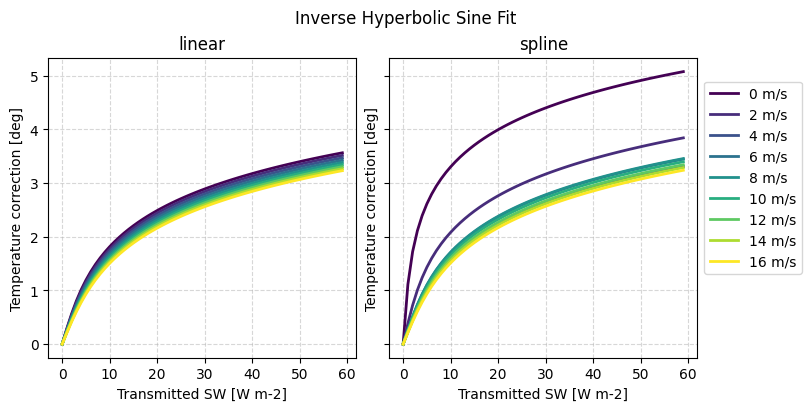

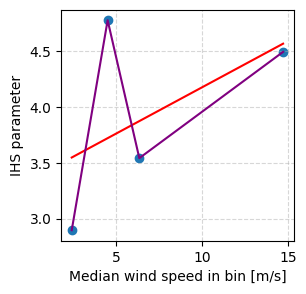

{'slope': np.float64(0.08277633588343988), 'intercept': np.float64(3.34841577091046), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3e30fa0>}
{'slope': np.float64(0.08277633588343988), 'intercept': np.float64(3.34841577091046), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3e30fa0>}


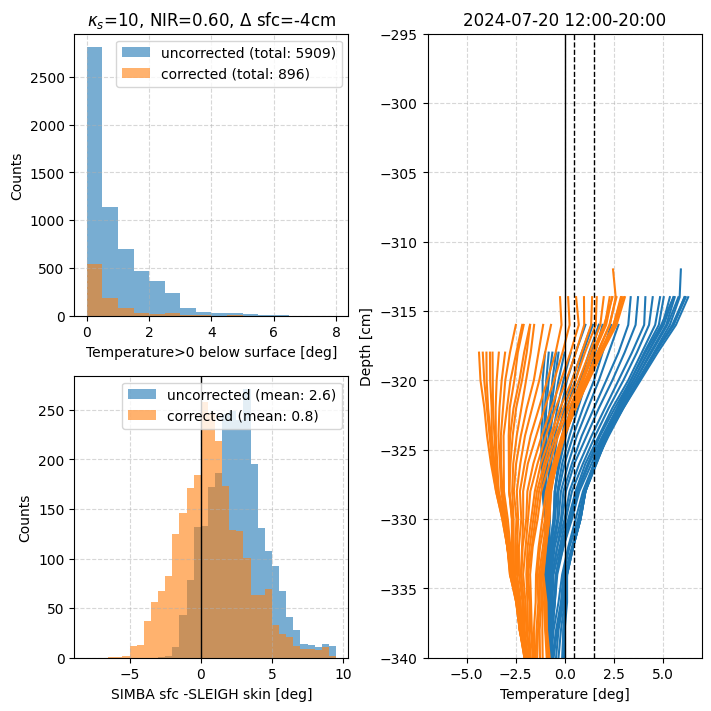

0.21717844903469086 3.2579074804060406
3.7767038345336914 5.374003367917847
5.41530704498291 3.984285476127674
7.368351697921753 5.055014855943142


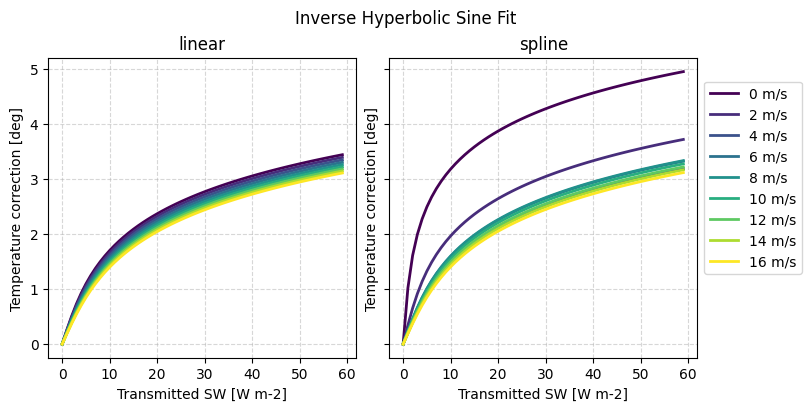

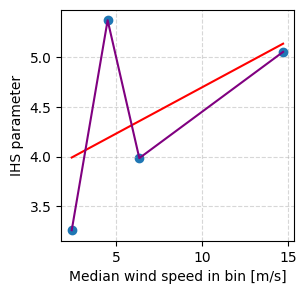

{'slope': np.float64(0.0931225705059821), 'intercept': np.float64(3.766970385515282), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3b8cac0>}
{'slope': np.float64(0.0931225705059821), 'intercept': np.float64(3.766970385515282), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3b8cac0>}


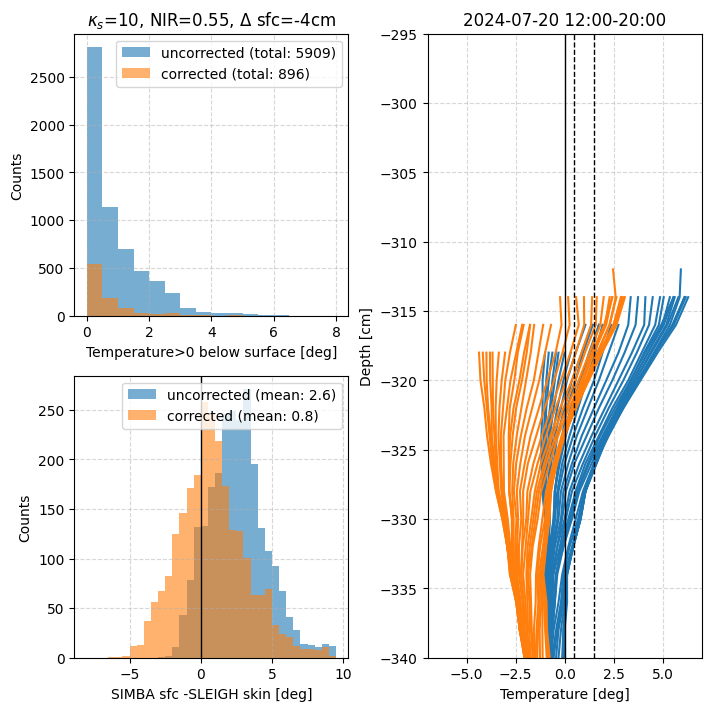

0.21717844903469086 3.619893026471733
3.7767038345336914 5.971111256383116
5.41530704498291 4.42698380673158
7.368351697921753 5.616721549833971


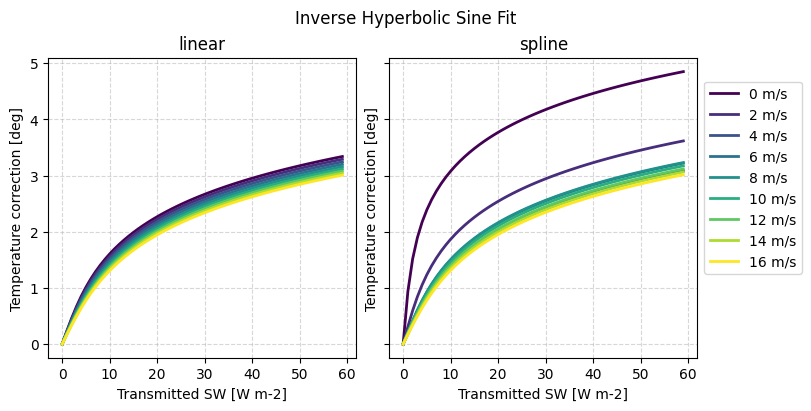

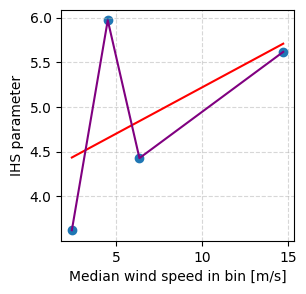

{'slope': np.float64(0.1034732374317706), 'intercept': np.float64(4.185504326474763), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3363b80>}
{'slope': np.float64(0.1034732374317706), 'intercept': np.float64(4.185504326474763), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f3363b80>}


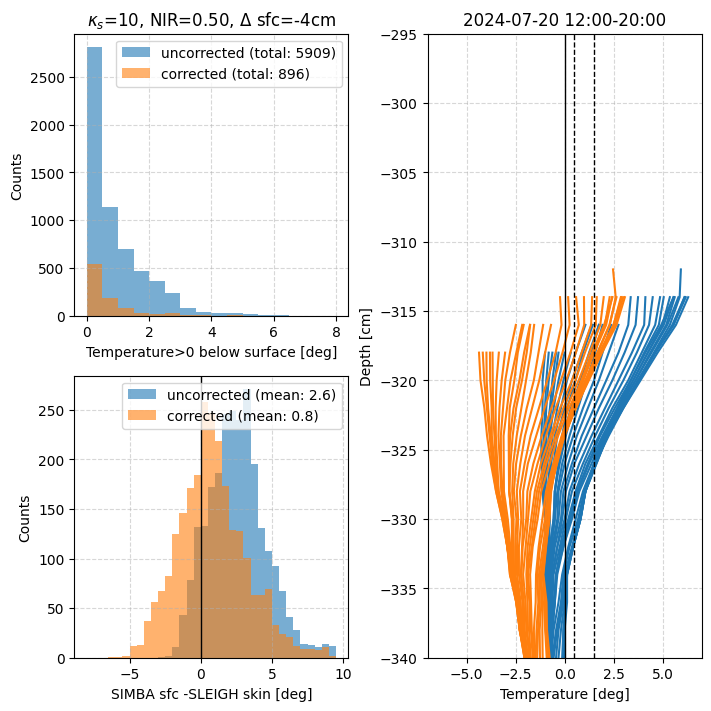

0.21717844903469086 3.981872145944289
3.7767038345336914 6.5682180509742345
5.41530704498291 4.86968210414773
7.368351697921753 6.178392829625081


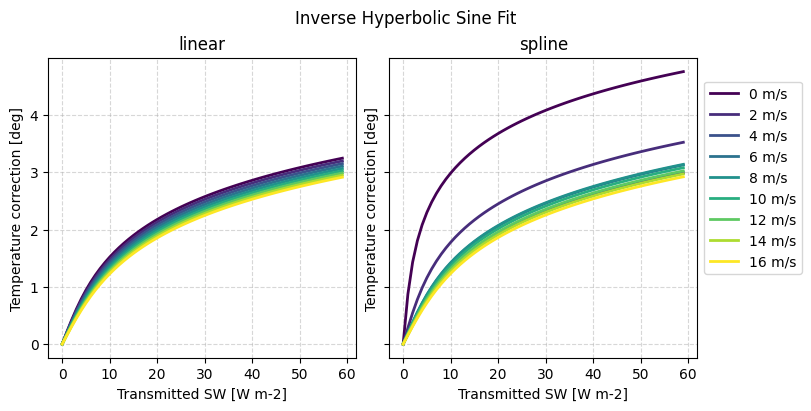

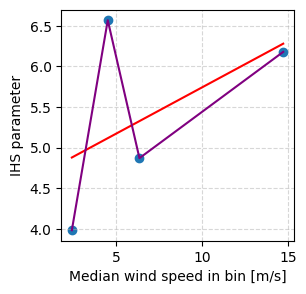

{'slope': np.float64(0.11382114221556018), 'intercept': np.float64(4.604046830069333), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f30b3fd0>}
{'slope': np.float64(0.11382114221556018), 'intercept': np.float64(4.604046830069333), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f30b3fd0>}


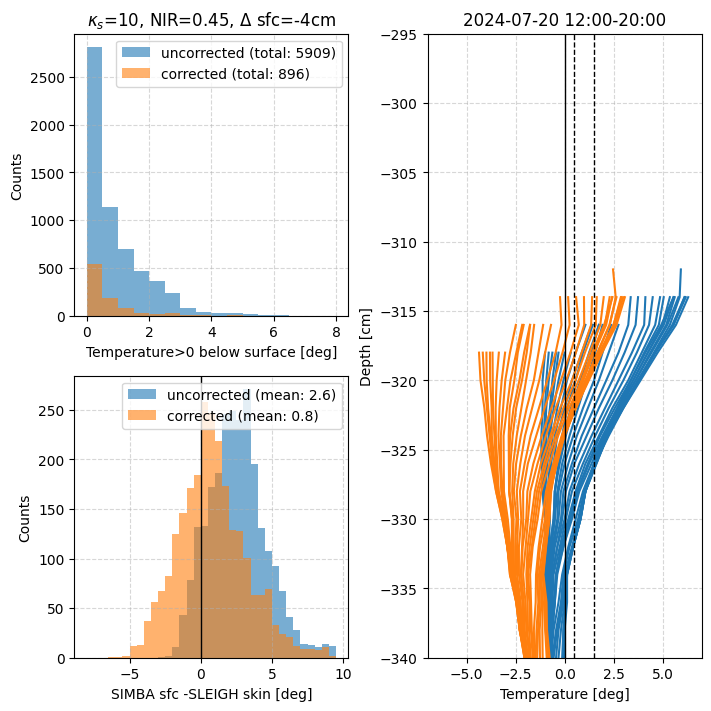

0.21717844903469086 4.343843736890762
3.7767038345336914 7.165323715975313
5.41530704498291 5.3123803586780785
7.368351697921753 6.7400638297307935


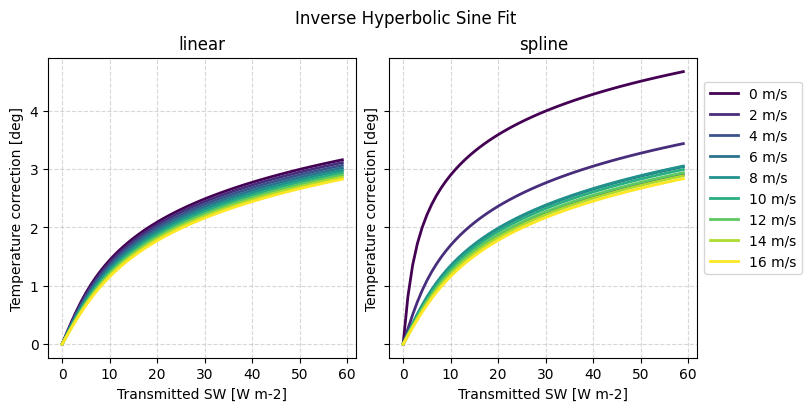

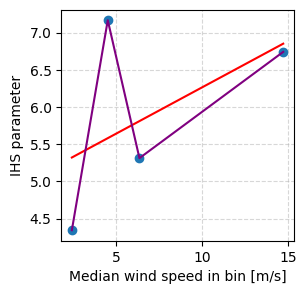

{'slope': np.float64(0.12416944978893009), 'intercept': np.float64(5.022584273401039), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f2c81d30>}
{'slope': np.float64(0.12416944978893009), 'intercept': np.float64(5.022584273401039), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f2c81d30>}


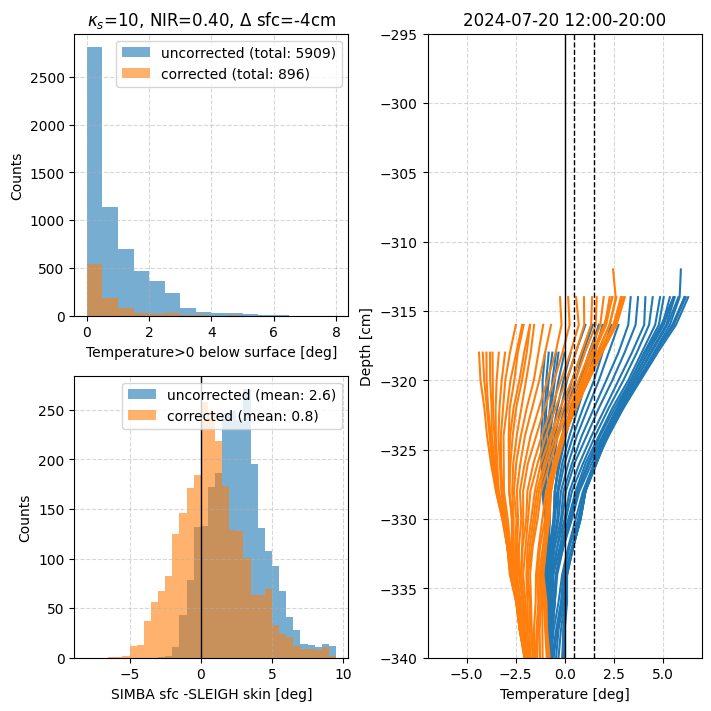

0.21717844903469086 1.9524200528681712
3.7767038345336914 4.3698503892980325
5.41530704498291 2.9321670814442435
7.368351697921753 3.4526899242505524


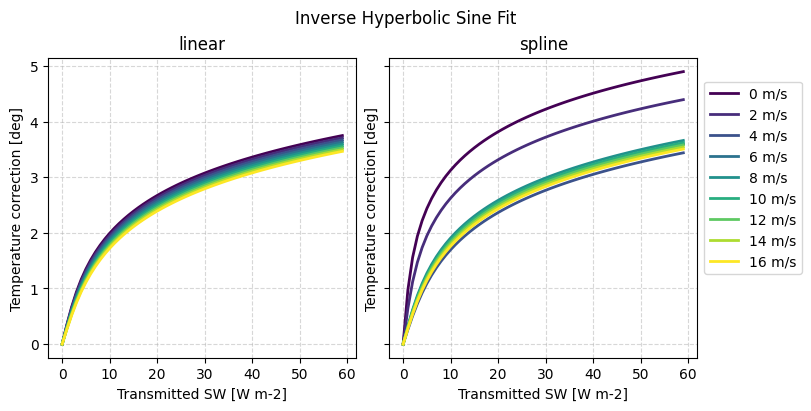

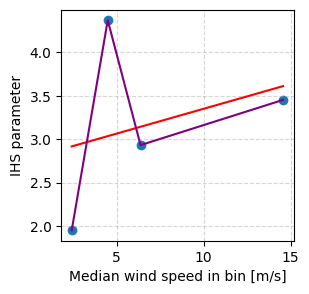

{'slope': np.float64(0.05715879818672831), 'intercept': np.float64(2.7785188015521243), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f24858e0>}
{'slope': np.float64(0.05715879818672831), 'intercept': np.float64(2.7785188015521243), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f24858e0>}


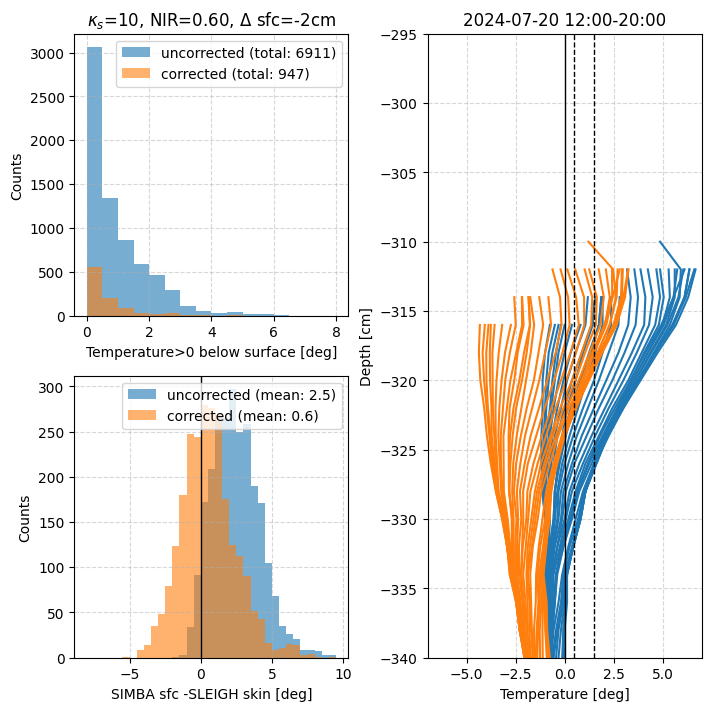

0.21717844903469086 2.1964740377231187
3.7767038345336914 4.91607828405926
5.41530704498291 3.2986881777385713
7.368351697921753 3.8842745345101175


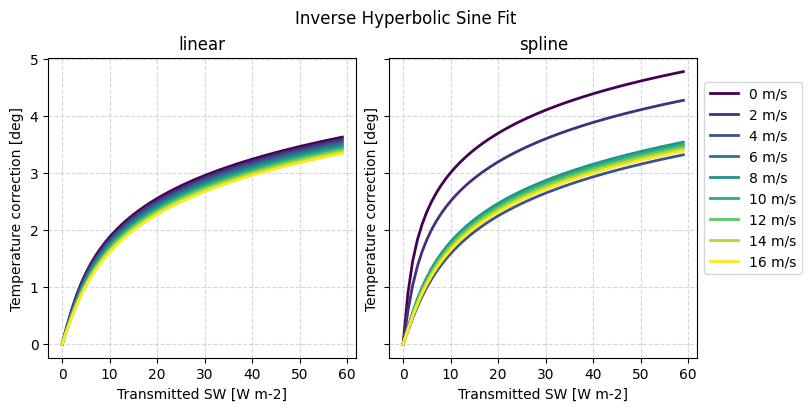

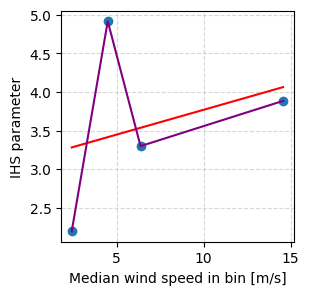

{'slope': np.float64(0.06430352056110823), 'intercept': np.float64(3.125833703215619), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f221feb0>}
{'slope': np.float64(0.06430352056110823), 'intercept': np.float64(3.125833703215619), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f221feb0>}


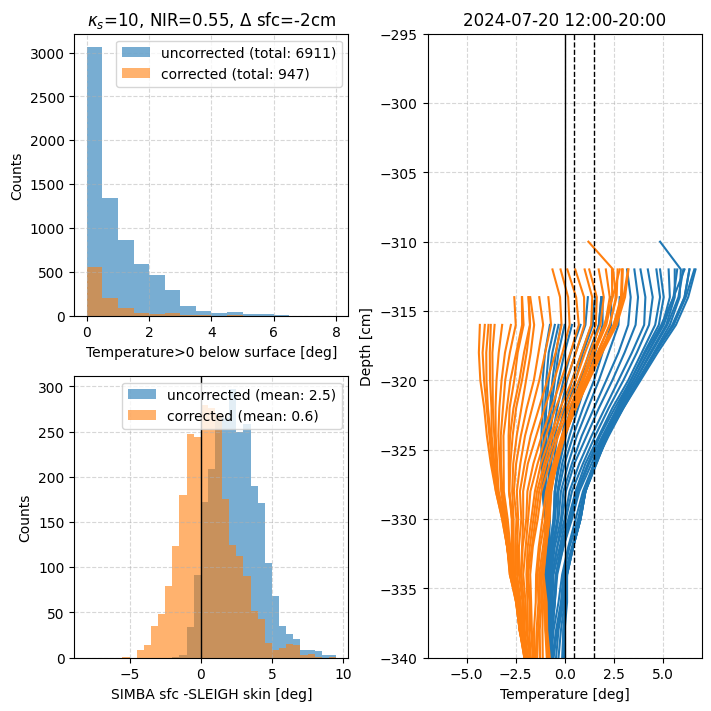

0.21717844903469086 2.4405283658705597
3.7767038345336914 5.462305047931777
5.41530704498291 3.665209082910674
7.368351697921753 4.315858426507667


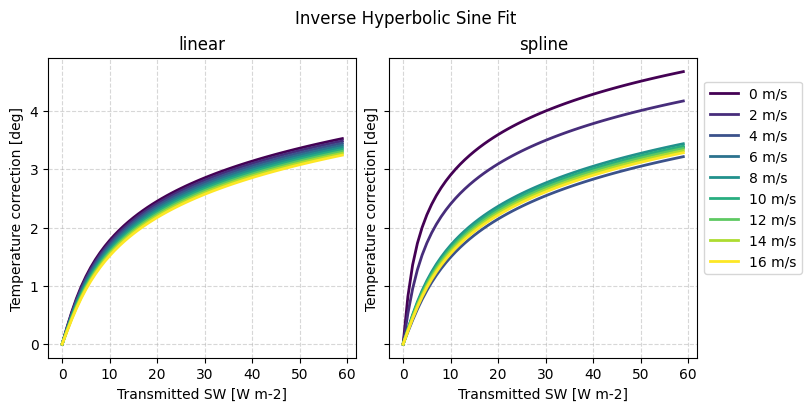

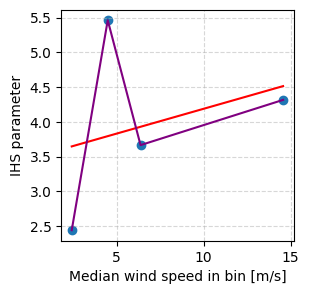

{'slope': np.float64(0.0714481945088272), 'intercept': np.float64(3.4731485180545), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f1d2ec70>}
{'slope': np.float64(0.0714481945088272), 'intercept': np.float64(3.4731485180545), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f1d2ec70>}


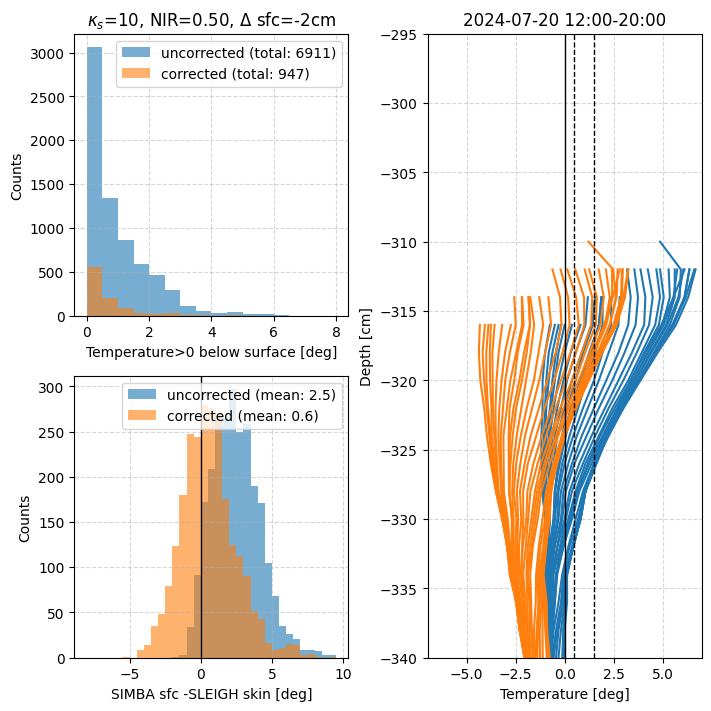

0.21717844903469086 2.684582613099125
3.7767038345336914 6.008530621962461
5.41530704498291 4.0317299920673415
7.368351697921753 4.7474415306190085


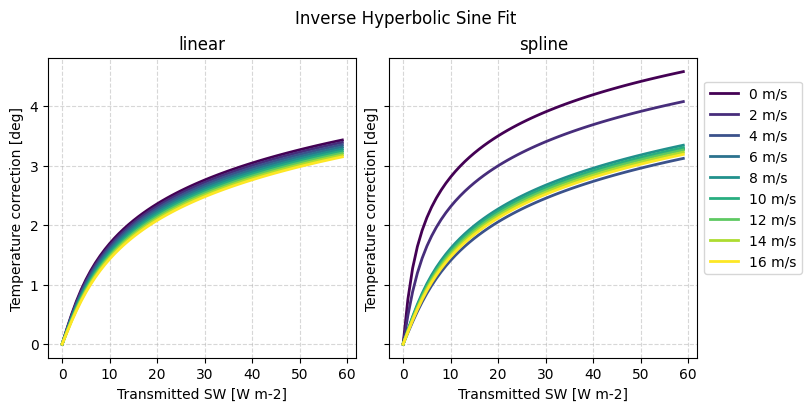

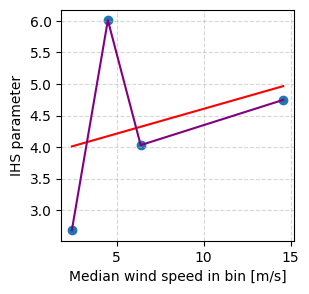

{'slope': np.float64(0.07859283686027133), 'intercept': np.float64(3.820463039379888), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75fba0a0d0>}
{'slope': np.float64(0.07859283686027133), 'intercept': np.float64(3.820463039379888), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75fba0a0d0>}


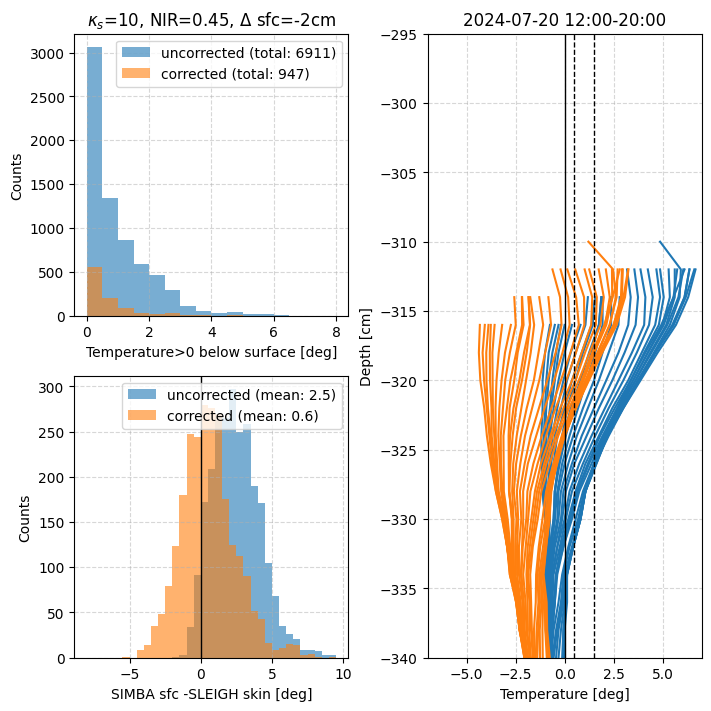

0.21717844903469086 2.928636299467055
3.7767038345336914 6.554754897693193
5.41530704498291 4.39825089169467
7.368351697921753 5.179023669964204


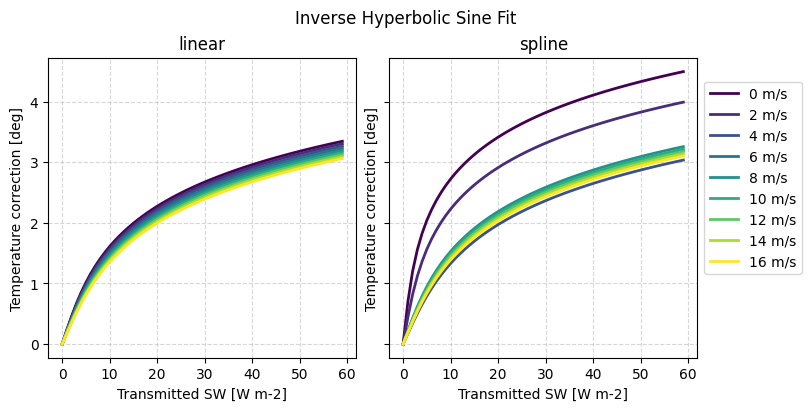

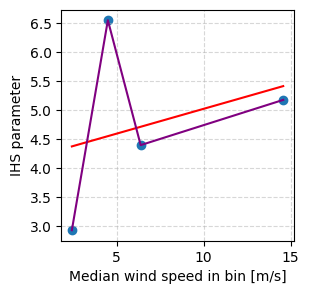

{'slope': np.float64(0.08573746070795478), 'intercept': np.float64(4.167776981269166), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f1341d60>}
{'slope': np.float64(0.08573746070795478), 'intercept': np.float64(4.167776981269166), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f1341d60>}


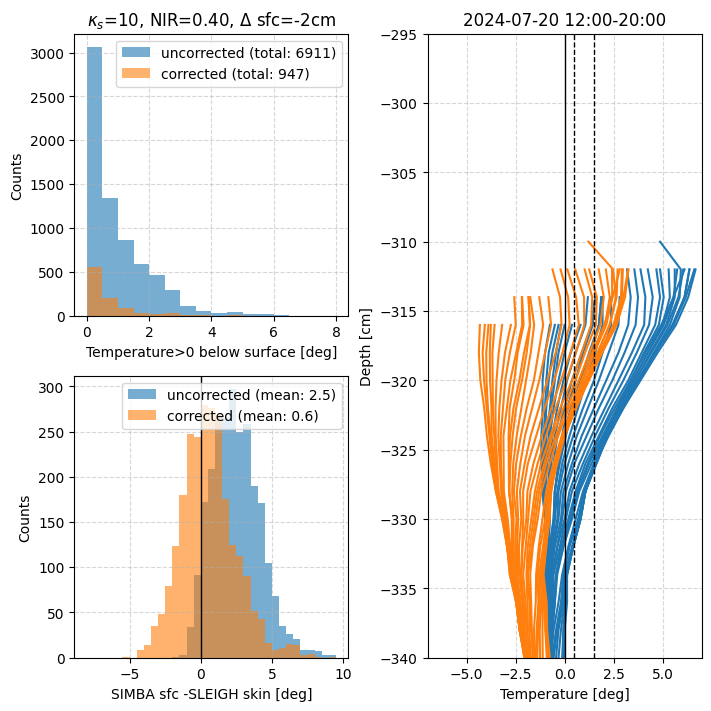

0.21717844903469086 1.3508496243594925
3.7767038345336914 3.6688266450016287
5.41530704498291 2.6285258302533747
7.368351697921753 2.931668756253403


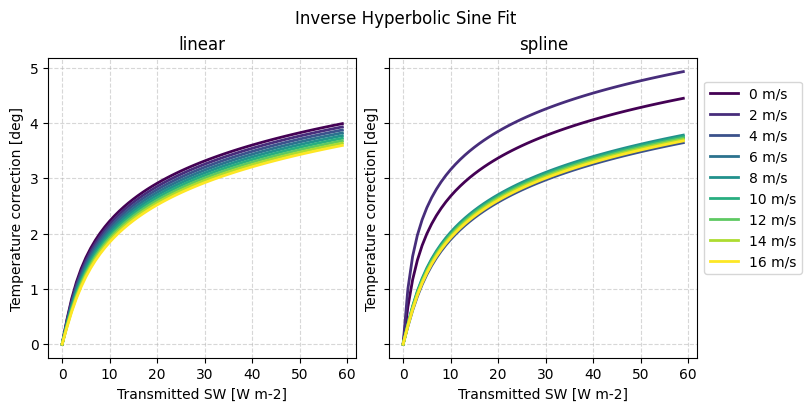

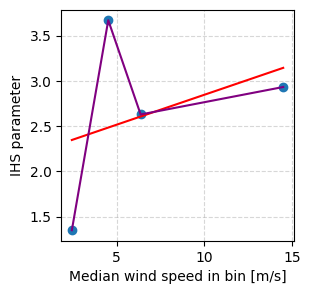

{'slope': np.float64(0.06608578200381064), 'intercept': np.float64(2.1851138966156056), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f0e4d940>}
{'slope': np.float64(0.06608578200381064), 'intercept': np.float64(2.1851138966156056), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f0e4d940>}


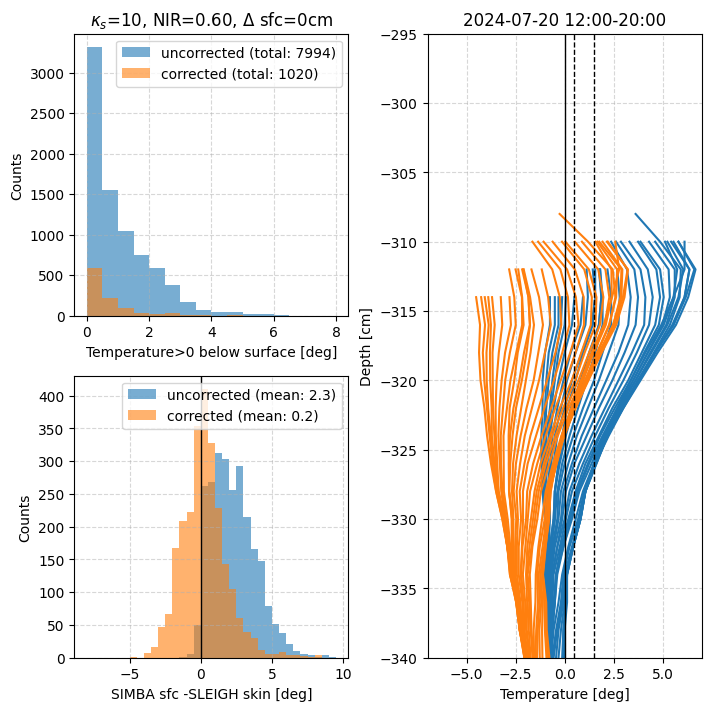

0.21717844903469086 1.519704873806528
3.7767038345336914 4.1274286125333335
5.41530704498291 2.95709272862147
7.368351697921753 3.29812646446162


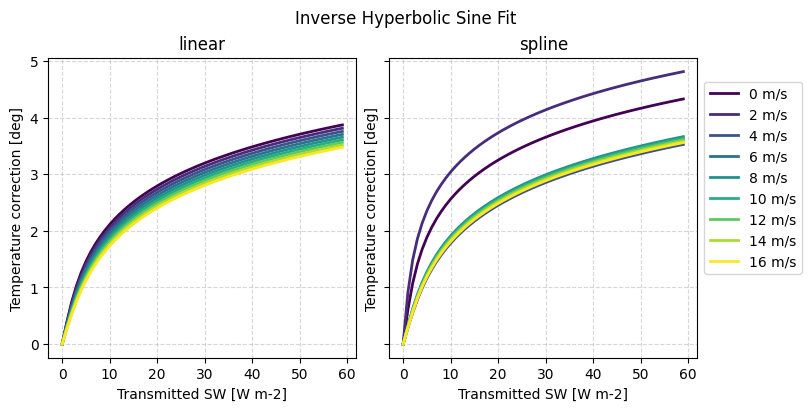

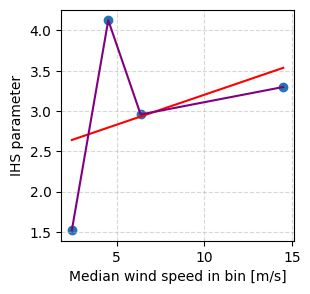

{'slope': np.float64(0.07434650778386015), 'intercept': np.float64(2.4582526042543504), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f093f4f0>}
{'slope': np.float64(0.07434650778386015), 'intercept': np.float64(2.4582526042543504), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f093f4f0>}


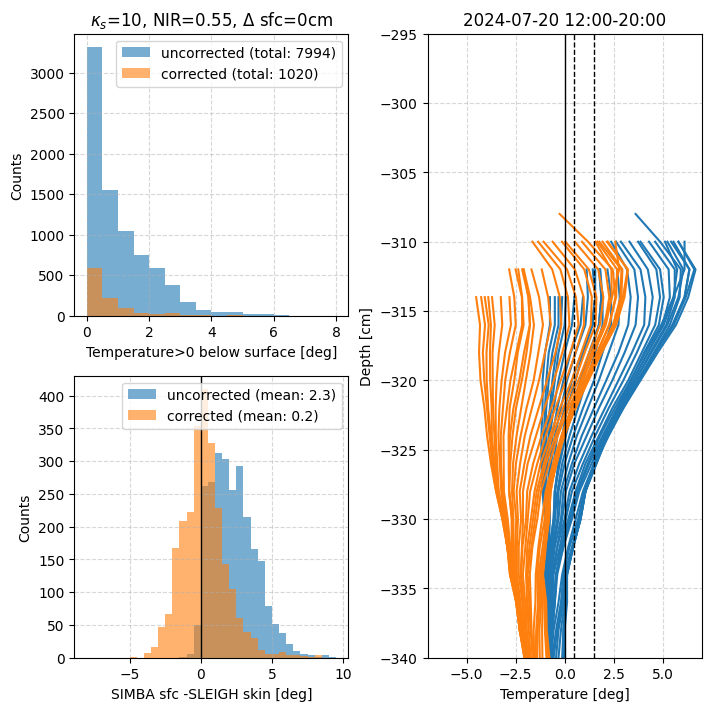

0.21717844903469086 1.6885567071442764
3.7767038345336914 4.5860301171433235
5.41530704498291 3.285658564110832
7.368351697921753 3.6645838022520287


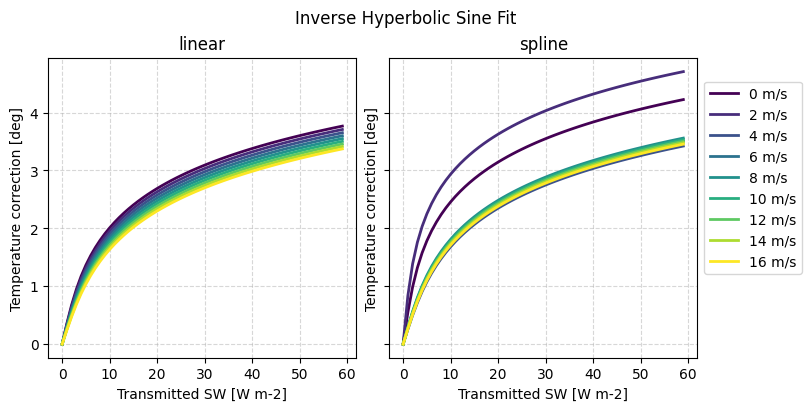

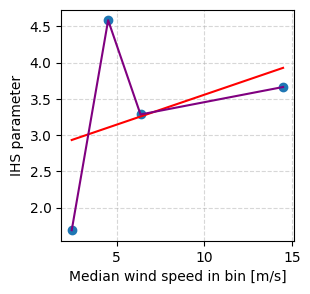

{'slope': np.float64(0.08260740581328821), 'intercept': np.float64(2.731388785224586), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f044aa30>}
{'slope': np.float64(0.08260740581328821), 'intercept': np.float64(2.731388785224586), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f044aa30>}


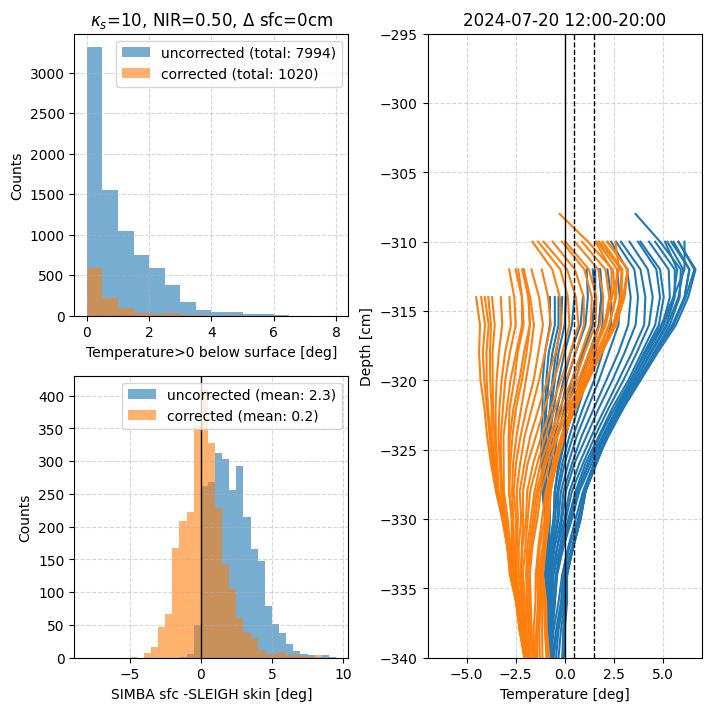

0.21717844903469086 1.8574164824943988
3.7767038345336914 5.044631084764221
5.41530704498291 3.6142243911431393
7.368351697921753 4.031040671162967


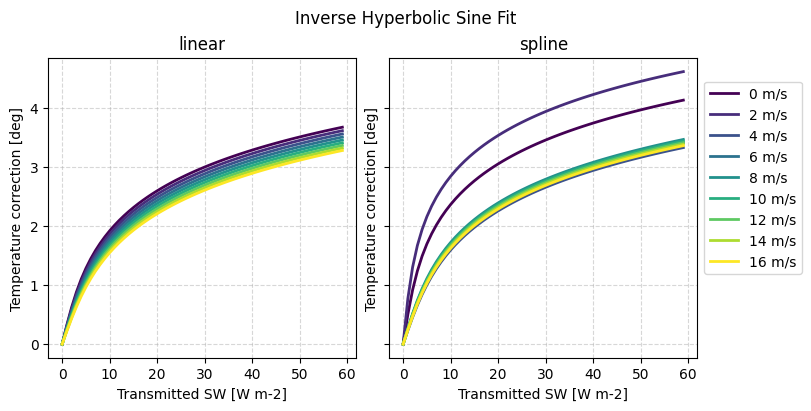

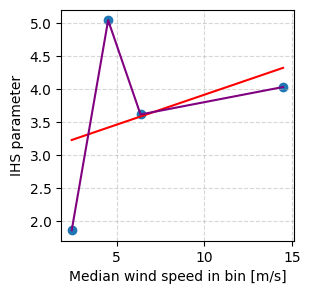

{'slope': np.float64(0.0908678478664874), 'intercept': np.float64(3.004529870998834), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f9fae670>}
{'slope': np.float64(0.0908678478664874), 'intercept': np.float64(3.004529870998834), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f9fae670>}


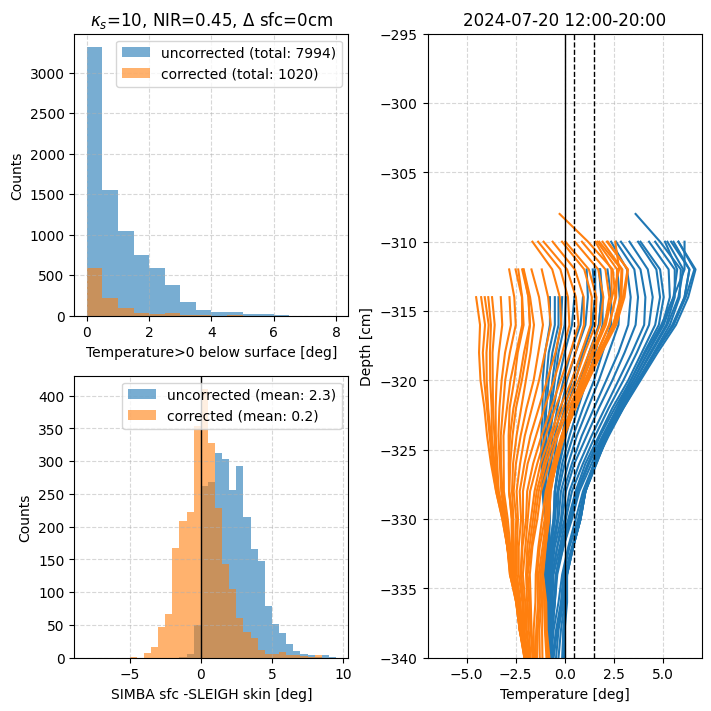

0.21717844903469086 2.02627296714287
3.7767038345336914 5.503231492136247
5.41530704498291 3.9427902058964084
7.368351697921753 4.397497015827817


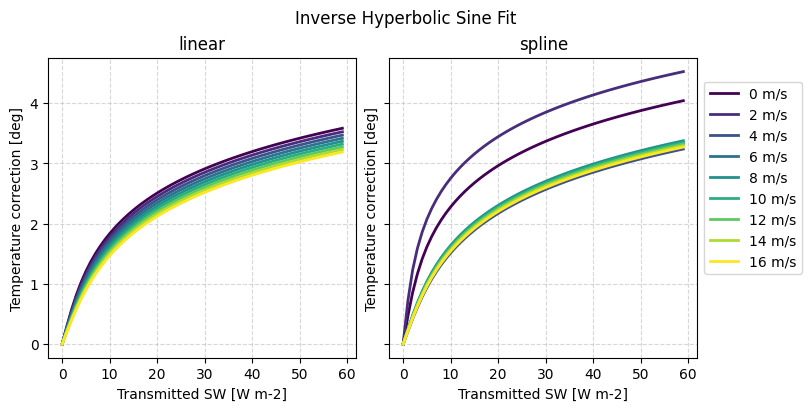

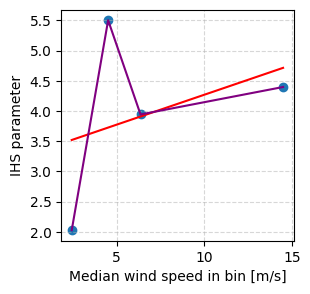

{'slope': np.float64(0.09912843691438011), 'intercept': np.float64(3.277668837050707), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75efb02550>}
{'slope': np.float64(0.09912843691438011), 'intercept': np.float64(3.277668837050707), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75efb02550>}


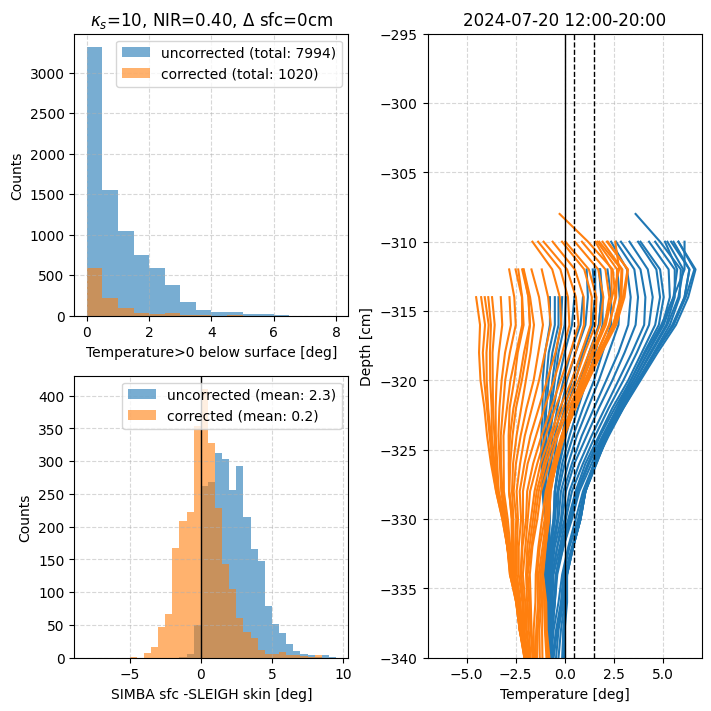

0.21717844903469086 1.796405656724081
3.7767038345336914 3.634235263147083
5.41530704498291 2.5068011064497613
7.368351697921753 2.935990531255369


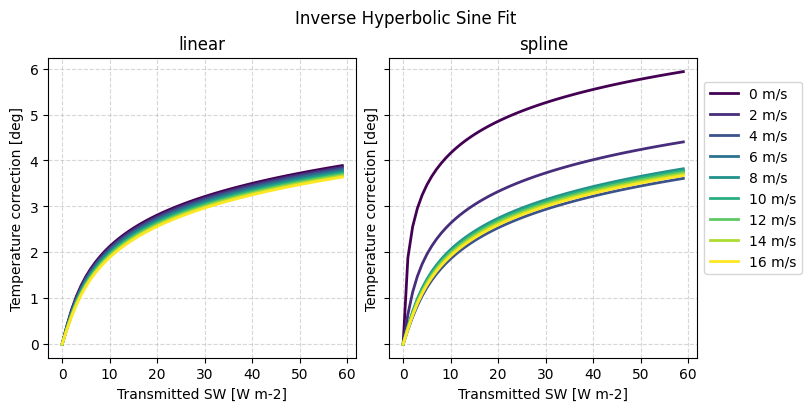

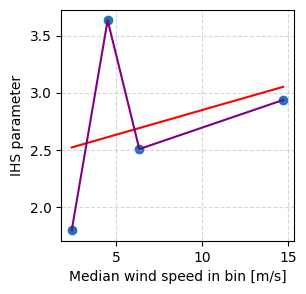

{'slope': np.float64(0.043051113742885255), 'intercept': np.float64(2.4174744767085494), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f92e5760>}
{'slope': np.float64(0.043051113742885255), 'intercept': np.float64(2.4174744767085494), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f92e5760>}


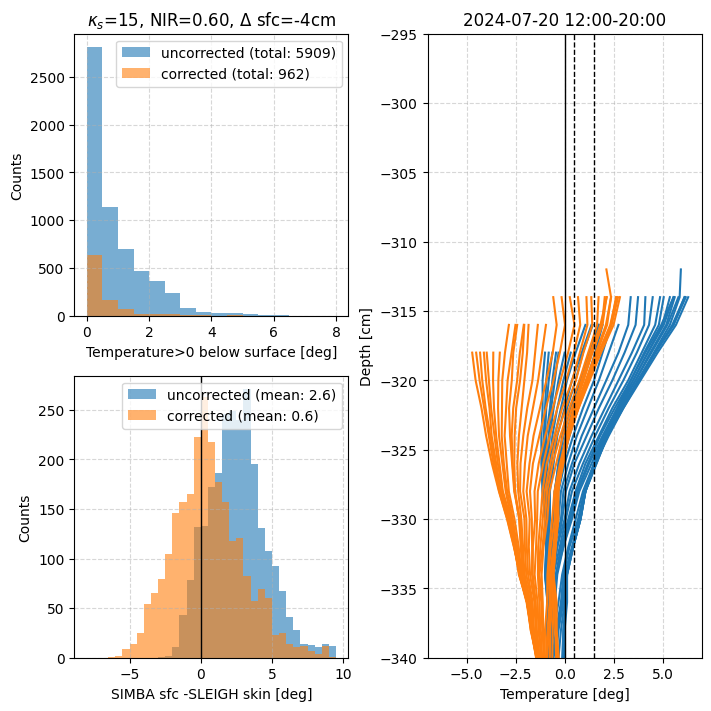

0.21717844903469086 2.020957683051602
3.7767038345336914 4.088508083843849
5.41530704498291 2.820151217809127
7.368351697921753 3.3029869038950306


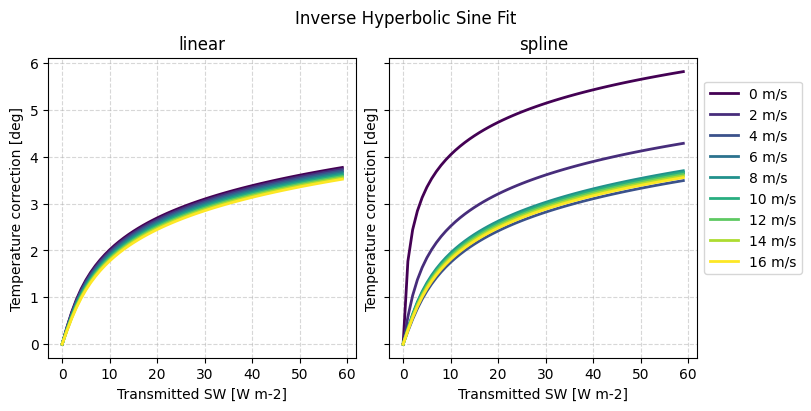

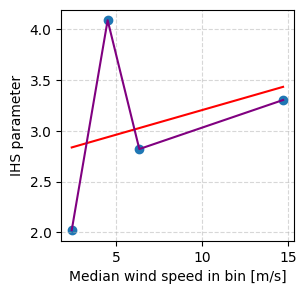

{'slope': np.float64(0.04843240581456911), 'intercept': np.float64(2.719657530582029), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eefc3fd0>}
{'slope': np.float64(0.04843240581456911), 'intercept': np.float64(2.719657530582029), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eefc3fd0>}


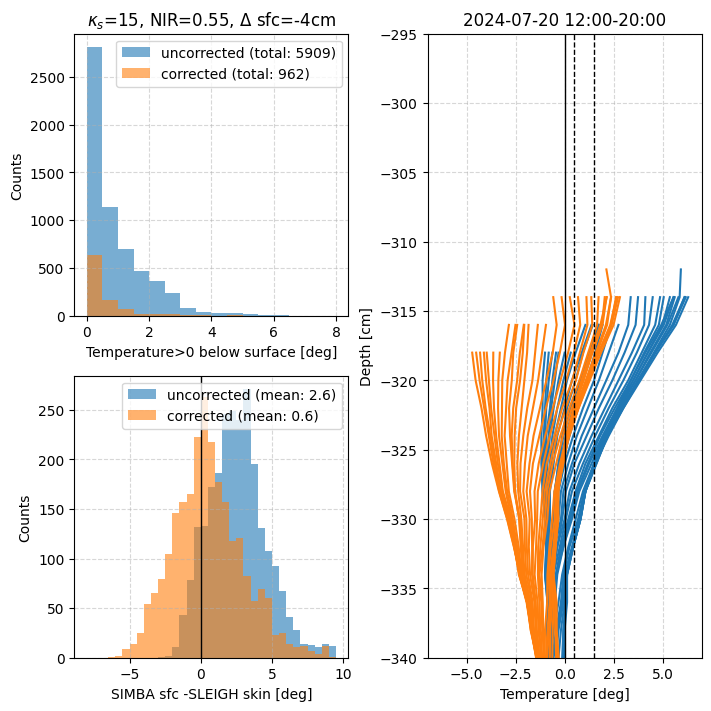

0.21717844903469086 2.2455102776549136
3.7767038345336914 4.542778830598665
5.41530704498291 3.133501308425088
7.368351697921753 3.669982223509552


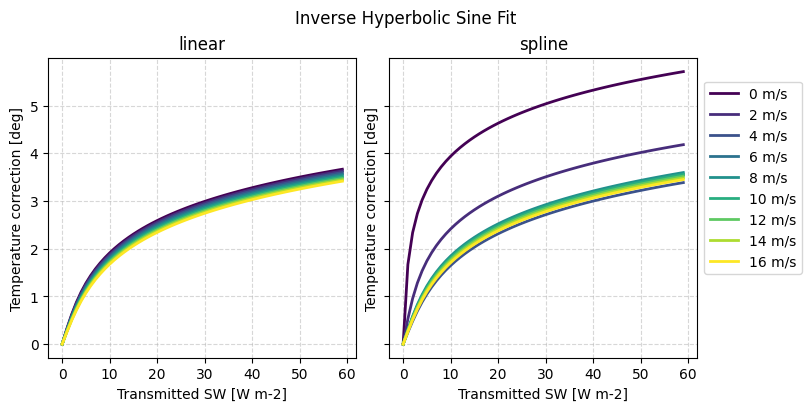

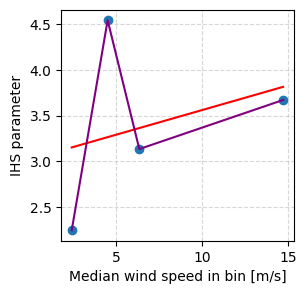

{'slope': np.float64(0.0538136342953151), 'intercept': np.float64(3.021840384033054), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eeab2c10>}
{'slope': np.float64(0.0538136342953151), 'intercept': np.float64(3.021840384033054), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eeab2c10>}


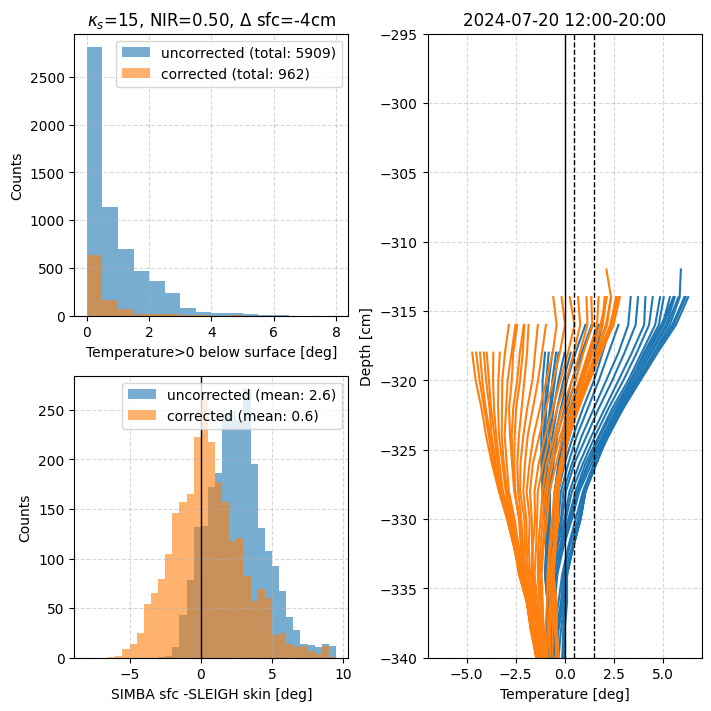

0.21717844903469086 2.4700631202677865
3.7767038345336914 4.9970946172019834
5.41530704498291 3.4468513806370185
7.368351697921753 4.036976420215131


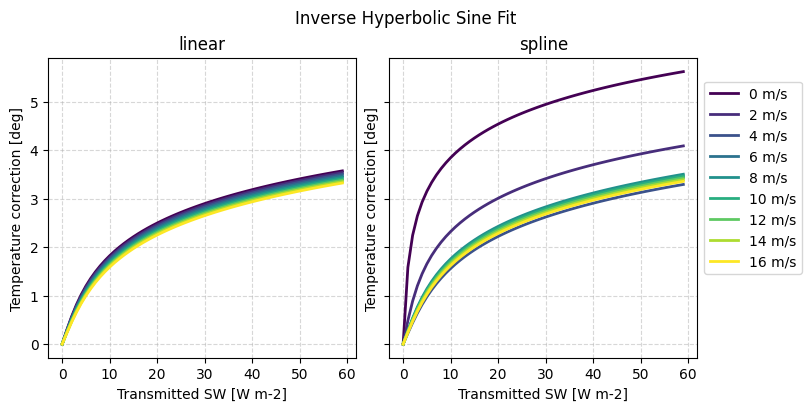

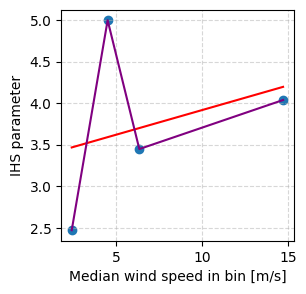

{'slope': np.float64(0.059193465831385864), 'intercept': np.float64(3.324044037348147), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ee543c10>}
{'slope': np.float64(0.059193465831385864), 'intercept': np.float64(3.324044037348147), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ee543c10>}


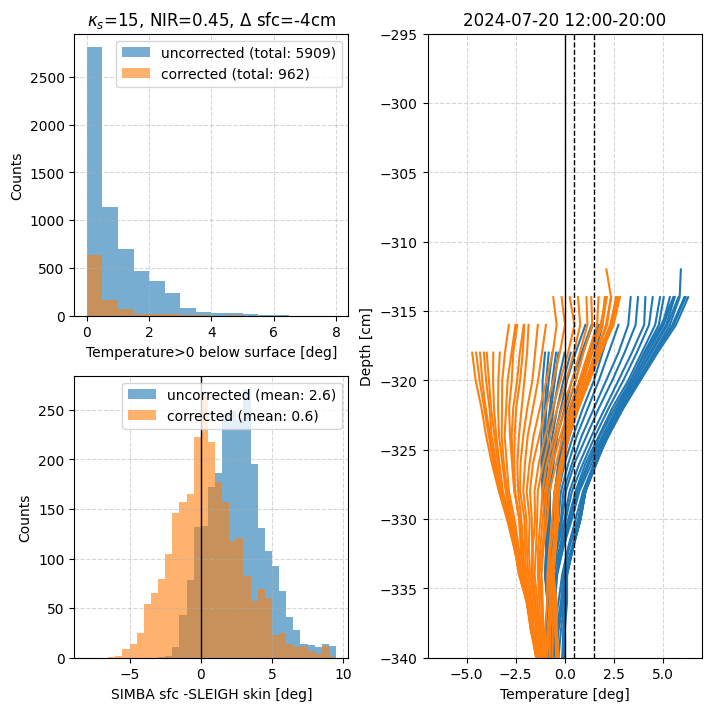

0.21717844903469086 2.6946157884948727
3.7767038345336914 5.451374688924143
5.41530704498291 3.760201420555228
7.368351697921753 4.4039692838128355


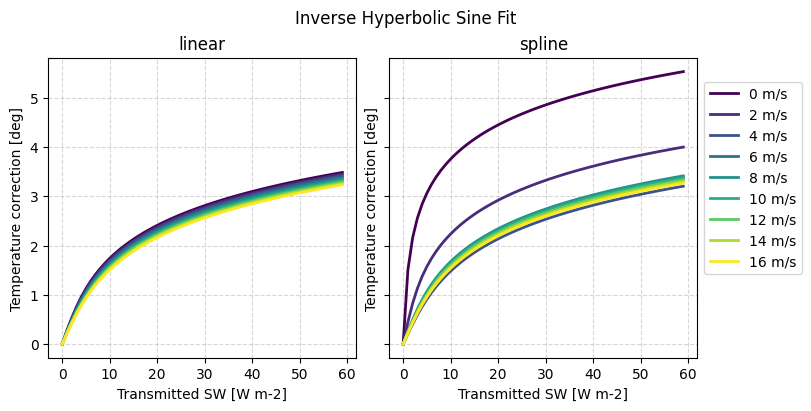

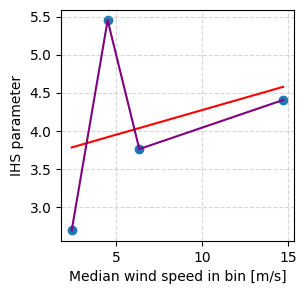

{'slope': np.float64(0.06457420770070725), 'intercept': np.float64(3.626232014689098), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ee0ad2e0>}
{'slope': np.float64(0.06457420770070725), 'intercept': np.float64(3.626232014689098), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ee0ad2e0>}


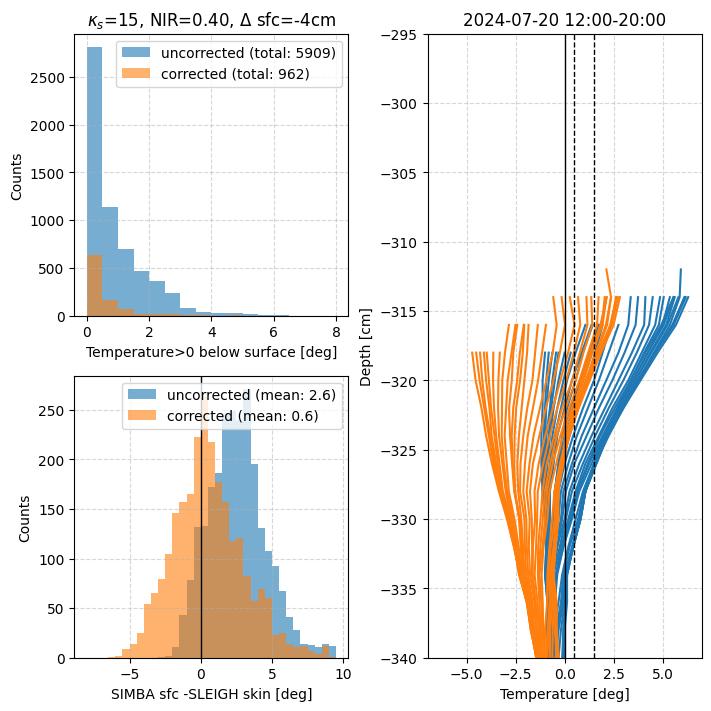

0.21717844903469086 1.1204576707529557
3.7767038345336914 3.3121435214379535
5.41530704498291 1.9955317835326312
7.368351697921753 2.2795117156363824


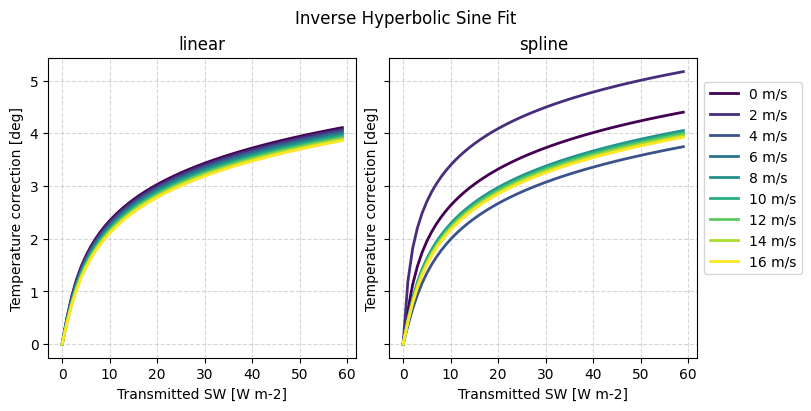

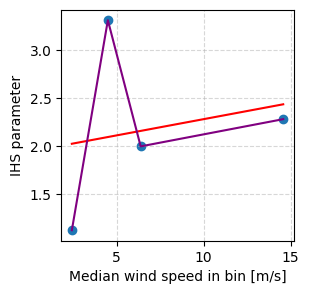

{'slope': np.float64(0.03390222328665263), 'intercept': np.float64(1.940692014472749), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75edbaba30>}
{'slope': np.float64(0.03390222328665263), 'intercept': np.float64(1.940692014472749), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75edbaba30>}


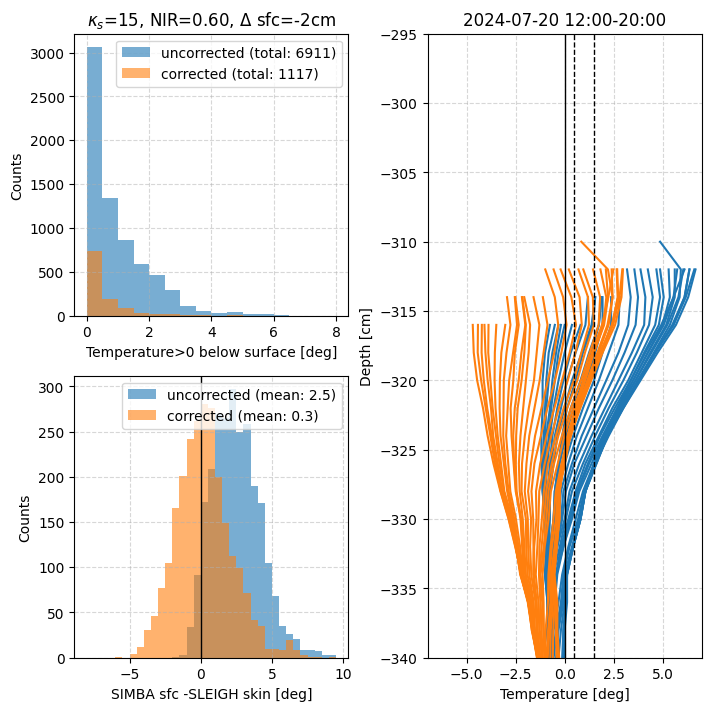

0.21717844903469086 1.260516181191851
3.7767038345336914 3.7261568826143265
5.41530704498291 2.2449741500311537
7.368351697921753 2.5644494386840706


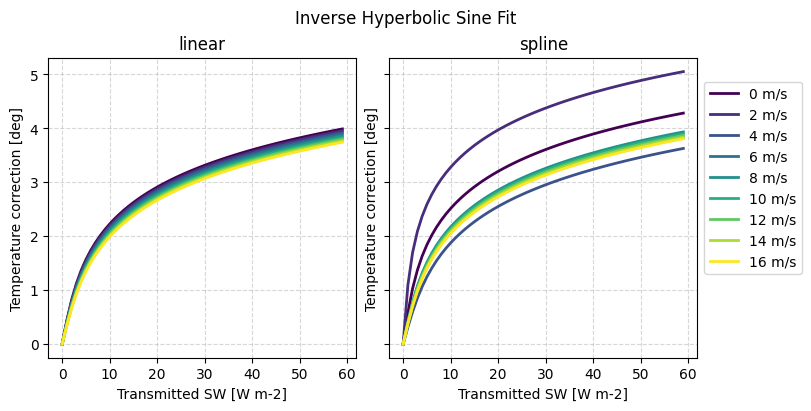

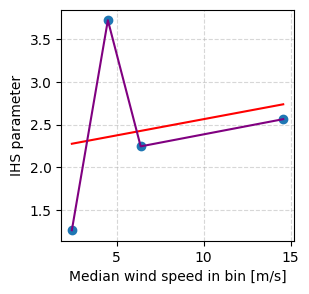

{'slope': np.float64(0.038139947580615), 'intercept': np.float64(2.1832779835513185), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75fecf81f0>}
{'slope': np.float64(0.038139947580615), 'intercept': np.float64(2.1832779835513185), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75fecf81f0>}


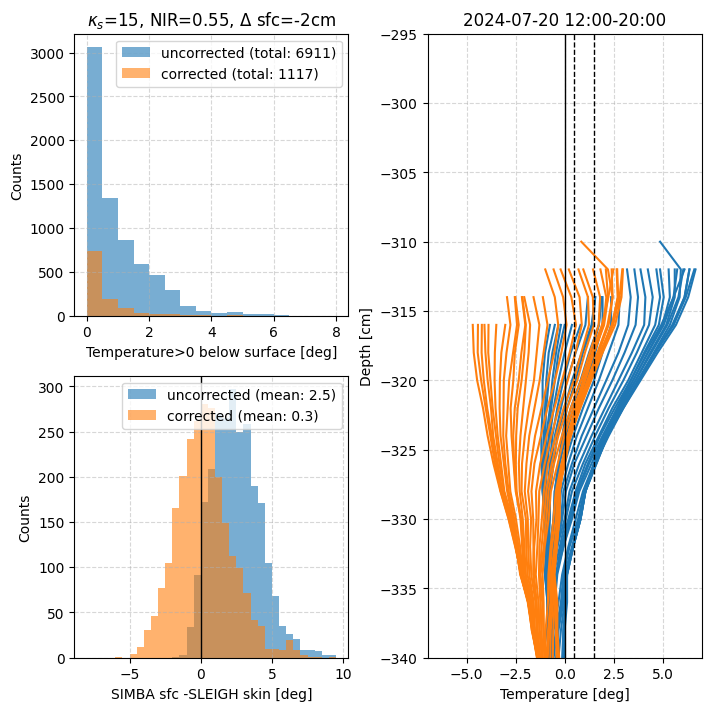

0.21717844903469086 1.4005742926657077
3.7767038345336914 4.140168771172479
5.41530704498291 2.494415694836801
7.368351697921753 2.8493866241093104


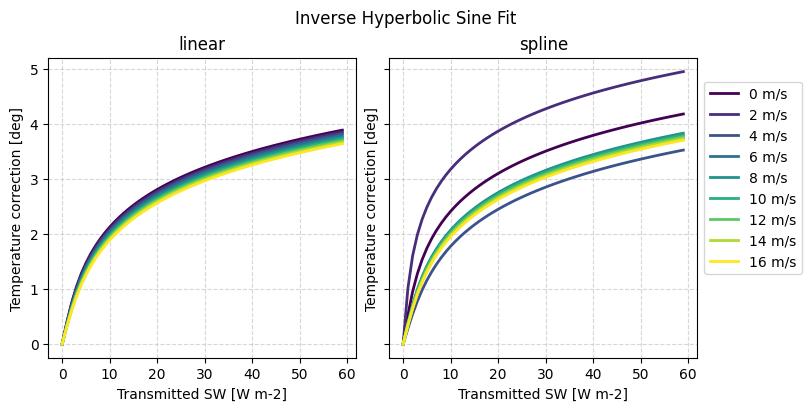

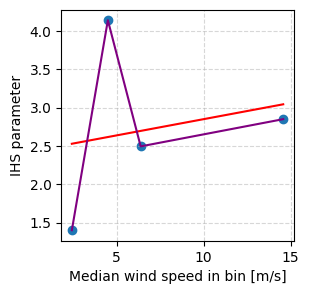

{'slope': np.float64(0.04237769365472766), 'intercept': np.float64(2.425862993148565), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ed0d8e20>}
{'slope': np.float64(0.04237769365472766), 'intercept': np.float64(2.425862993148565), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ed0d8e20>}


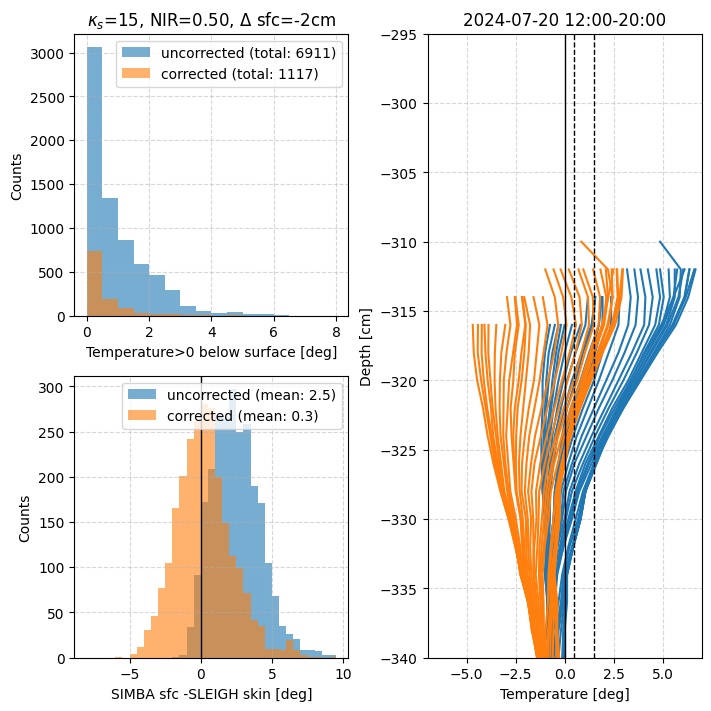

0.21717844903469086 1.5406304093940089
3.7767038345336914 4.554179058795539
5.41530704498291 2.7438572222832756
7.368351697921753 3.134323169363435


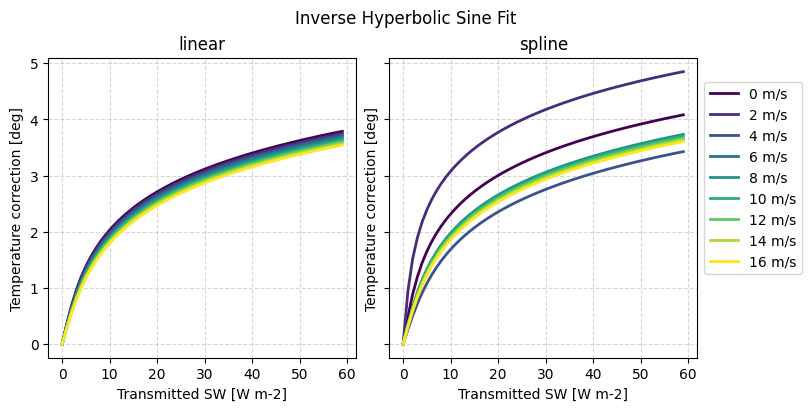

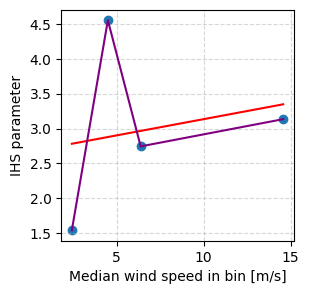

{'slope': np.float64(0.04661553588275791), 'intercept': np.float64(2.6684462694752913), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eca15820>}
{'slope': np.float64(0.04661553588275791), 'intercept': np.float64(2.6684462694752913), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eca15820>}


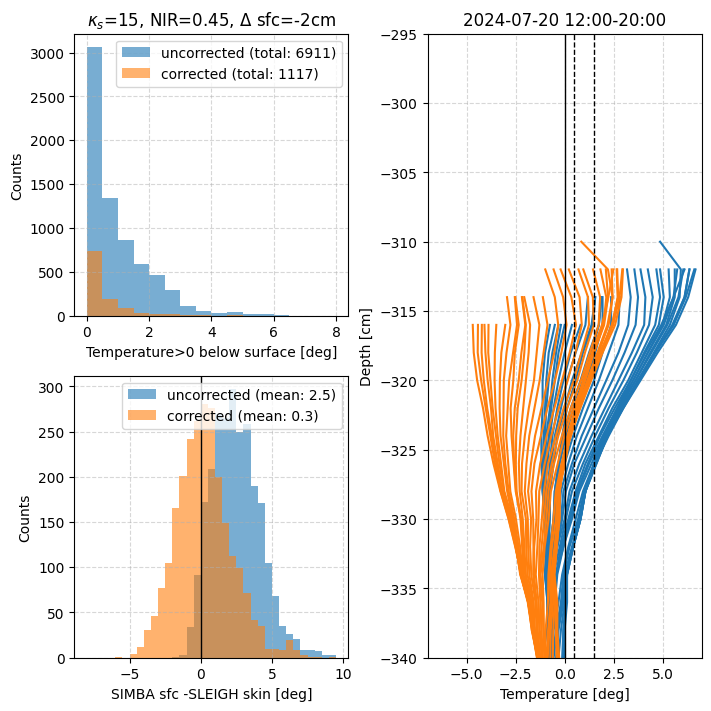

0.21717844903469086 1.680683445546054
3.7767038345336914 4.968187678361069
5.41530704498291 2.9932987283852004
7.368351697921753 3.4192589841910634


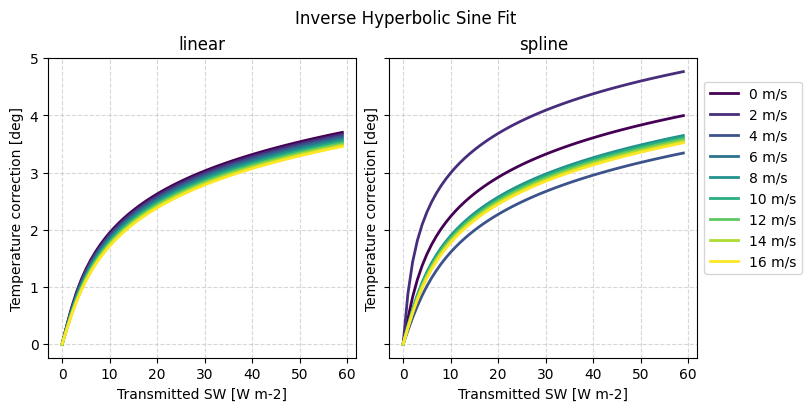

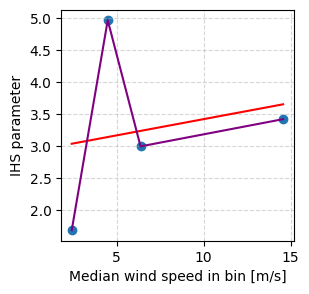

{'slope': np.float64(0.05085352626302477), 'intercept': np.float64(2.911027138426426), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ec784e80>}
{'slope': np.float64(0.05085352626302477), 'intercept': np.float64(2.911027138426426), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ec784e80>}


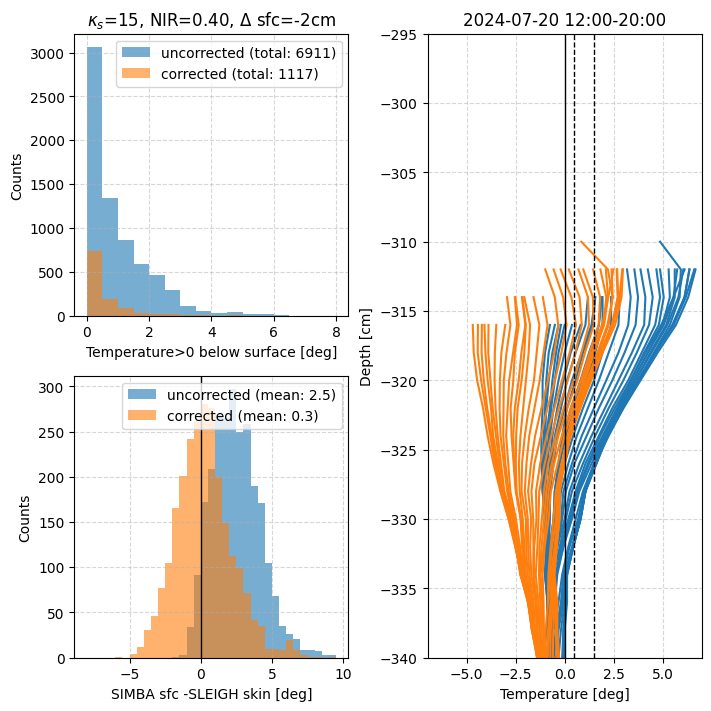

0.21717844903469086 0.7723468365164915
3.7767038345336914 2.892280795947279
5.41530704498291 1.691136864213944
7.368351697921753 1.869370800880489


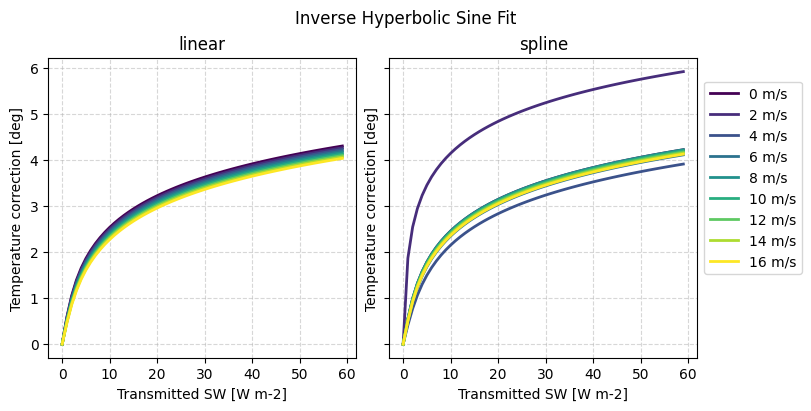

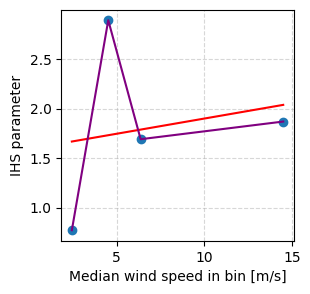

{'slope': np.float64(0.030706815453808833), 'intercept': np.float64(1.5926123525996918), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f37e4820>}
{'slope': np.float64(0.030706815453808833), 'intercept': np.float64(1.5926123525996918), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75f37e4820>}


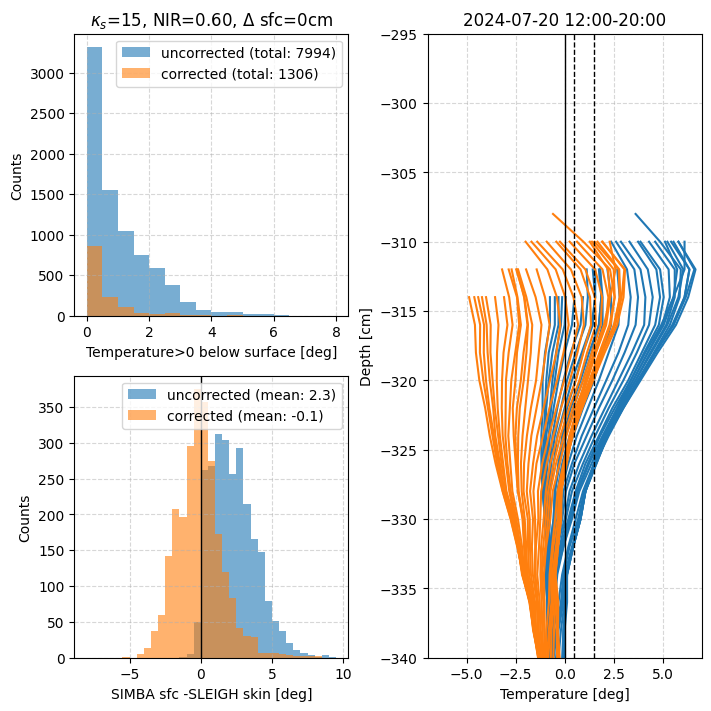

0.21717844903469086 0.8688904317755689
3.7767038345336914 3.253811545347897
5.41530704498291 1.9025286648146835
7.368351697921753 2.103041228167496


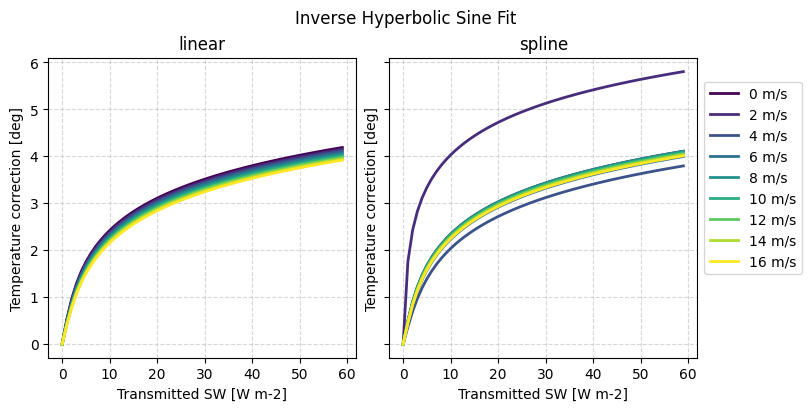

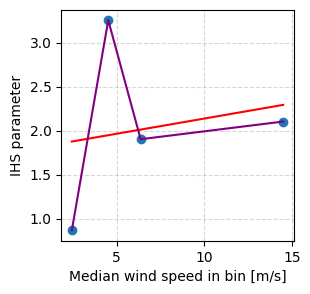

{'slope': np.float64(0.03454520018151238), 'intercept': np.float64(1.7916873335540437), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ebb16580>}
{'slope': np.float64(0.03454520018151238), 'intercept': np.float64(1.7916873335540437), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ebb16580>}


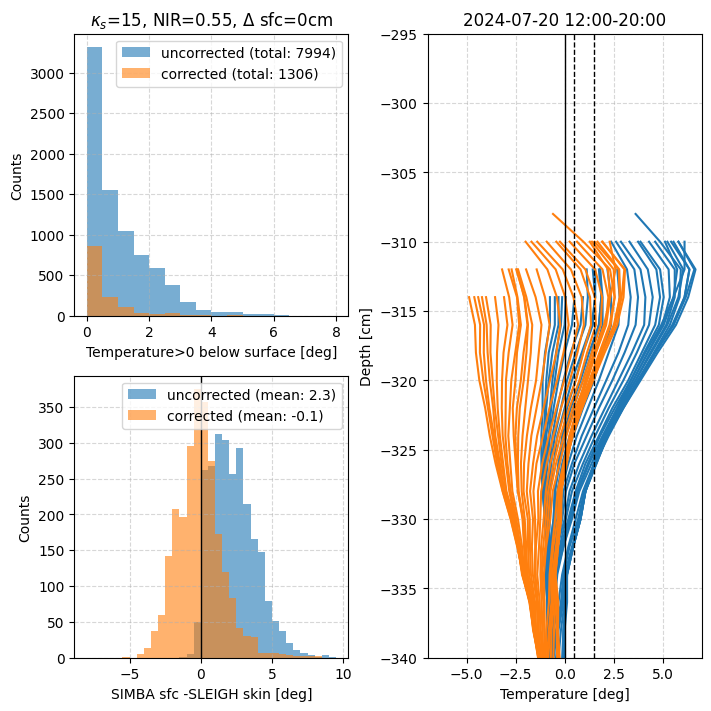

0.21717844903469086 0.9654330864532394
3.7767038345336914 3.615340855992031
5.41530704498291 2.1139202370708903
7.368351697921753 2.3367111985073854


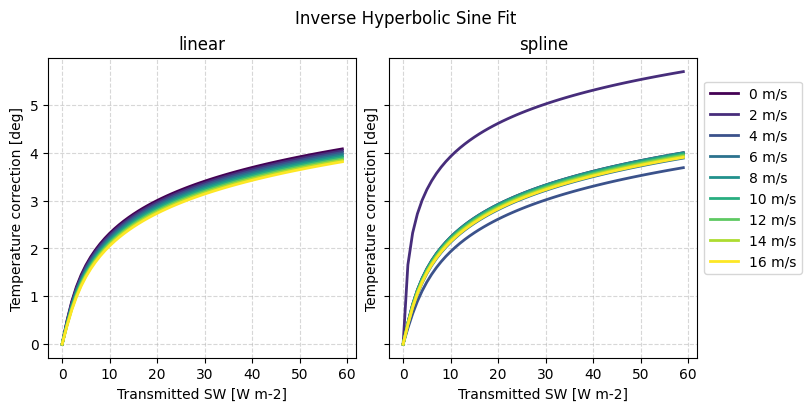

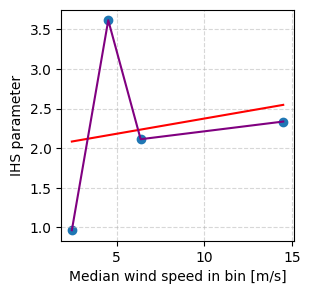

{'slope': np.float64(0.038383638100680864), 'intercept': np.float64(1.9907611782214991), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eb842d00>}
{'slope': np.float64(0.038383638100680864), 'intercept': np.float64(1.9907611782214991), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eb842d00>}


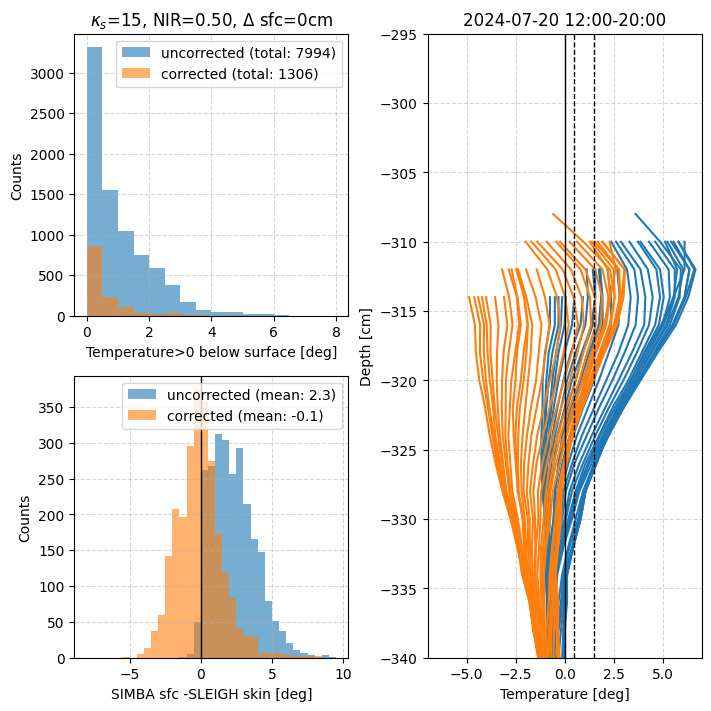

0.21717844903469086 1.0619768792789548
3.7767038345336914 3.976868640522294
5.41530704498291 2.3253115012054084
7.368351697921753 2.5703807149416145


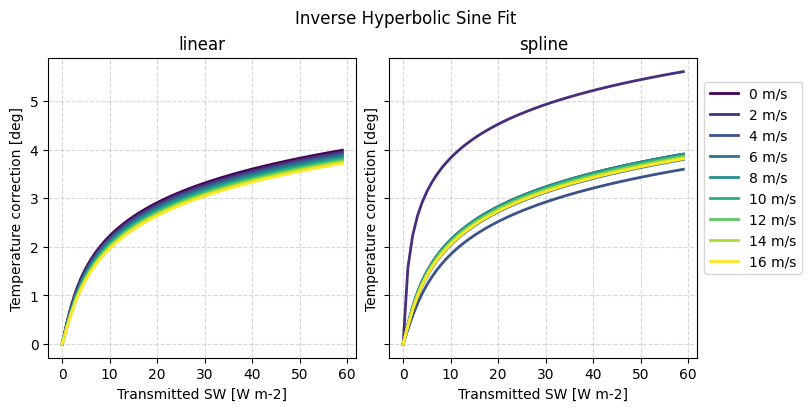

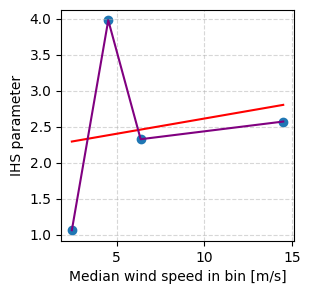

{'slope': np.float64(0.042222020218953785), 'intercept': np.float64(2.1898351236777334), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eb017490>}
{'slope': np.float64(0.042222020218953785), 'intercept': np.float64(2.1898351236777334), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eb017490>}


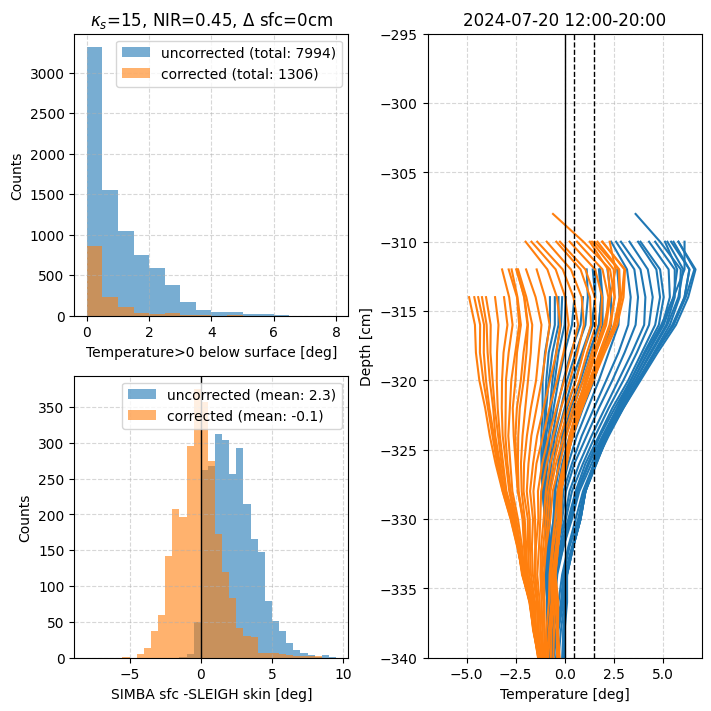

0.21717844903469086 1.158519943818788
3.7767038345336914 4.338394855643575
5.41530704498291 2.5367056343707097
7.368351697921753 2.8040496582598906


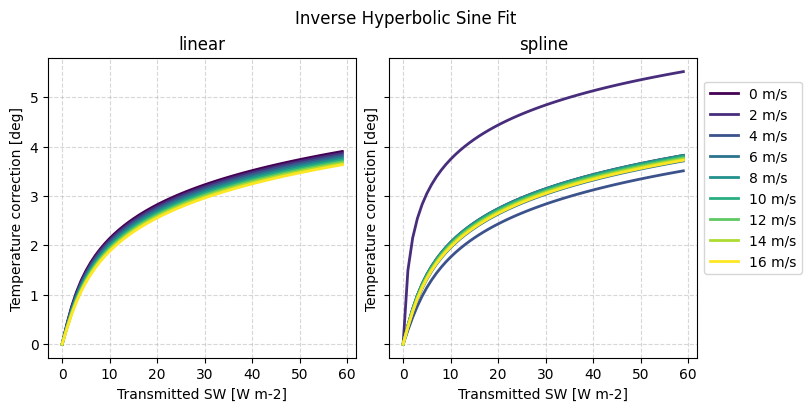

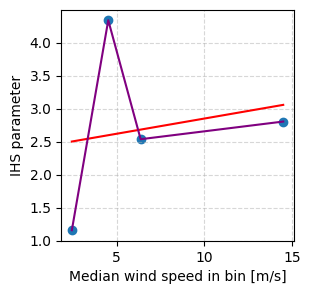

{'slope': np.float64(0.04606041549041461), 'intercept': np.float64(2.3889089771633167), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eaf4fa60>}
{'slope': np.float64(0.04606041549041461), 'intercept': np.float64(2.3889089771633167), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eaf4fa60>}


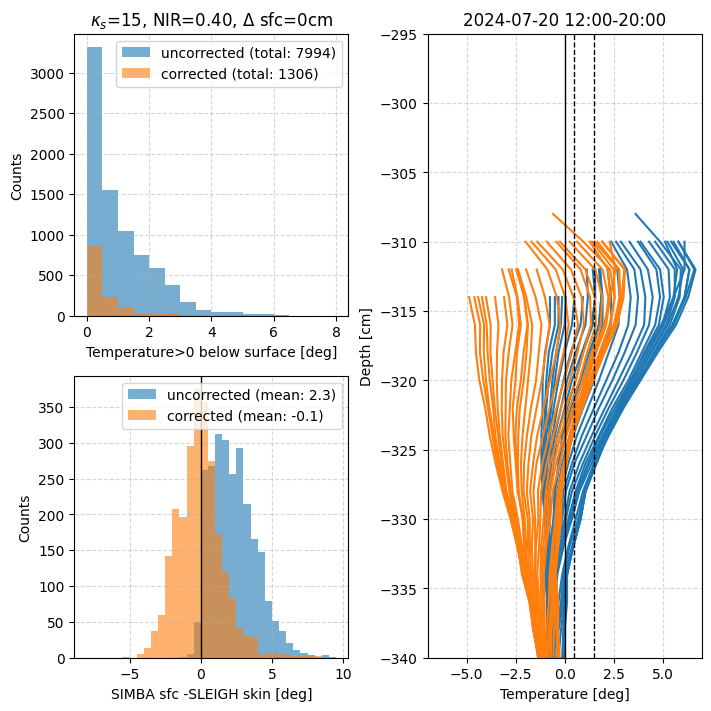

0.21717844903469086 1.065374364701053
3.7767038345336914 2.845708349971498
5.41530704498291 1.8598091699289974
7.368351697921753 1.915831637242801


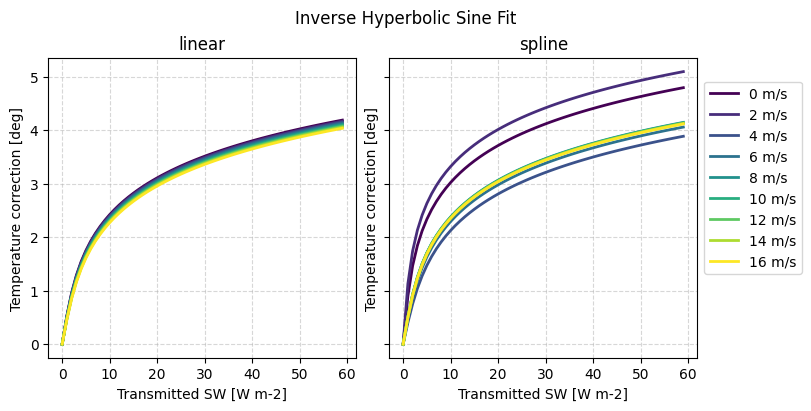

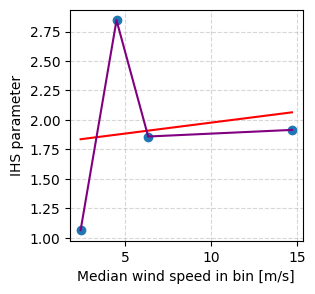

{'slope': np.float64(0.018508013815775767), 'intercept': np.float64(1.7923286174933226), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea9e87f0>}
{'slope': np.float64(0.018508013815775767), 'intercept': np.float64(1.7923286174933226), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea9e87f0>}


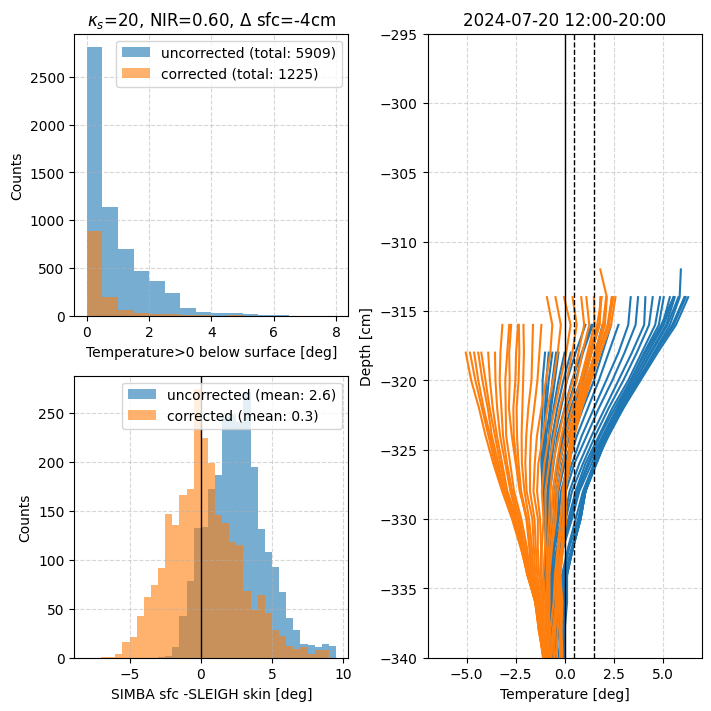

0.21717844903469086 1.1985468555297927
3.7767038345336914 3.2014084083208556
5.41530704498291 2.0922850867357585
7.368351697921753 2.1553078163689414


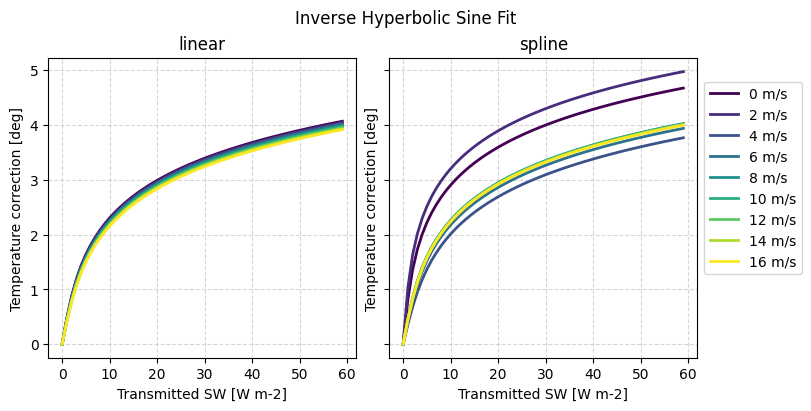

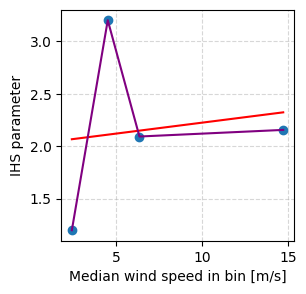

{'slope': np.float64(0.020821620082941167), 'intercept': np.float64(2.016365015270077), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea168be0>}
{'slope': np.float64(0.020821620082941167), 'intercept': np.float64(2.016365015270077), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea168be0>}


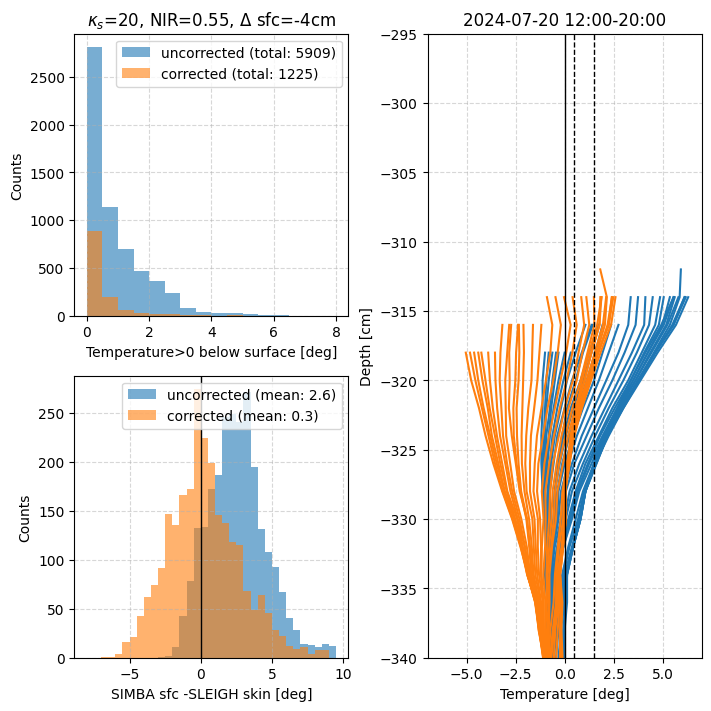

0.21717844903469086 1.3317188091098051
3.7767038345336914 3.5571726814795173
5.41530704498291 2.324760869976118
7.368351697921753 2.3947827998946467


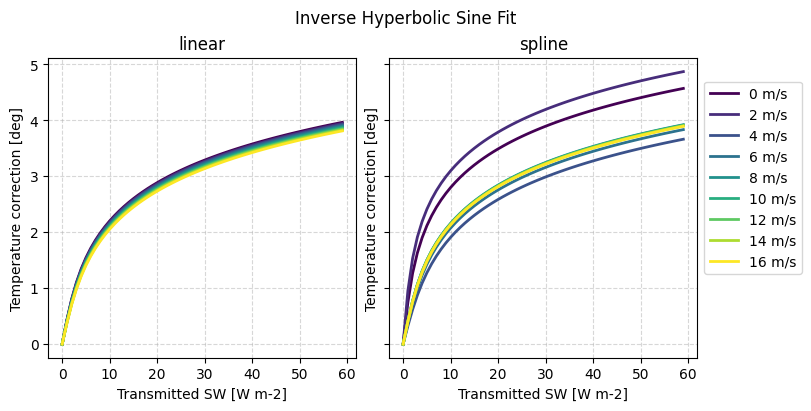

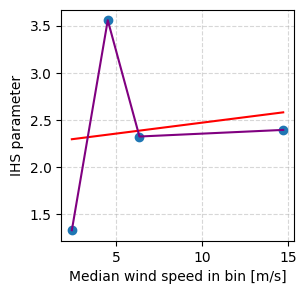

{'slope': np.float64(0.02313331804867475), 'intercept': np.float64(2.2404303372386507), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e9ea0640>}
{'slope': np.float64(0.02313331804867475), 'intercept': np.float64(2.2404303372386507), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e9ea0640>}


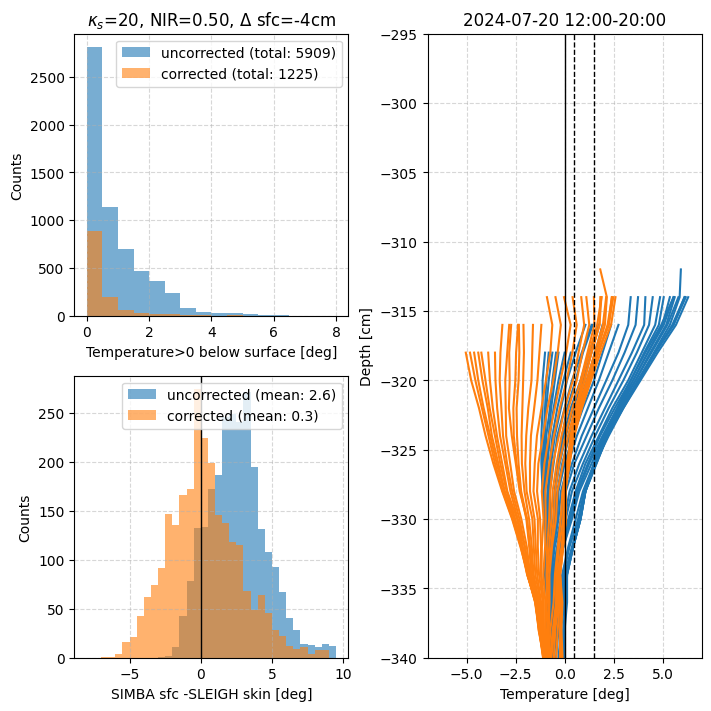

0.21717844903469086 1.4648900710895594
3.7767038345336914 3.9128870401298452
5.41530704498291 2.5572364976378754
7.368351697921753 2.634256472656723


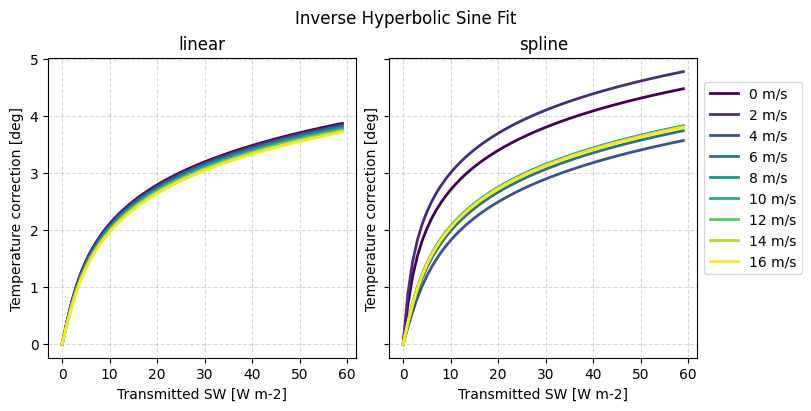

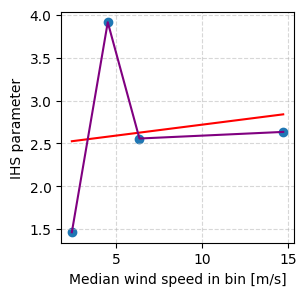

{'slope': np.float64(0.02544636142846477), 'intercept': np.float64(2.464473238013532), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e99a4940>}
{'slope': np.float64(0.02544636142846477), 'intercept': np.float64(2.464473238013532), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e99a4940>}


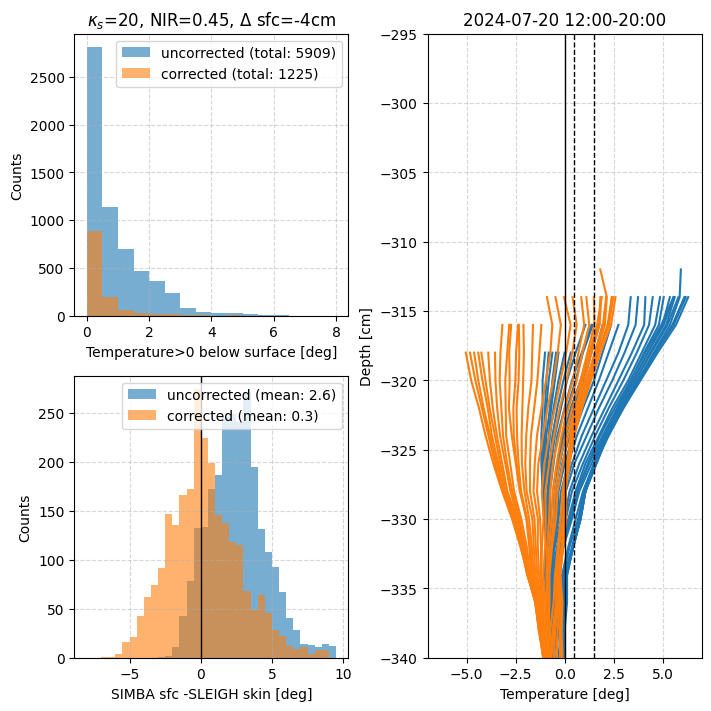

0.21717844903469086 1.5980602458141084
3.7767038345336914 4.26860071110223
5.41530704498291 2.789711948220253
7.368351697921753 2.873728665164418


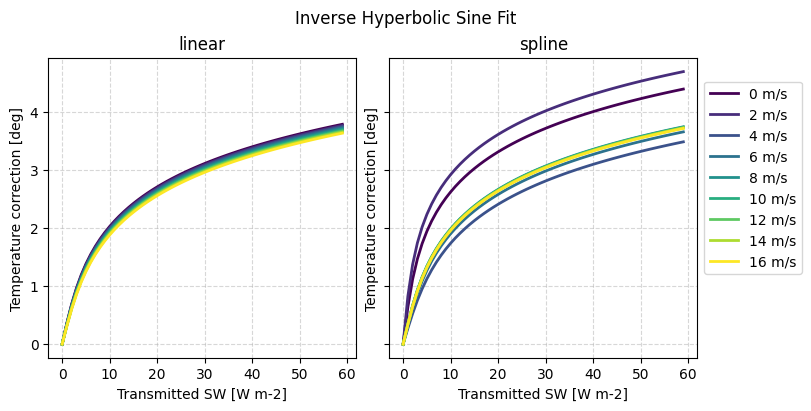

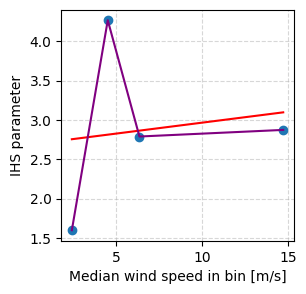

{'slope': np.float64(0.027759351918588776), 'intercept': np.float64(2.688515650366859), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e94c1e80>}
{'slope': np.float64(0.027759351918588776), 'intercept': np.float64(2.688515650366859), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e94c1e80>}


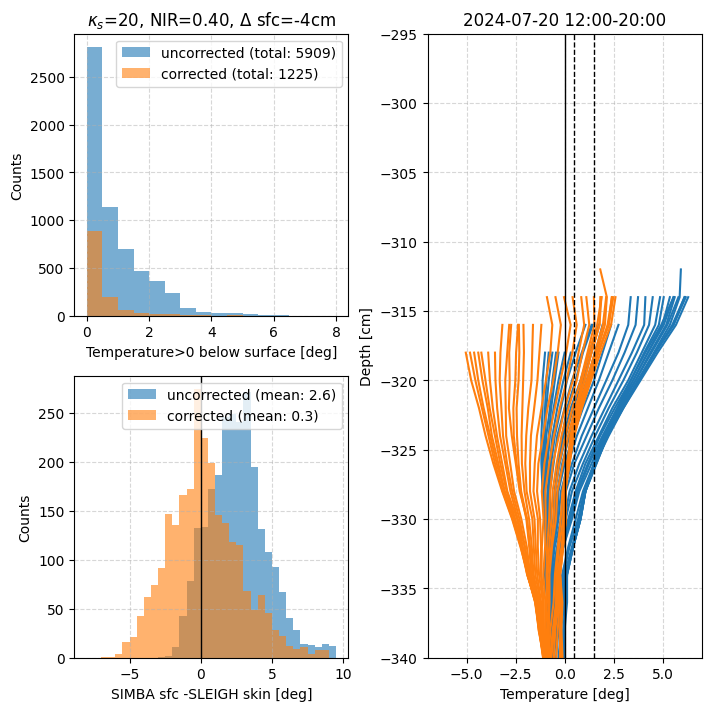

0.21717844903469086 0.6892112961899062
3.7767038345336914 2.632664844600155
5.41530704498291 1.4120591222374743
7.368351697921753 1.6025609219315664


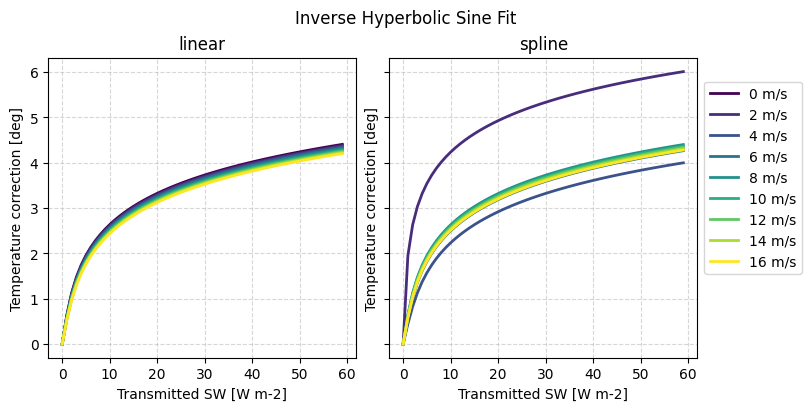

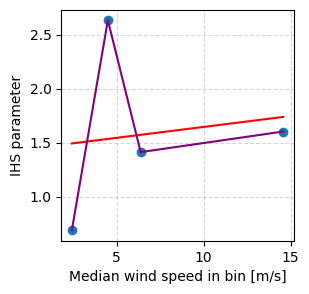

{'slope': np.float64(0.020182680516282834), 'intercept': np.float64(1.443497994525107), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8fefc10>}
{'slope': np.float64(0.020182680516282834), 'intercept': np.float64(1.443497994525107), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8fefc10>}


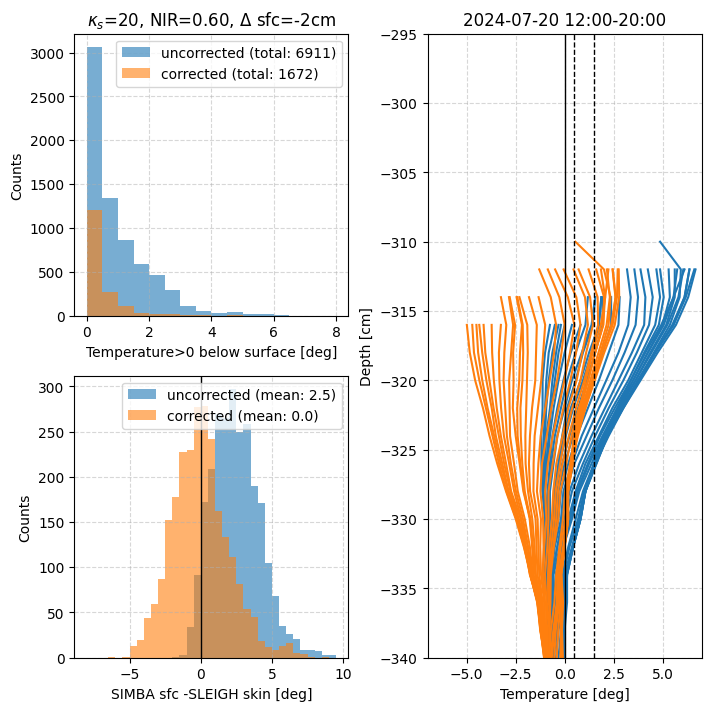

0.21717844903469086 0.7753625652824107
3.7767038345336914 2.961735813778378
5.41530704498291 1.5885653424653041
7.368351697921753 1.8028772532204524


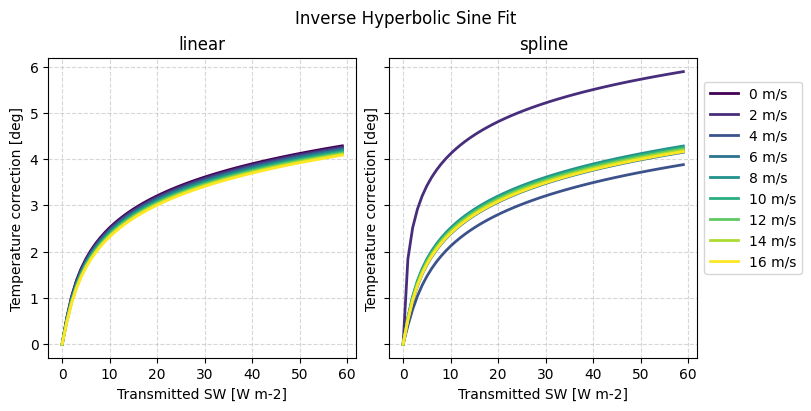

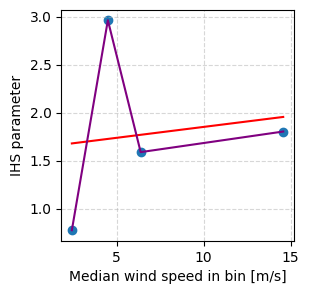

{'slope': np.float64(0.02270554597100814), 'intercept': np.float64(1.6239307237591294), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8c0daf0>}
{'slope': np.float64(0.02270554597100814), 'intercept': np.float64(1.6239307237591294), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8c0daf0>}


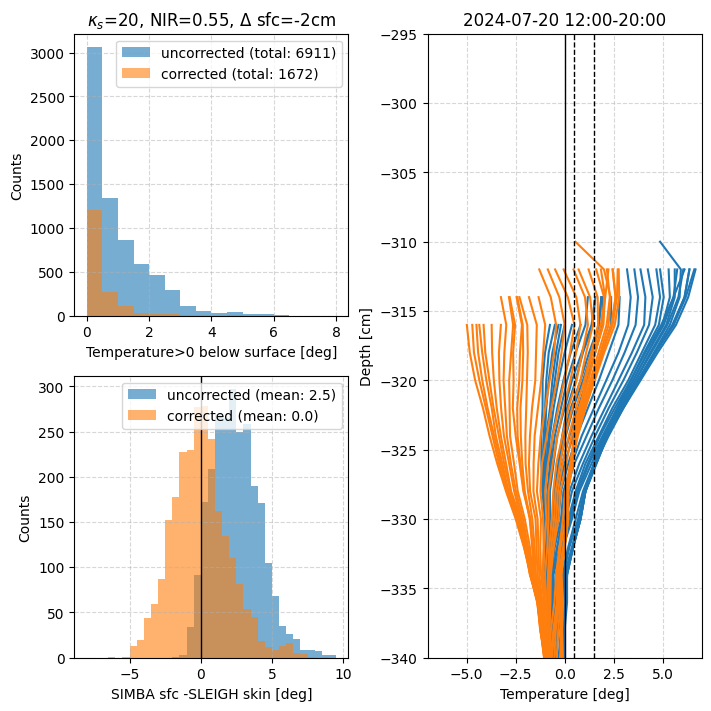

0.21717844903469086 0.8615142429241676
3.7767038345336914 3.290863204752583
5.41530704498291 1.7650707725874812
7.368351697921753 2.0031919926104327


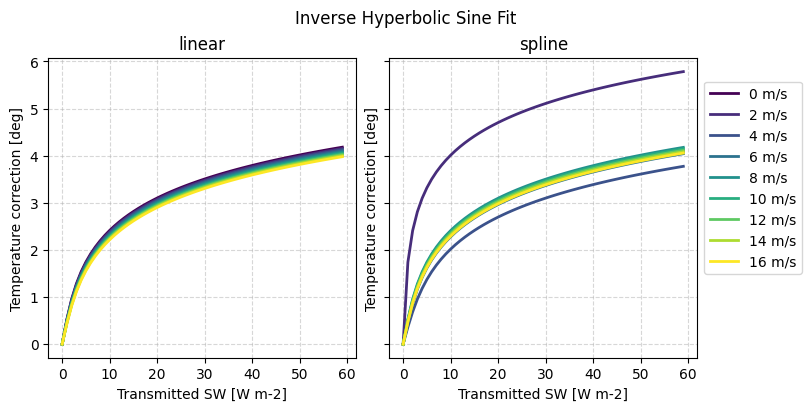

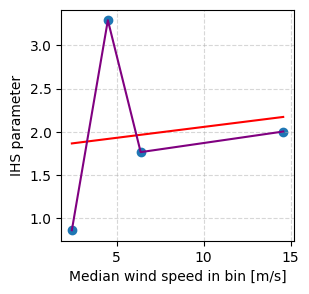

{'slope': np.float64(0.025226609048061257), 'intercept': np.float64(1.8043896234327732), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8549b80>}
{'slope': np.float64(0.025226609048061257), 'intercept': np.float64(1.8043896234327732), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e8549b80>}


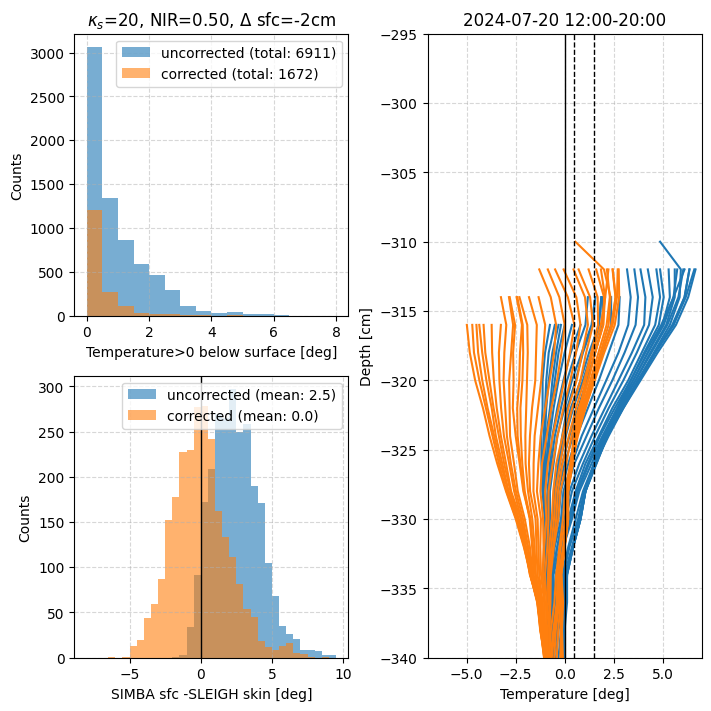

0.21717844903469086 0.9476655129698739
3.7767038345336914 3.6199468251617315
5.41530704498291 1.9415823217128692
7.368351697921753 2.2035049656587633


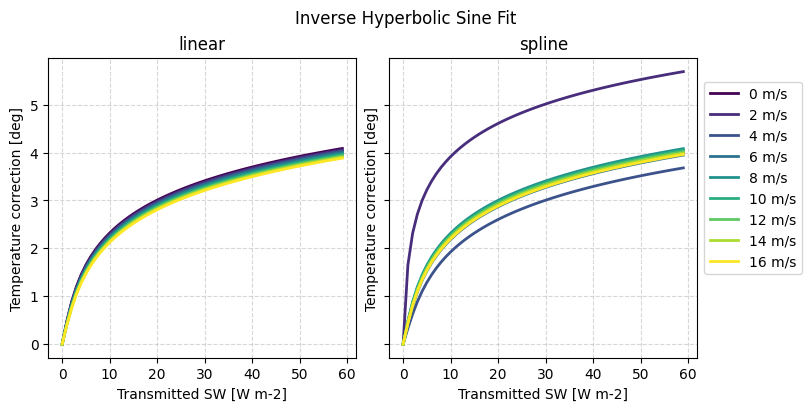

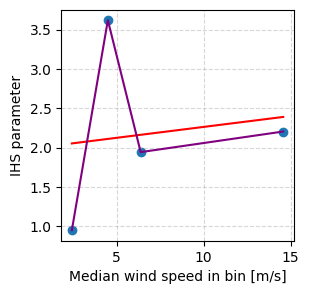

{'slope': np.float64(0.027748768359815136), 'intercept': np.float64(1.9848309285410746), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e80a3670>}
{'slope': np.float64(0.027748768359815136), 'intercept': np.float64(1.9848309285410746), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e80a3670>}


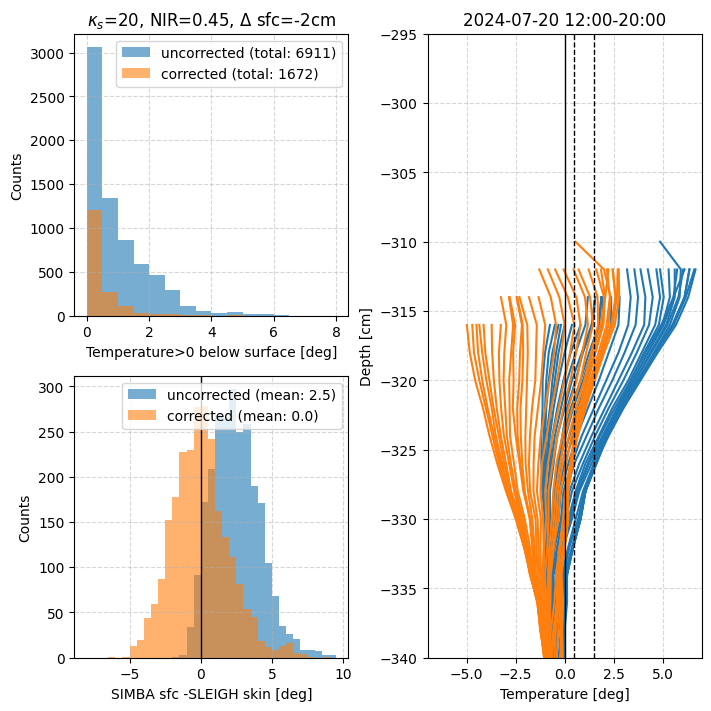

0.21717844903469086 1.0338170695242168
3.7767038345336914 3.949029813164993
5.41530704498291 2.1180896269596627
7.368351697921753 2.4038160244067033


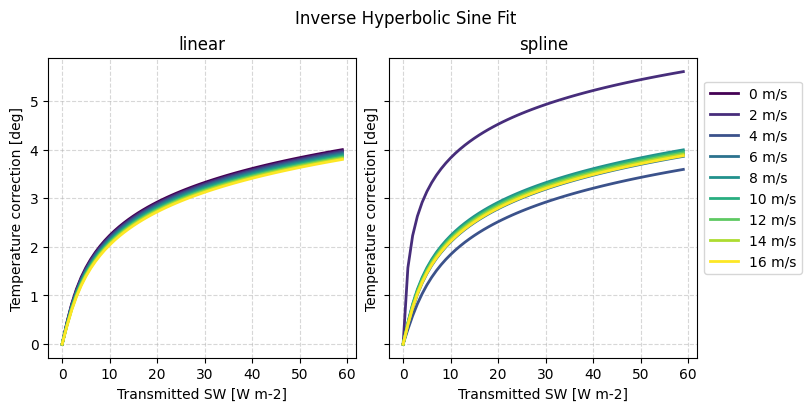

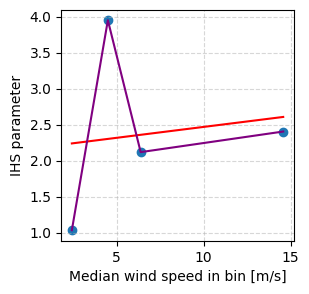

{'slope': np.float64(0.030270788691652985), 'intercept': np.float64(2.1652715759950905), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e78c3c70>}
{'slope': np.float64(0.030270788691652985), 'intercept': np.float64(2.1652715759950905), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e78c3c70>}


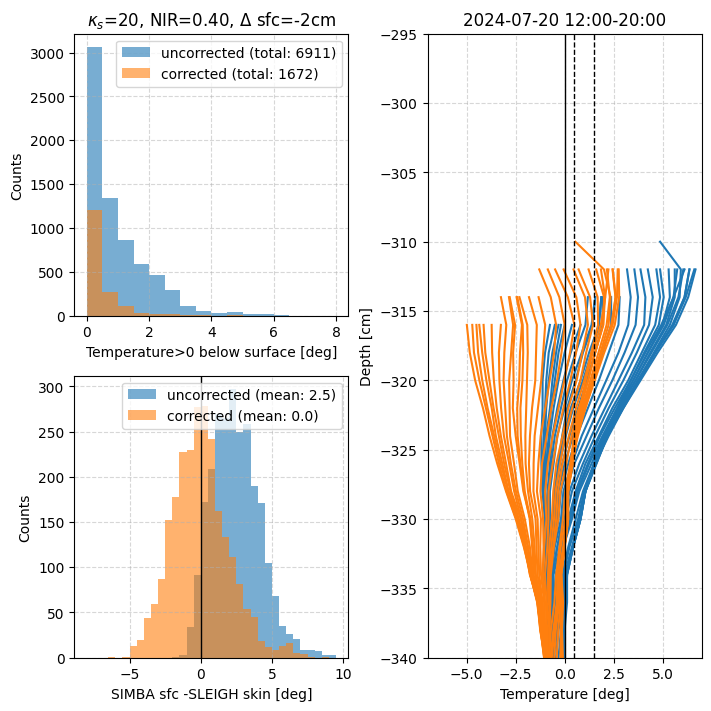

0.21717844903469086 0.4273369055181343
3.7767038345336914 2.0053442370847643
5.41530704498291 1.2377320972227102
7.368351697921753 1.2666804475827735


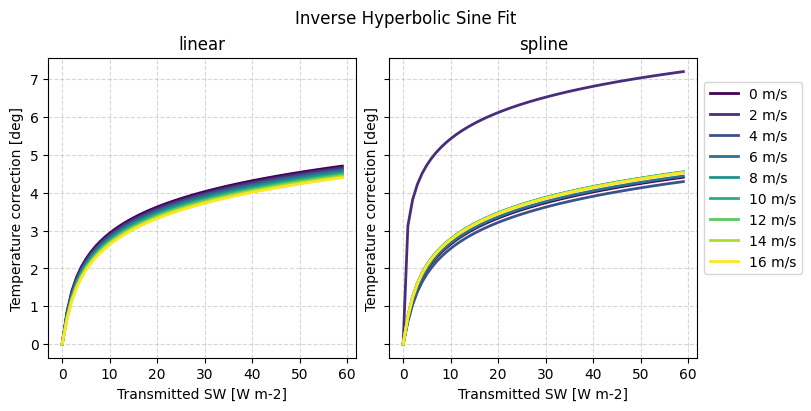

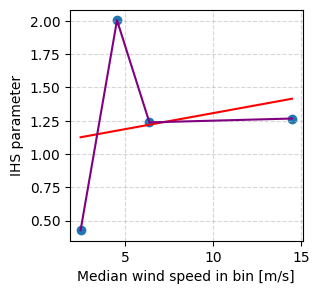

{'slope': np.float64(0.024018826157649973), 'intercept': np.float64(1.067139908984572), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eec80af0>}
{'slope': np.float64(0.024018826157649973), 'intercept': np.float64(1.067139908984572), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75eec80af0>}


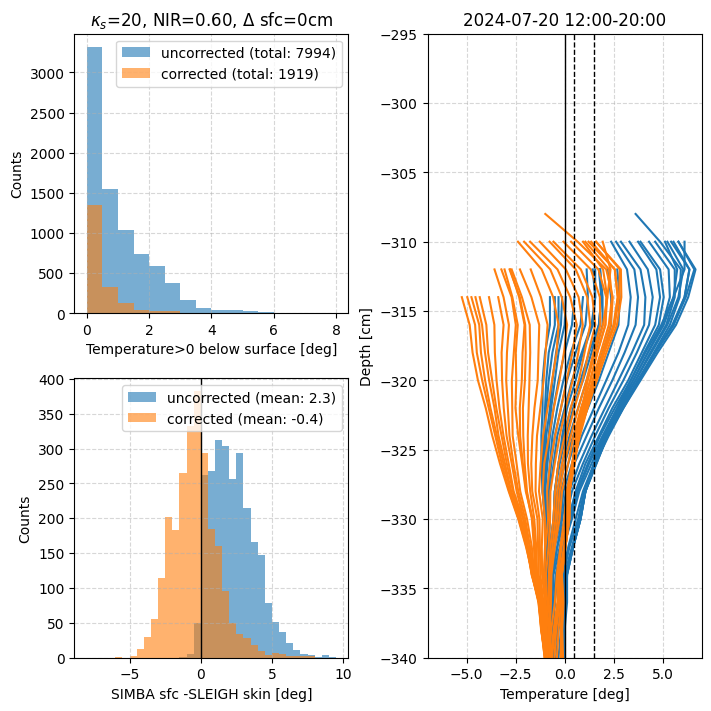

0.21717844903469086 0.4807538500866417
3.7767038345336914 2.25600770552355
5.41530704498291 1.3924459286485447
7.368351697921753 1.4250296903312711


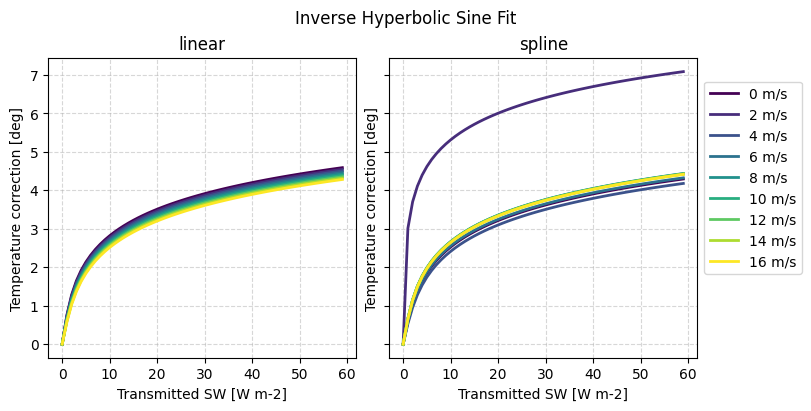

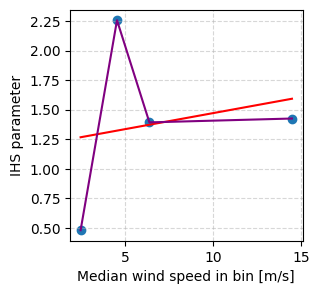

{'slope': np.float64(0.027022621958233517), 'intercept': np.float64(1.2005240539098516), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6ed3490>}
{'slope': np.float64(0.027022621958233517), 'intercept': np.float64(1.2005240539098516), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6ed3490>}


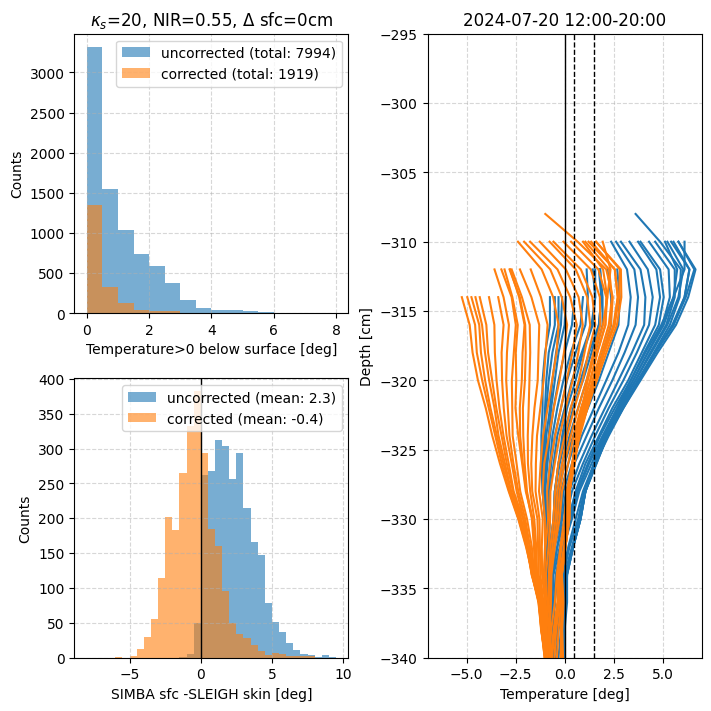

0.21717844903469086 0.5341707864359846
3.7767038345336914 2.506669604224294
5.41530704498291 1.5471580127767506
7.368351697921753 1.5833633860196459


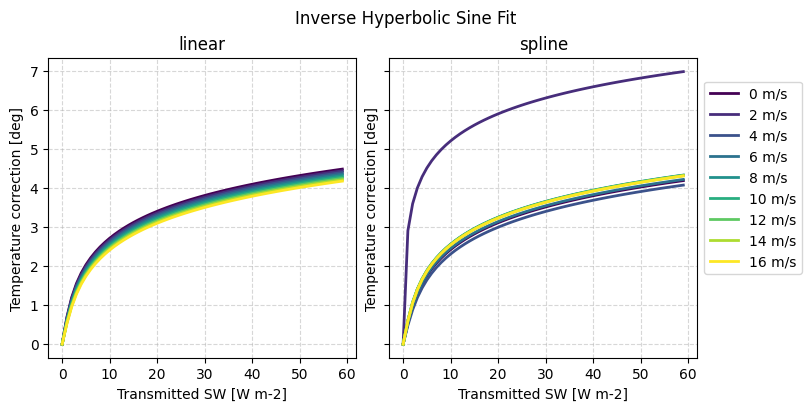

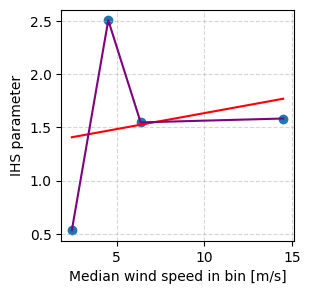

{'slope': np.float64(0.030025072184998884), 'intercept': np.float64(1.3339128438483931), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6dc3790>}
{'slope': np.float64(0.030025072184998884), 'intercept': np.float64(1.3339128438483931), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6dc3790>}


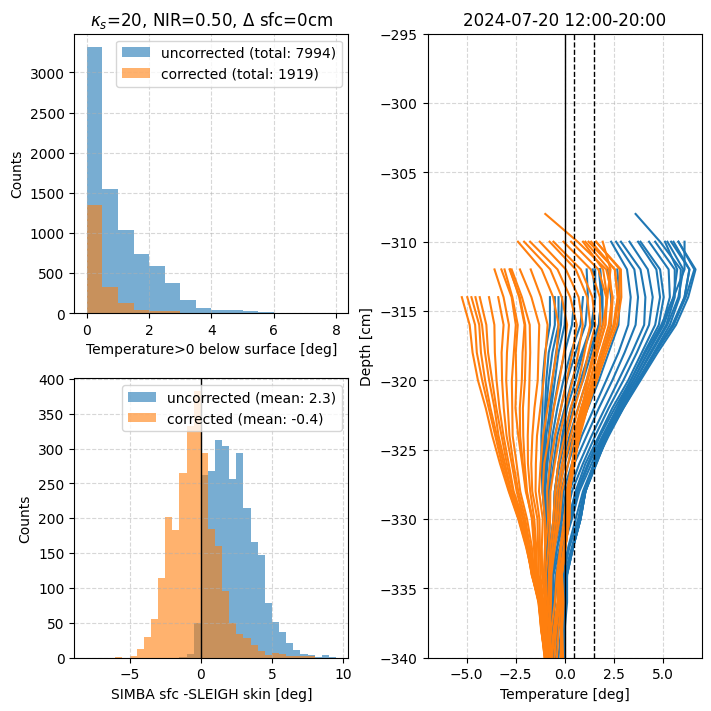

0.21717844903469086 0.5875882493705118
3.7767038345336914 2.757329857116483
5.41530704498291 1.7018830028037484
7.368351697921753 1.7416959557727538


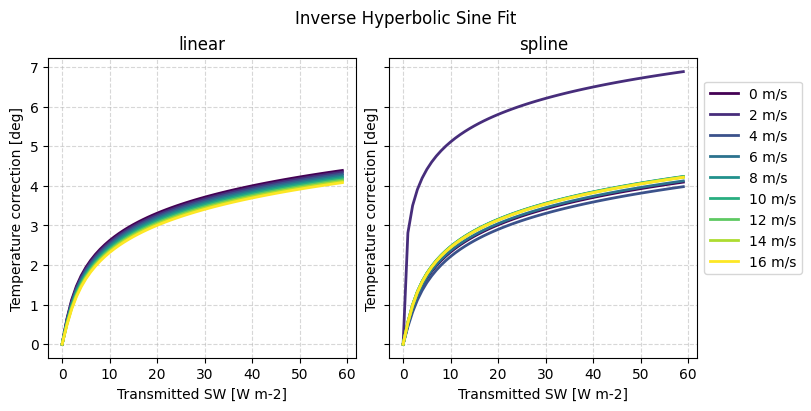

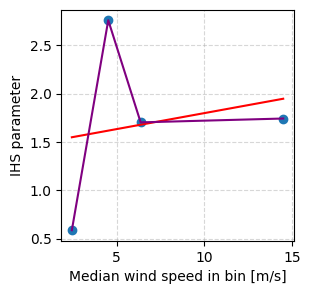

{'slope': np.float64(0.03302734911421625), 'intercept': np.float64(1.467305504852217), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e68496a0>}
{'slope': np.float64(0.03302734911421625), 'intercept': np.float64(1.467305504852217), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e68496a0>}


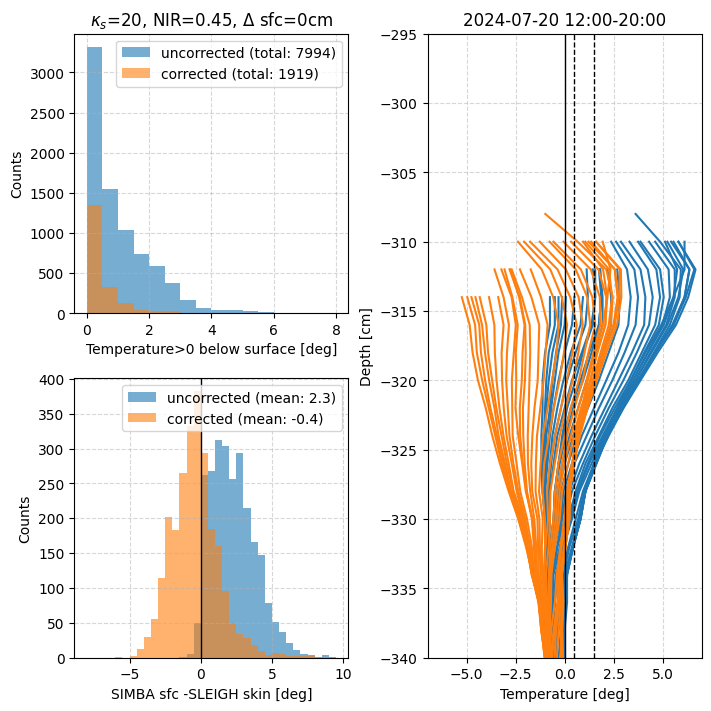

0.21717844903469086 0.6410053769963977
3.7767038345336914 3.0079883813474866
5.41530704498291 1.856599042140414
7.368351697921753 1.9000272512148058


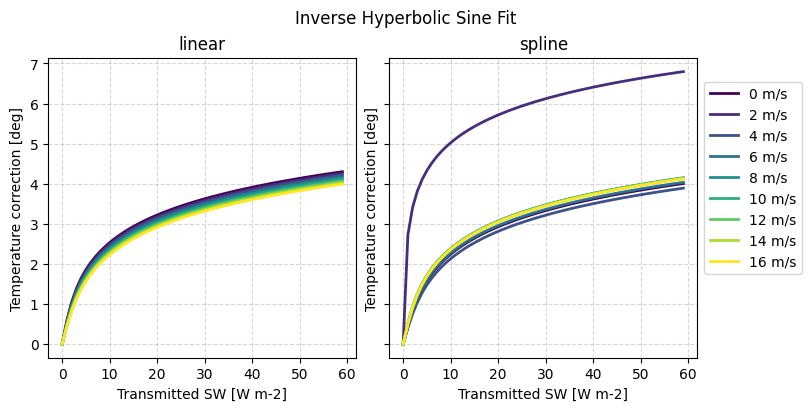

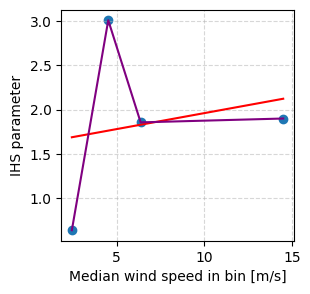

{'slope': np.float64(0.036029642775194035), 'intercept': np.float64(1.6006949771863201), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6197bb0>}
{'slope': np.float64(0.036029642775194035), 'intercept': np.float64(1.6006949771863201), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e6197bb0>}


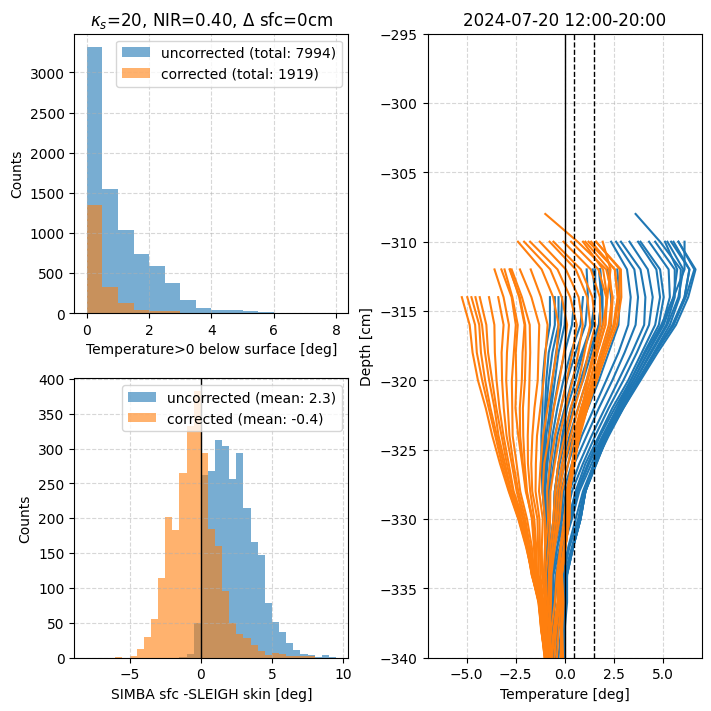

0.21717844903469086 0.6966126323330755
3.7767038345336914 2.5129560433337215
5.41530704498291 1.446241907273134
7.368351697921753 1.4824332250867842


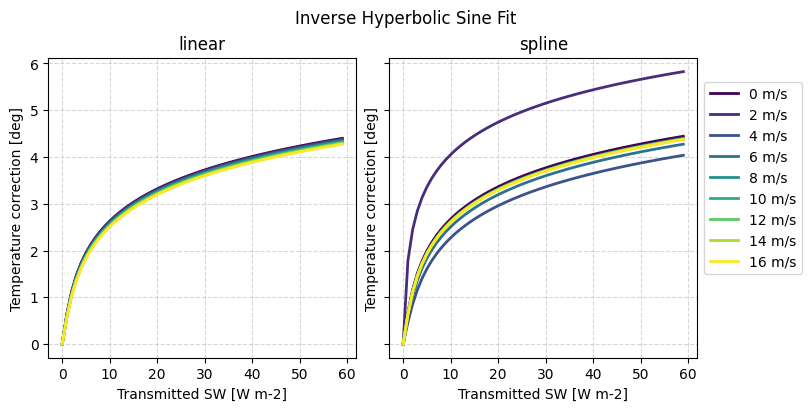

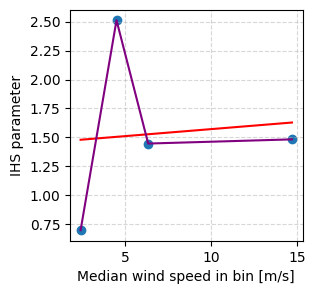

{'slope': np.float64(0.01209887760263594), 'intercept': np.float64(1.450002056986999), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e599feb0>}
{'slope': np.float64(0.01209887760263594), 'intercept': np.float64(1.450002056986999), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e599feb0>}


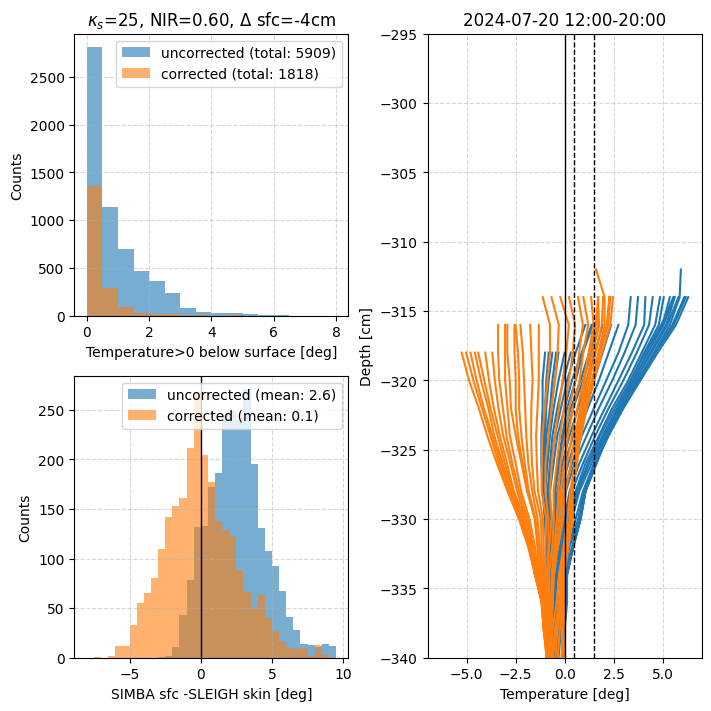

0.21717844903469086 0.7836892054271893
3.7767038345336914 2.827065520644881
5.41530704498291 1.627021493918866
7.368351697921753 1.6677298718330027


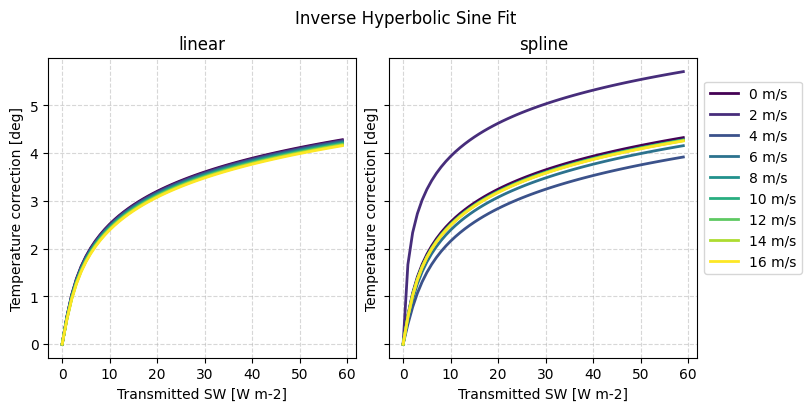

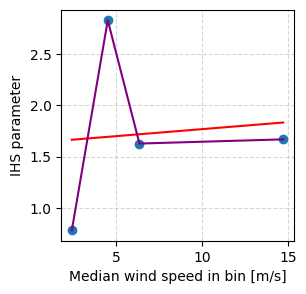

{'slope': np.float64(0.013610864911494753), 'intercept': np.float64(1.631250368697892), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e580e130>}
{'slope': np.float64(0.013610864911494753), 'intercept': np.float64(1.631250368697892), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e580e130>}


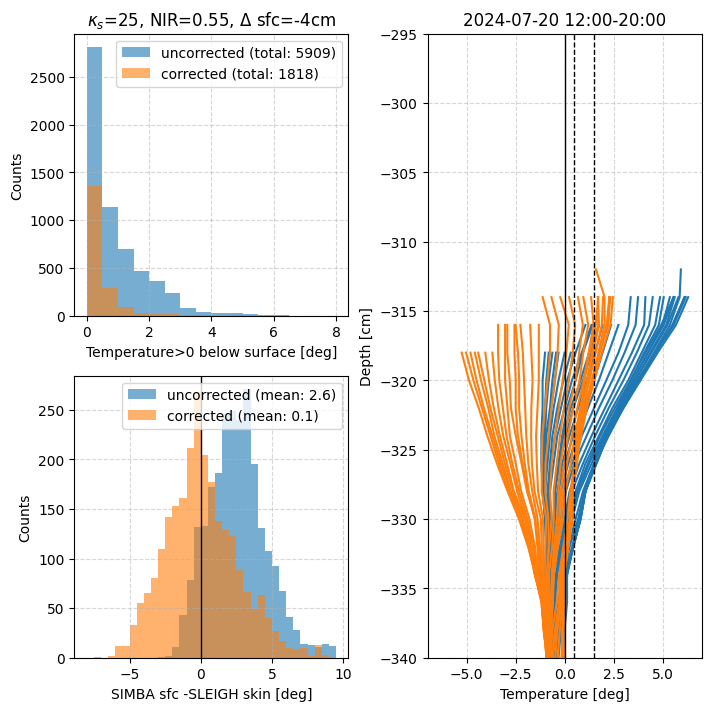

0.21717844903469086 0.8707657821117513
3.7767038345336914 3.1411721336296976
5.41530704498291 1.807800722701827
7.368351697921753 1.853023516812596


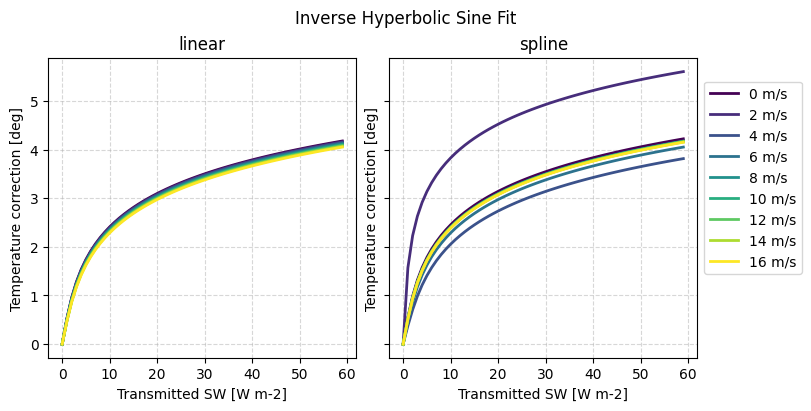

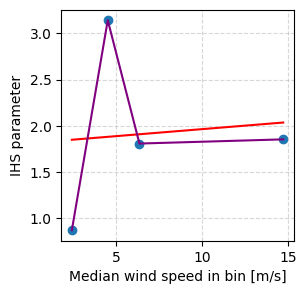

{'slope': np.float64(0.015122671023996719), 'intercept': np.float64(1.8124983916963957), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e533ff10>}
{'slope': np.float64(0.015122671023996719), 'intercept': np.float64(1.8124983916963957), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e533ff10>}


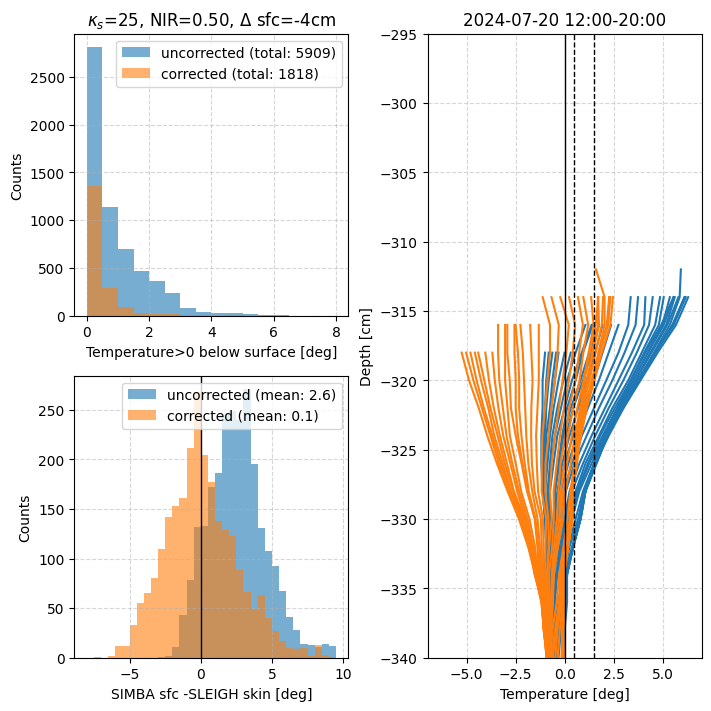

0.21717844903469086 0.9578423613235147
3.7767038345336914 3.45527590542671
5.41530704498291 1.9885795415849792
7.368351697921753 2.0383139161433443


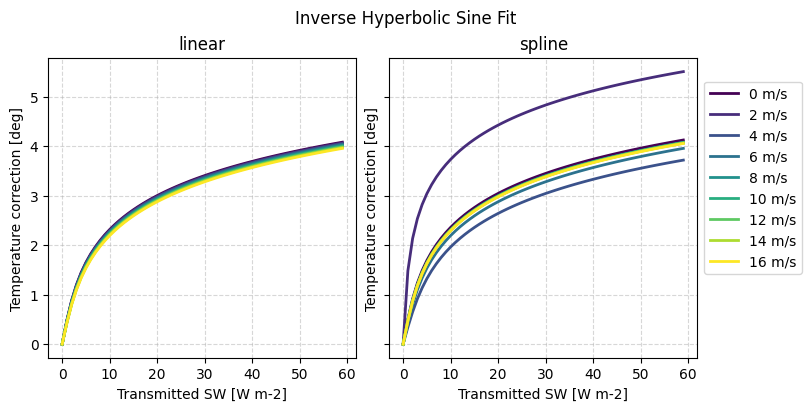

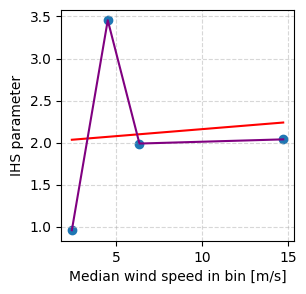

{'slope': np.float64(0.016634274161502906), 'intercept': np.float64(1.993746209732138), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e4d66ca0>}
{'slope': np.float64(0.016634274161502906), 'intercept': np.float64(1.993746209732138), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e4d66ca0>}


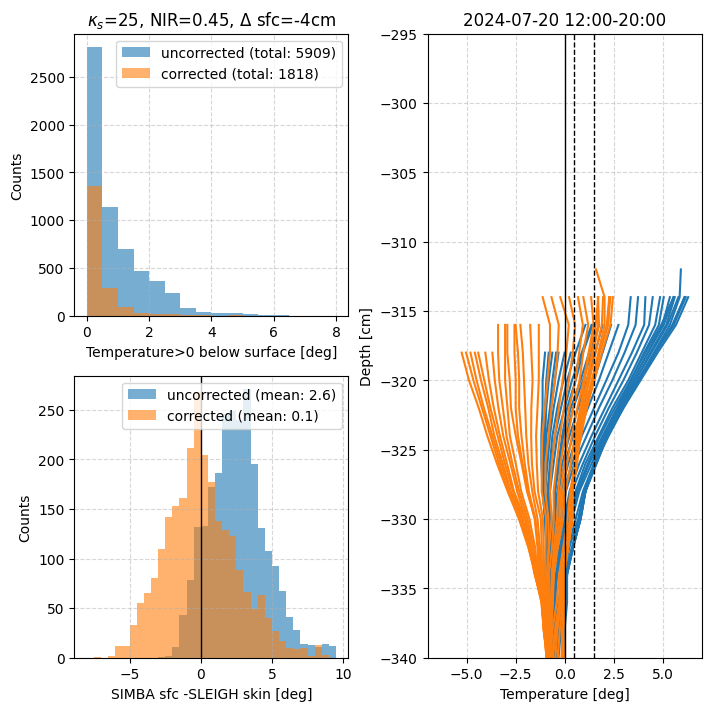

0.21717844903469086 1.0449189384489939
3.7767038345336914 3.7693767411794226
5.41530704498291 2.169357877325091
7.368351697921753 2.2236574676012357


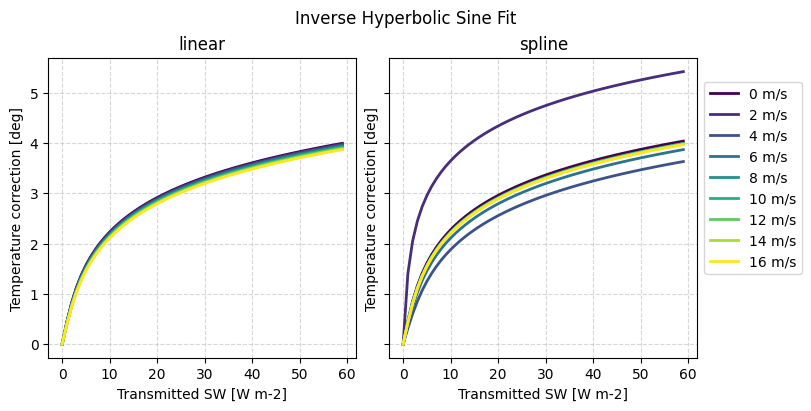

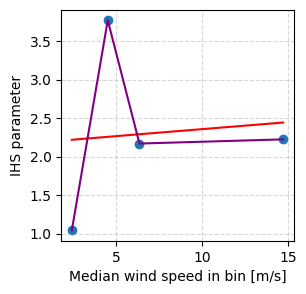

{'slope': np.float64(0.018150663614547122), 'intercept': np.float64(2.174973008985476), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e488c5b0>}
{'slope': np.float64(0.018150663614547122), 'intercept': np.float64(2.174973008985476), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e488c5b0>}


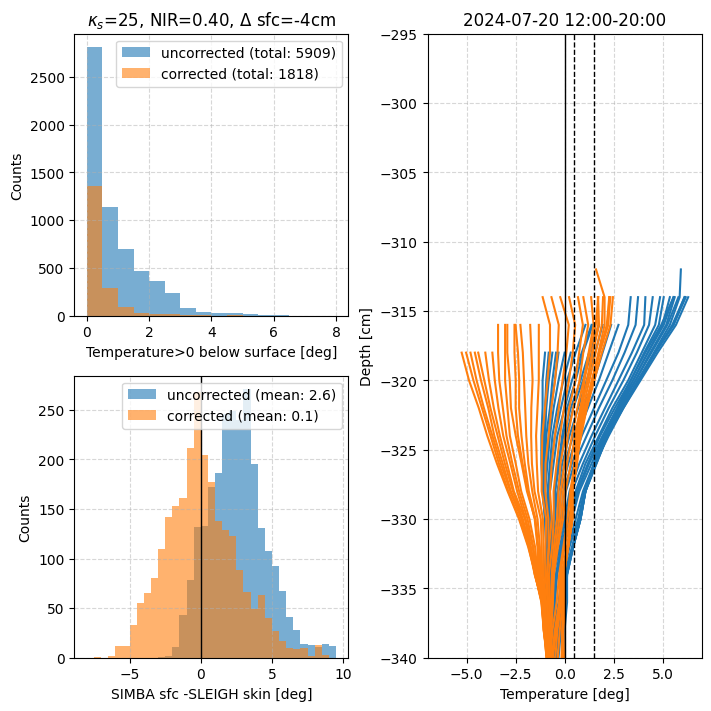

0.21717844903469086 0.4022908468409637
3.7767038345336914 2.5302205690716377
5.41530704498291 1.0780044683582284
7.368351697921753 1.2070926943127407


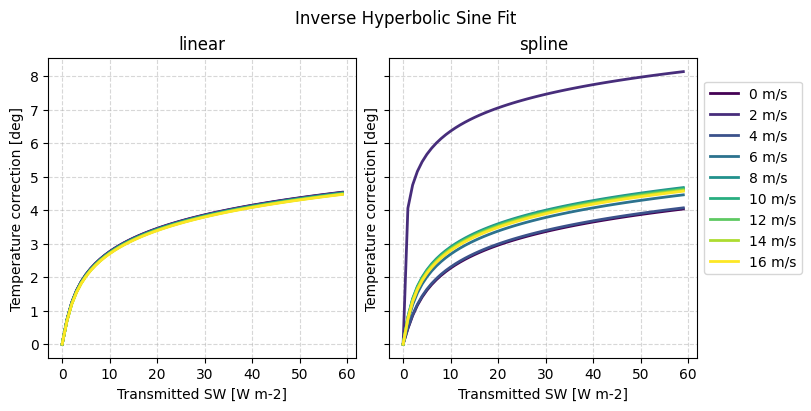

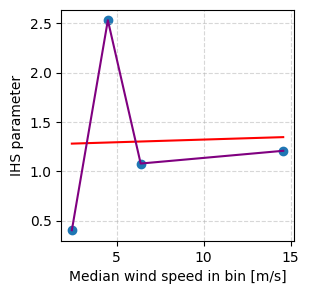

{'slope': np.float64(0.005414887246134777), 'intercept': np.float64(1.266673052452727), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e450a880>}
{'slope': np.float64(0.005414887246134777), 'intercept': np.float64(1.266673052452727), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e450a880>}


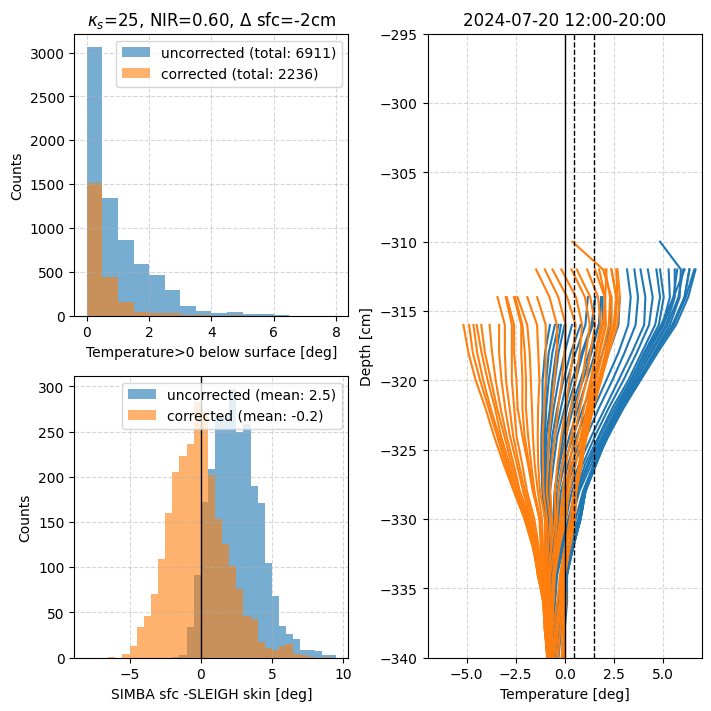

0.21717844903469086 0.4525772067325222
3.7767038345336914 2.8464802295016867
5.41530704498291 1.2127581862011318
7.368351697921753 1.3579694441945929


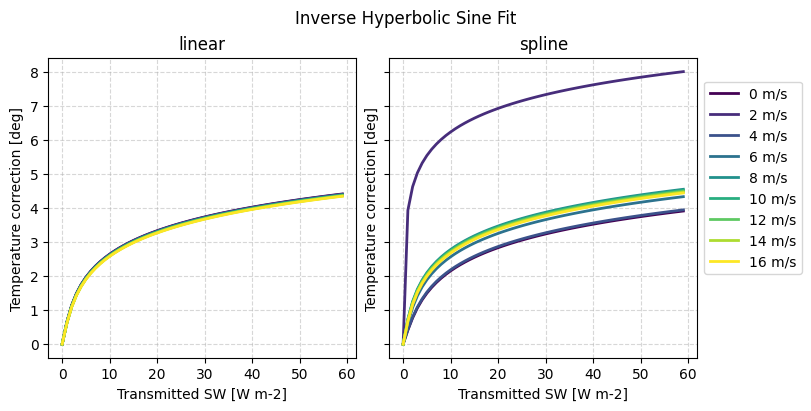

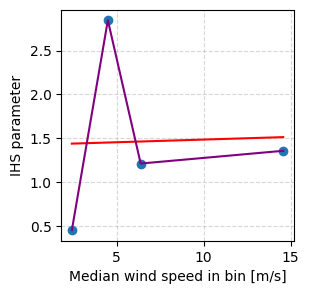

{'slope': np.float64(0.006091366878595381), 'intercept': np.float64(1.4250036945228615), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e3b4da00>}
{'slope': np.float64(0.006091366878595381), 'intercept': np.float64(1.4250036945228615), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e3b4da00>}


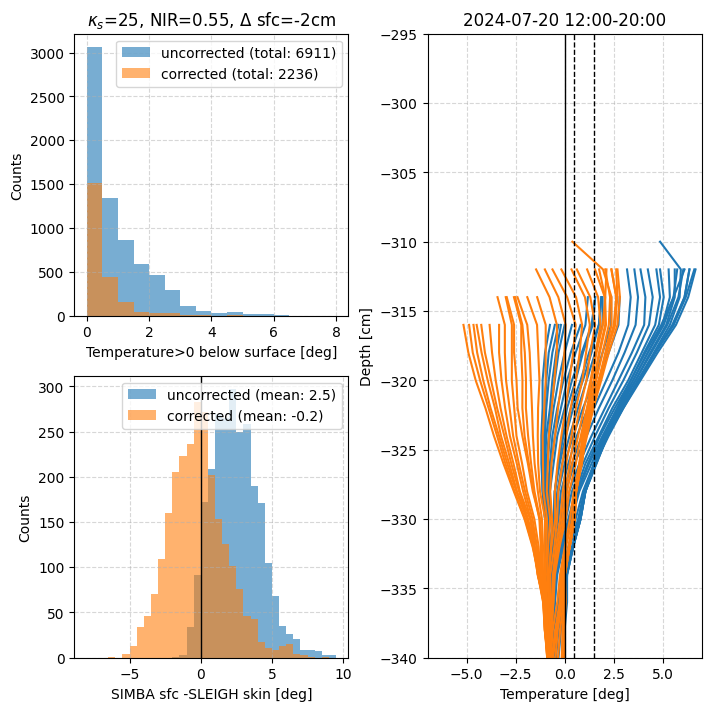

0.21717844903469086 0.5028635616798225
3.7767038345336914 3.1627351123818883
5.41530704498291 1.3475071562003018
7.368351697921753 1.508842153892422


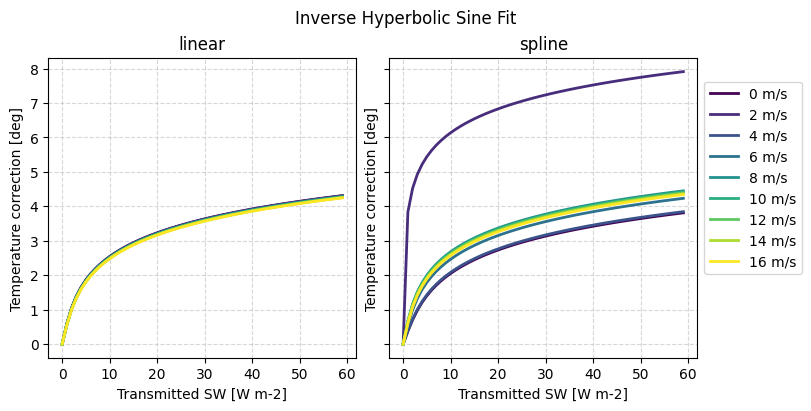

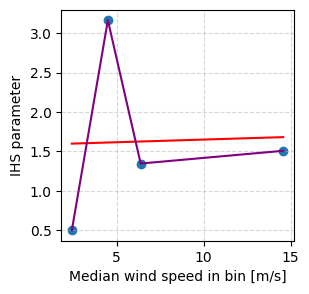

{'slope': np.float64(0.006767656975740801), 'intercept': np.float64(1.5833322645801262), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e3919220>}
{'slope': np.float64(0.006767656975740801), 'intercept': np.float64(1.5833322645801262), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e3919220>}


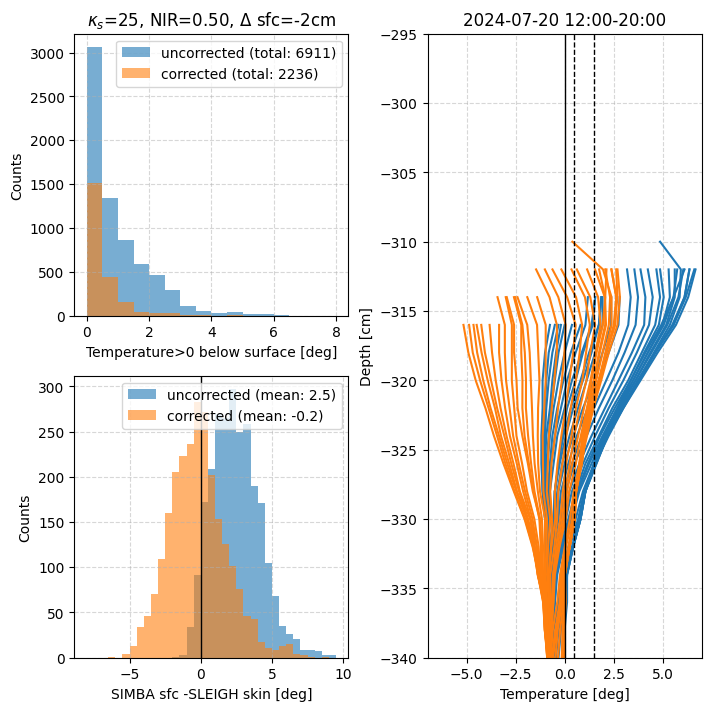

0.21717844903469086 0.5531499135904533
3.7767038345336914 3.479099273066428
5.41530704498291 1.4822549374744107
7.368351697921753 1.6597553329220718


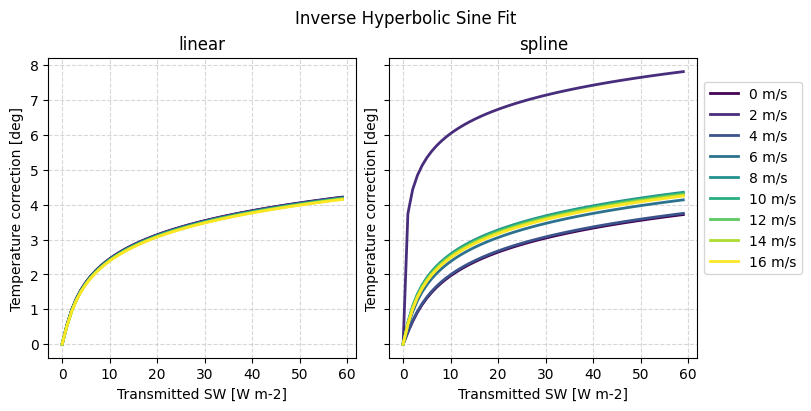

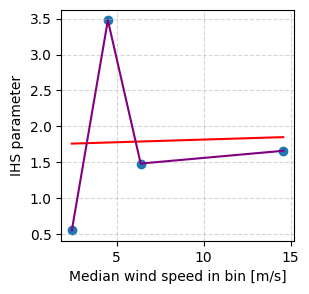

{'slope': np.float64(0.0074443965075411764), 'intercept': np.float64(1.7416948419732203), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea9d2dc0>}
{'slope': np.float64(0.0074443965075411764), 'intercept': np.float64(1.7416948419732203), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea9d2dc0>}


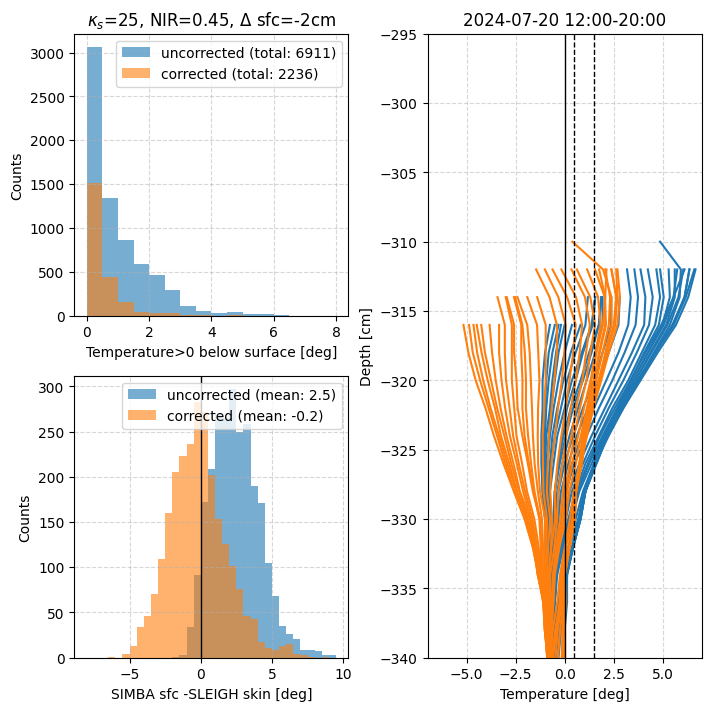

0.21717844903469086 0.6034362696891786
3.7767038345336914 3.795375033375023
5.41530704498291 1.6170119710268447
7.368351697921753 1.810638882965812


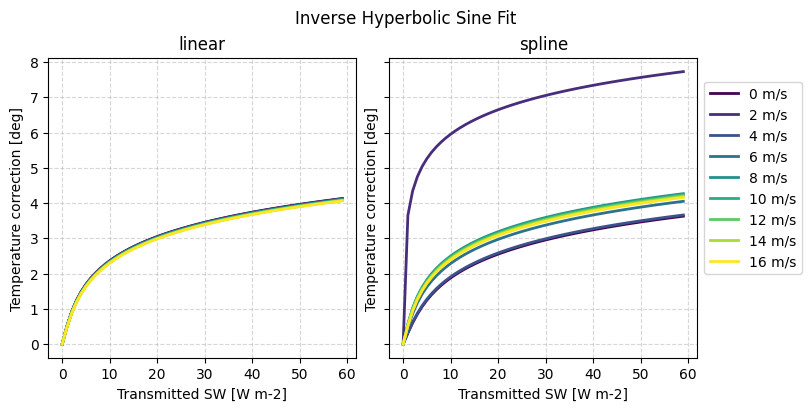

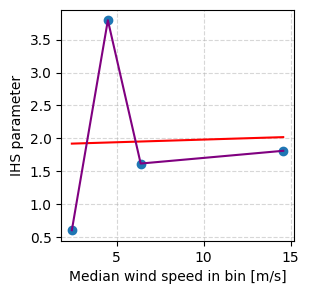

{'slope': np.float64(0.008120993414581178), 'intercept': np.float64(1.9000312199032645), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea420fa0>}
{'slope': np.float64(0.008120993414581178), 'intercept': np.float64(1.9000312199032645), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ea420fa0>}


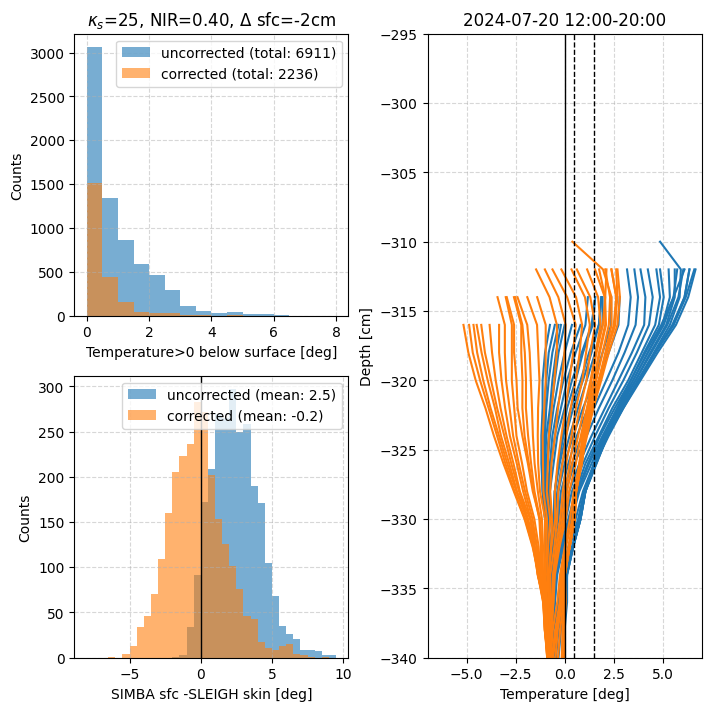

0.21717844903469086 0.2526629389127719
3.7767038345336914 1.7554023179058338
5.41530704498291 0.8356256806275127
7.368351697921753 0.9811591067052363


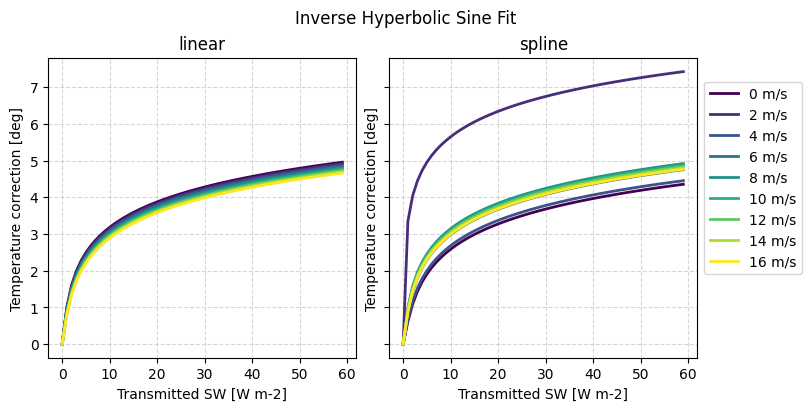

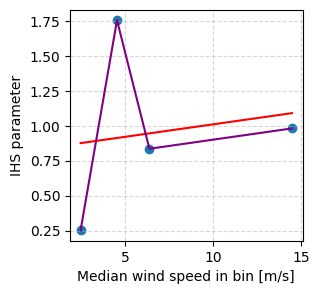

{'slope': np.float64(0.017811233031060768), 'intercept': np.float64(0.8322741501269273), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e29bf5e0>}
{'slope': np.float64(0.017811233031060768), 'intercept': np.float64(0.8322741501269273), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e29bf5e0>}


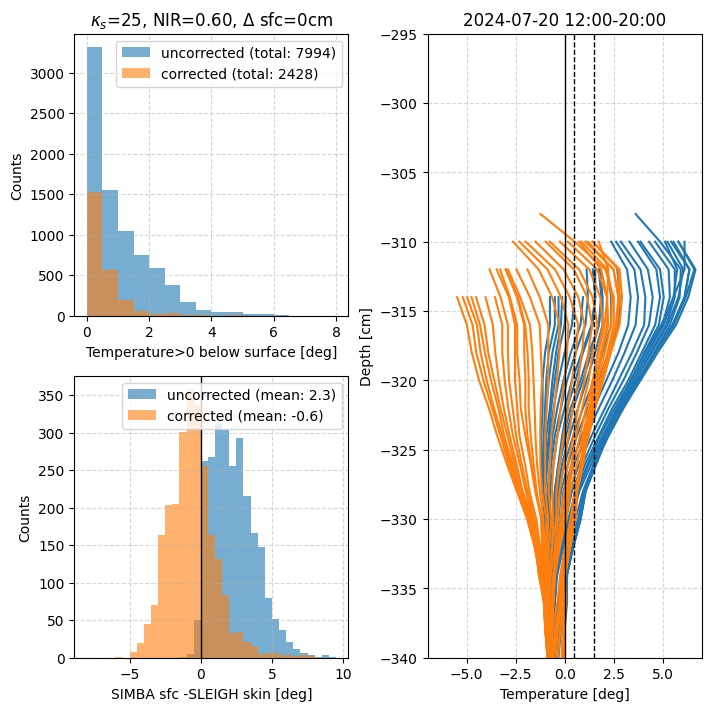

0.21717844903469086 0.28424580921557485
3.7767038345336914 1.9748137492769846
5.41530704498291 0.940073827665788
7.368351697921753 1.1037505921239572


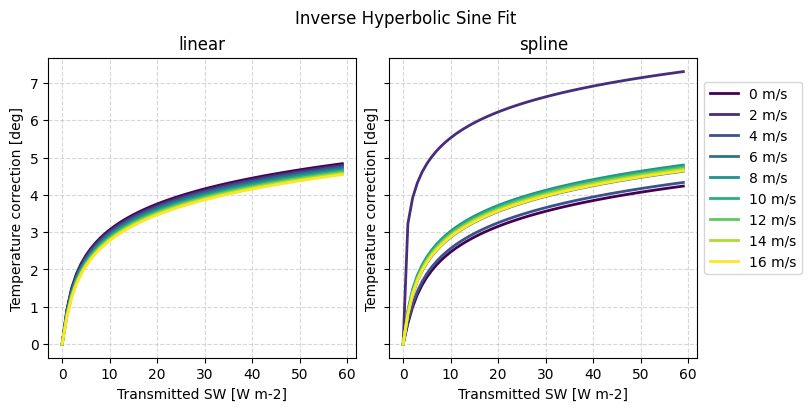

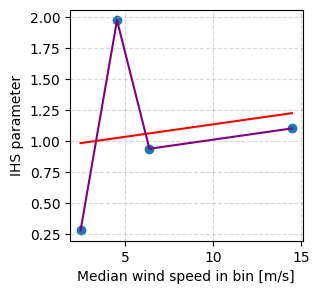

{'slope': np.float64(0.020033254048348794), 'intercept': np.float64(0.9363208381561184), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e99a4850>}
{'slope': np.float64(0.020033254048348794), 'intercept': np.float64(0.9363208381561184), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e99a4850>}


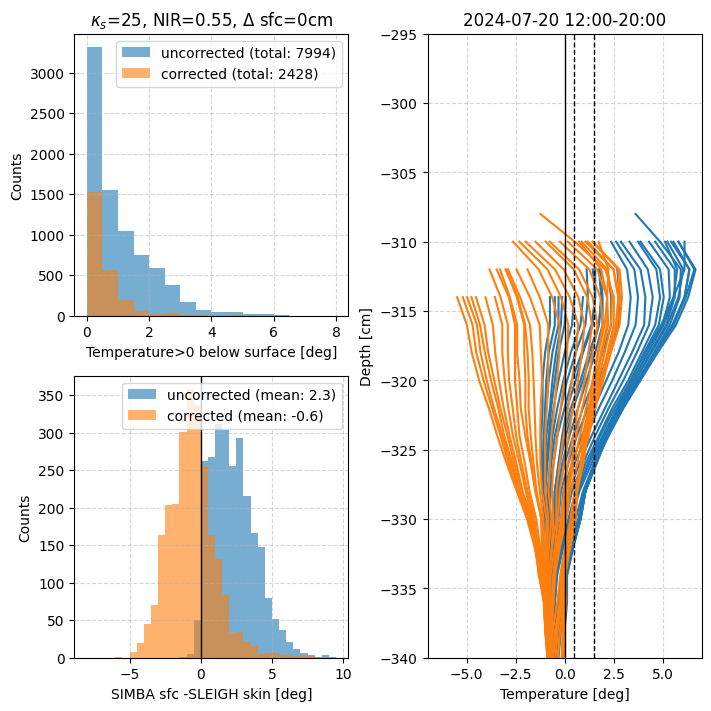

0.21717844903469086 0.31582867425433636
3.7767038345336914 2.1942767299030406
5.41530704498291 1.0445191335657544
7.368351697921753 1.226407121523997


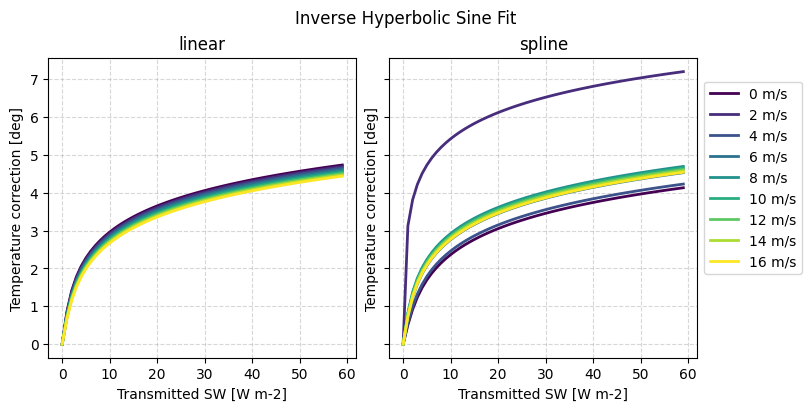

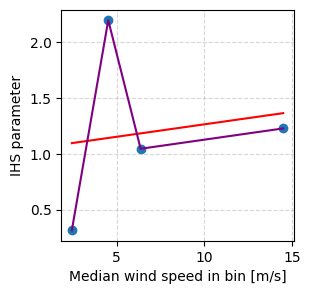

{'slope': np.float64(0.02225966530557103), 'intercept': np.float64(1.0403654136813507), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e927c700>}
{'slope': np.float64(0.02225966530557103), 'intercept': np.float64(1.0403654136813507), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e927c700>}


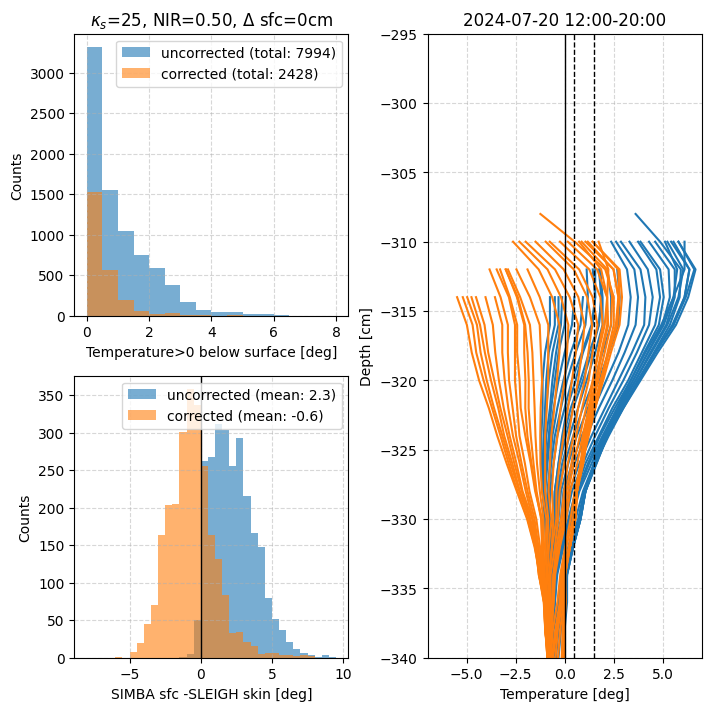

0.21717844903469086 0.3474115414026873
3.7767038345336914 2.4137004779287103
5.41530704498291 1.148973642297842
7.368351697921753 1.3490362319546274


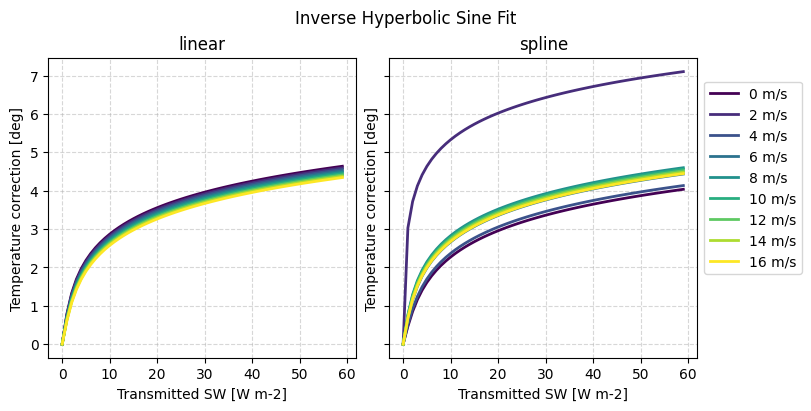

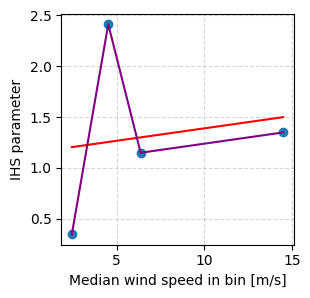

{'slope': np.float64(0.024484680240572314), 'intercept': np.float64(1.1444053437711772), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e1a36d00>}
{'slope': np.float64(0.024484680240572314), 'intercept': np.float64(1.1444053437711772), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e1a36d00>}


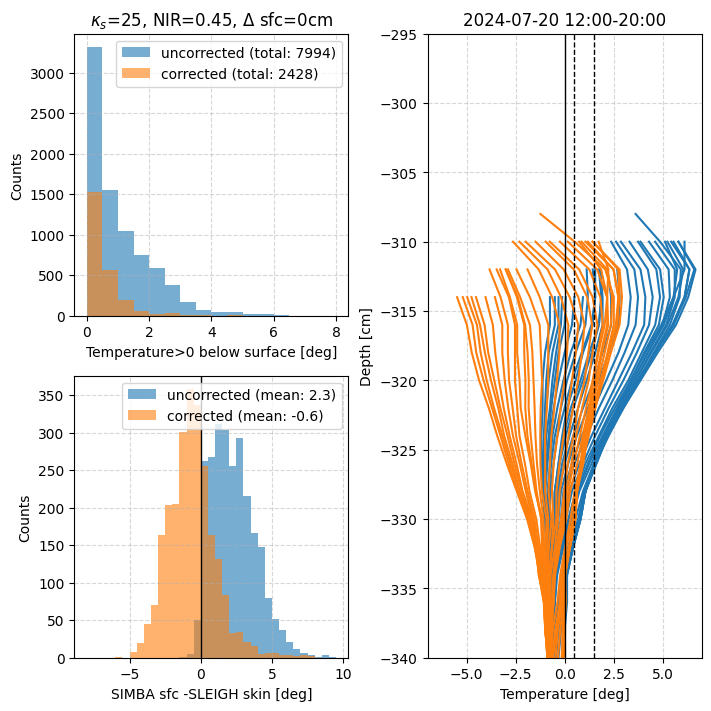

0.21717844903469086 0.3789944084194713
3.7767038345336914 2.633123285643658
5.41530704498291 1.2534234312157242
7.368351697921753 1.4716615892428324


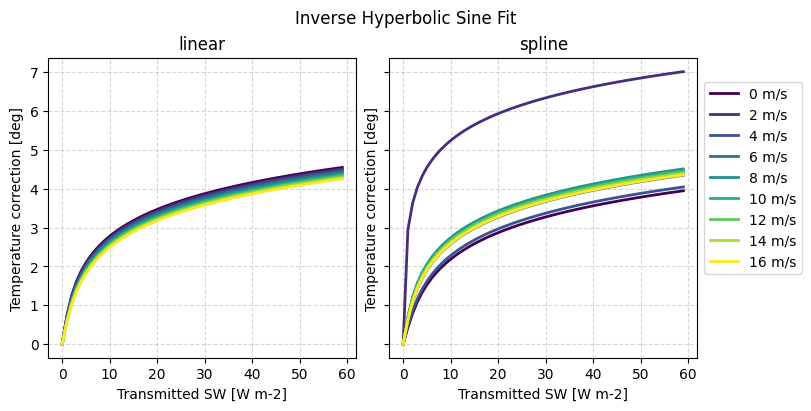

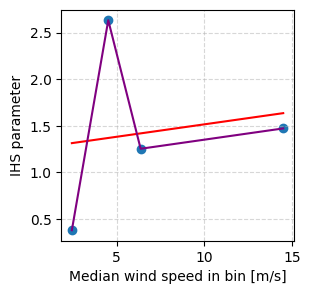

{'slope': np.float64(0.026709416999027912), 'intercept': np.float64(1.2484448561855226), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e14d0880>}
{'slope': np.float64(0.026709416999027912), 'intercept': np.float64(1.2484448561855226), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e14d0880>}


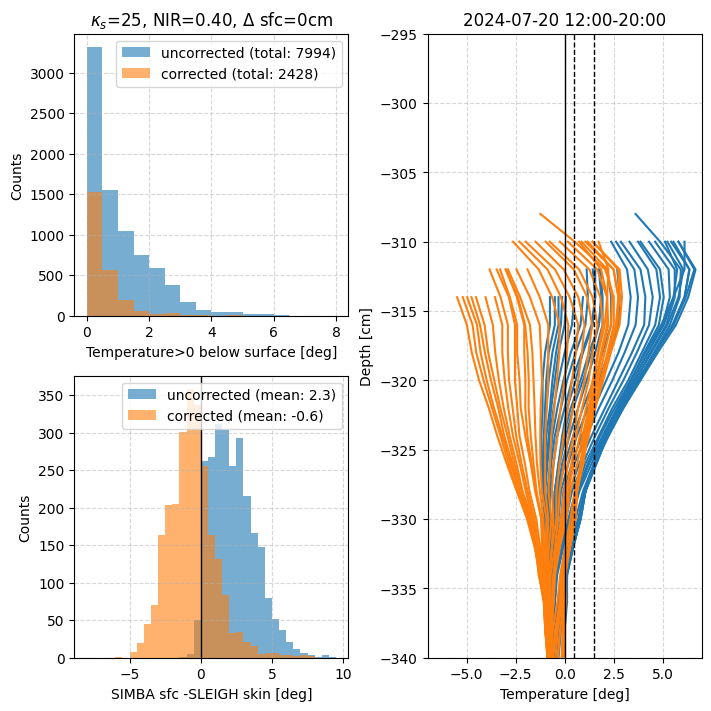

0.21717844903469086 0.4914582329434348
3.7767038345336914 2.0180505912108804
5.41530704498291 1.0888096487362338
7.368351697921753 1.1298288364434508


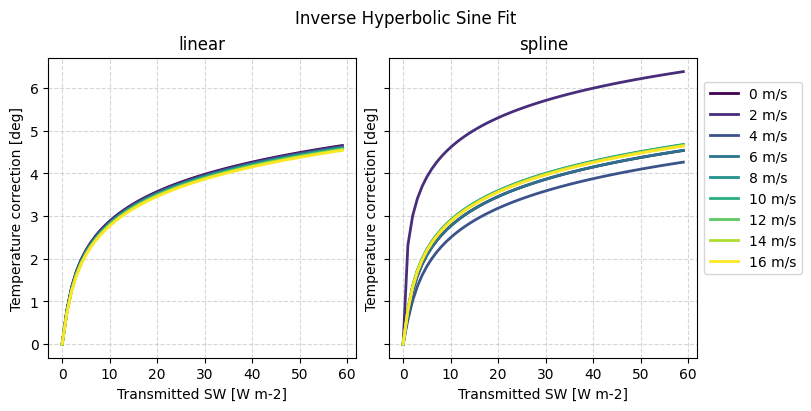

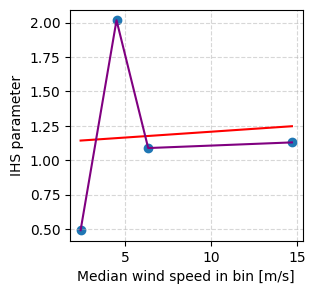

{'slope': np.float64(0.008458158451221475), 'intercept': np.float64(1.1229228701528078), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e0f87df0>}
{'slope': np.float64(0.008458158451221475), 'intercept': np.float64(1.1229228701528078), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e0f87df0>}


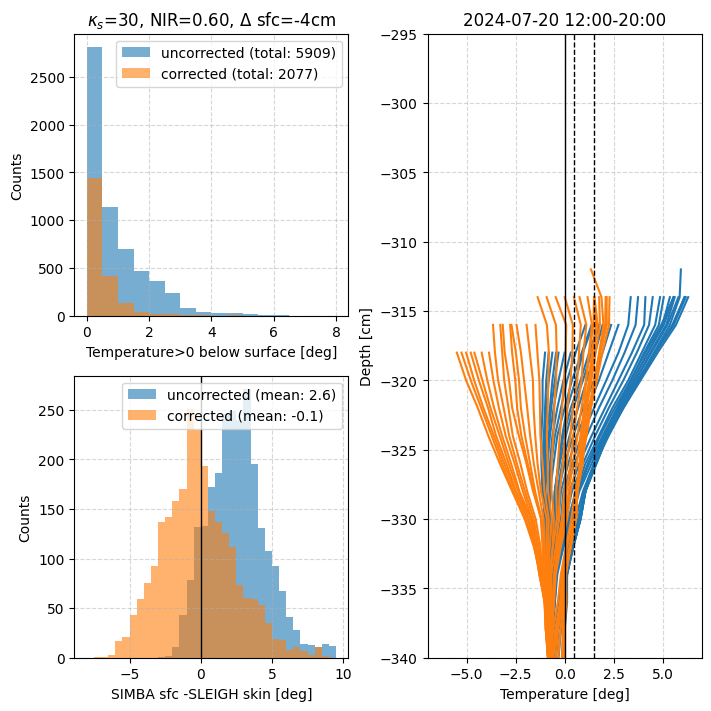

0.21717844903469086 0.5528906685775692
3.7767038345336914 2.2702940578433313
5.41530704498291 1.2249057377759485
7.368351697921753 1.2710819881420001


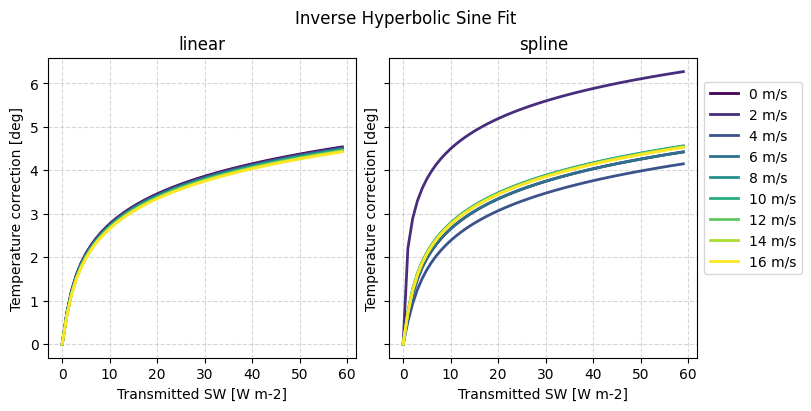

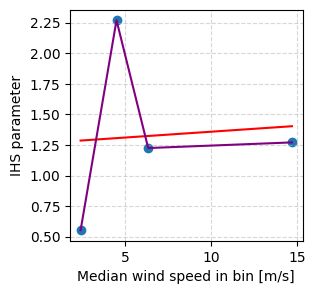

{'slope': np.float64(0.009517994821947809), 'intercept': np.float64(1.2632719735724327), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e0b13ee0>}
{'slope': np.float64(0.009517994821947809), 'intercept': np.float64(1.2632719735724327), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e0b13ee0>}


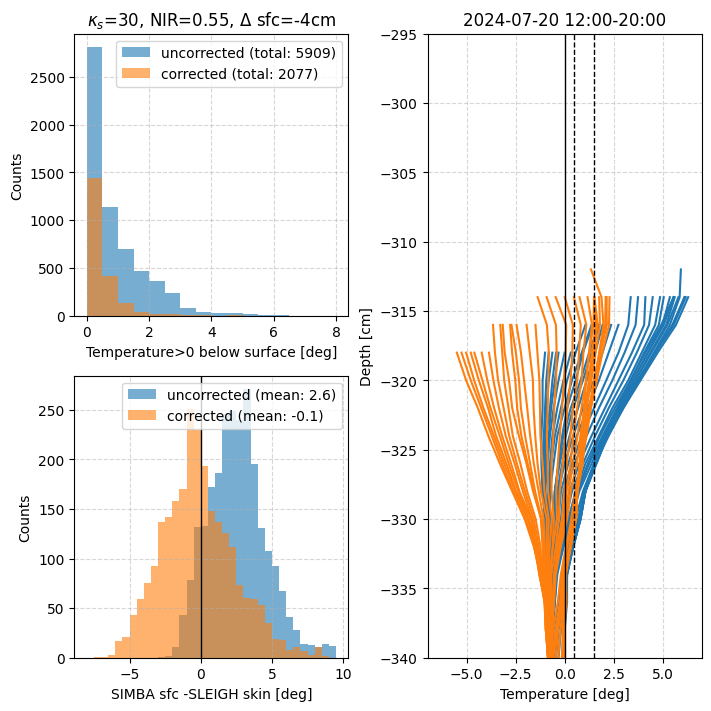

0.21717844903469086 0.6143225895104735
3.7767038345336914 2.522533885454885
5.41530704498291 1.361012657630618
7.368351697921753 1.4122983280577577


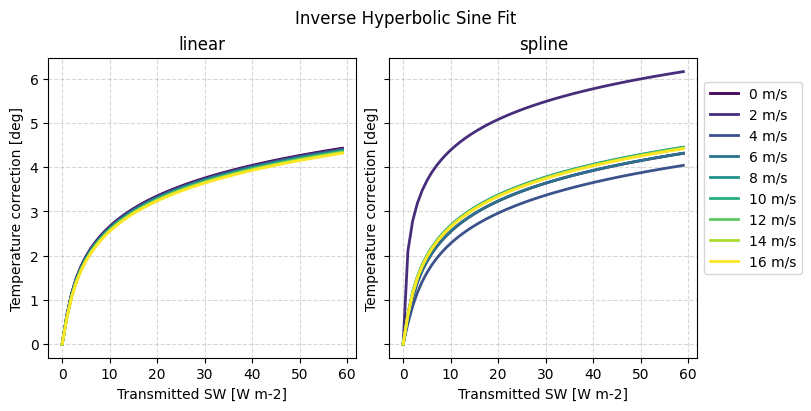

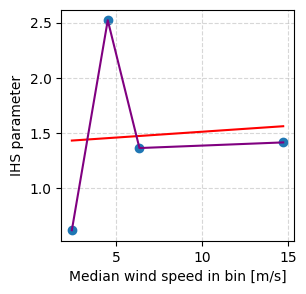

{'slope': np.float64(0.010574627379768092), 'intercept': np.float64(1.4036359347254534), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e05cfeb0>}
{'slope': np.float64(0.010574627379768092), 'intercept': np.float64(1.4036359347254534), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e05cfeb0>}


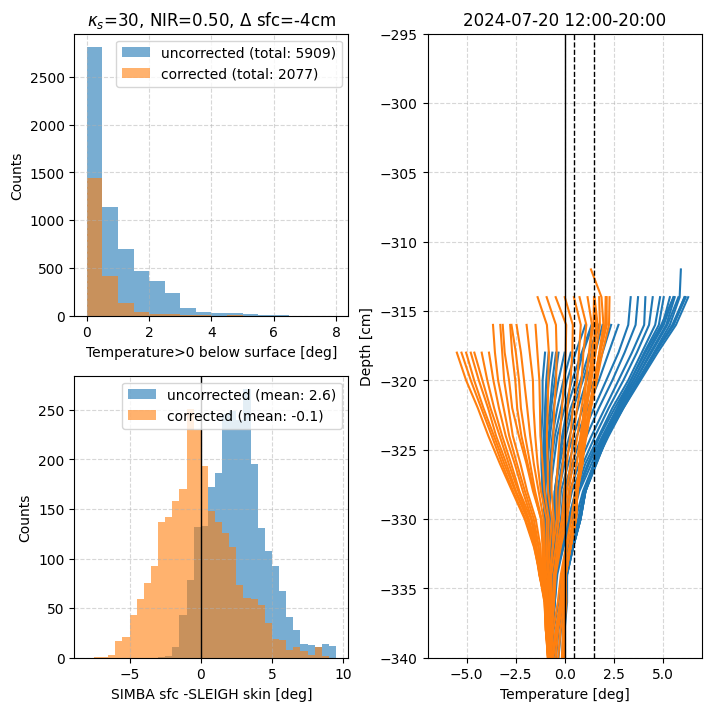

0.21717844903469086 0.6757551572871074
3.7767038345336914 2.774770039460112
5.41530704498291 1.4971126854125416
7.368351697921753 1.5535576646108047


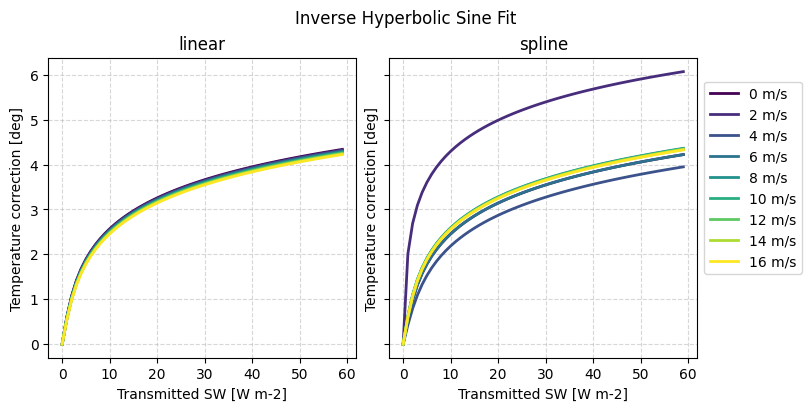

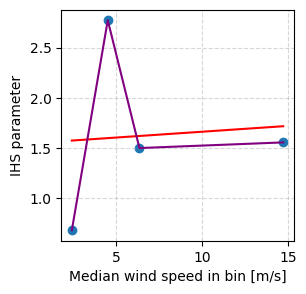

{'slope': np.float64(0.011635182979419432), 'intercept': np.float64(1.5439807472416607), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e00a62e0>}
{'slope': np.float64(0.011635182979419432), 'intercept': np.float64(1.5439807472416607), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e00a62e0>}


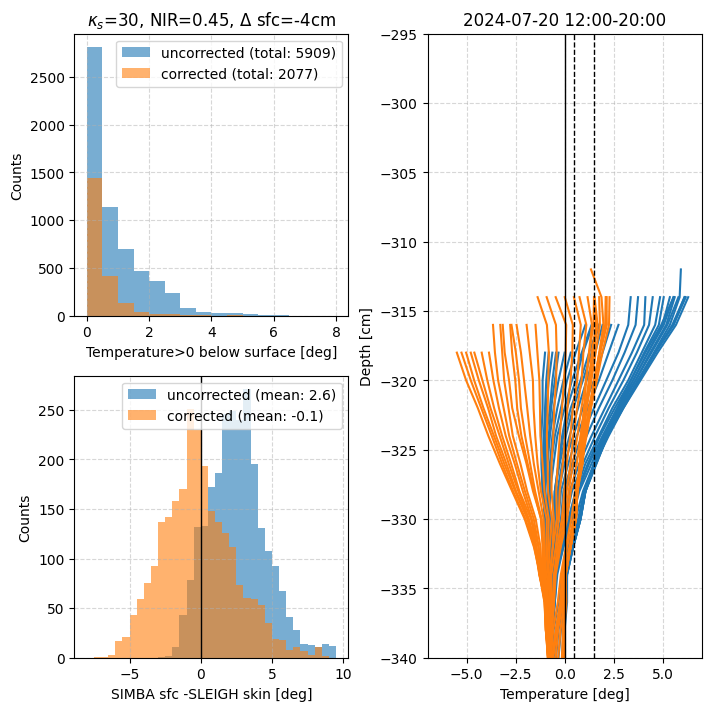

0.21717844903469086 0.7371875547856592
3.7767038345336914 3.0270024145851546
5.41530704498291 1.6332121890360853
7.368351697921753 1.6947860363426805


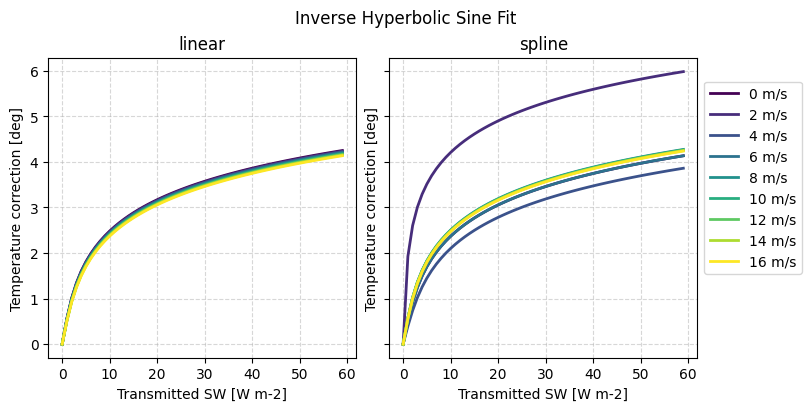

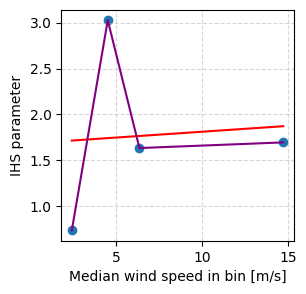

{'slope': np.float64(0.012693121774828757), 'intercept': np.float64(1.684334989033538), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dfcb0e20>}
{'slope': np.float64(0.012693121774828757), 'intercept': np.float64(1.684334989033538), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dfcb0e20>}


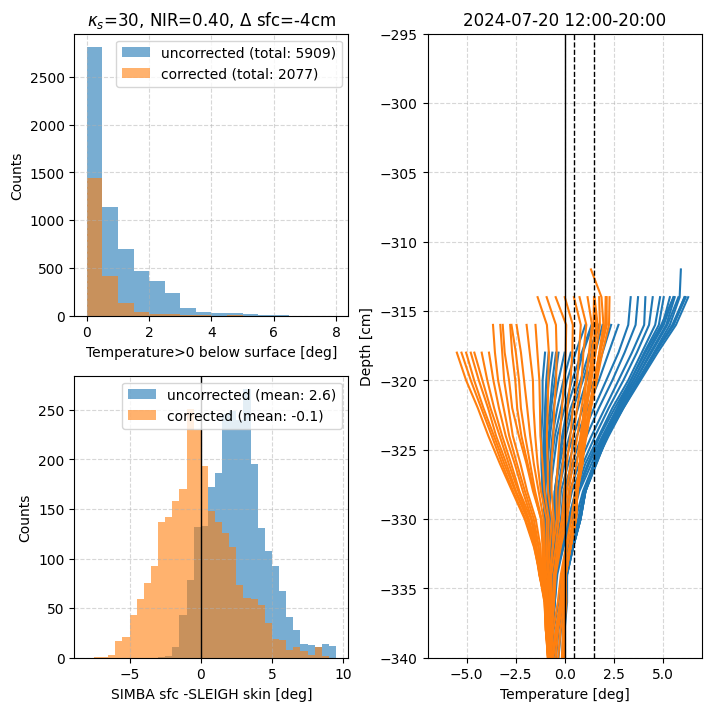

0.21717844903469086 0.2768544432476462
3.7767038345336914 1.9100573680036534
5.41530704498291 0.8523172300450517
7.368351697921753 0.9218867350868085


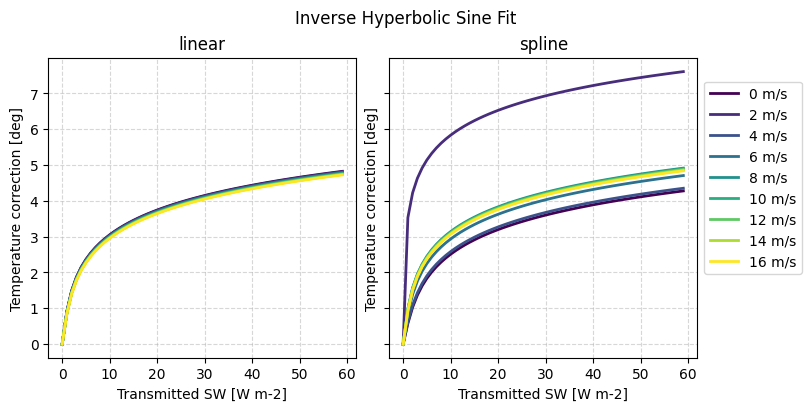

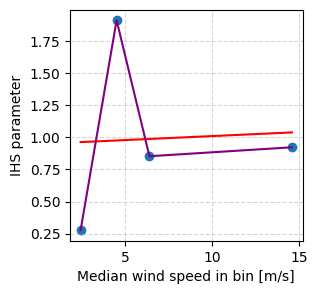

{'slope': np.float64(0.006211096388297584), 'intercept': np.float64(0.9470021374693929), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75df7ac760>}
{'slope': np.float64(0.006211096388297584), 'intercept': np.float64(0.9470021374693929), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75df7ac760>}


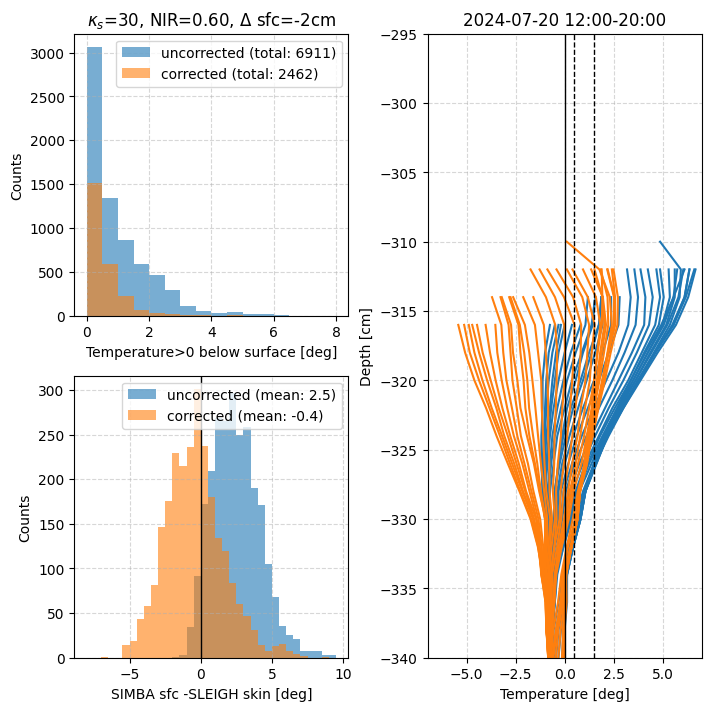

0.21717844903469086 0.3114612237730318
3.7767038345336914 2.148794884746855
5.41530704498291 0.9588635735967828
7.368351697921753 1.0370668811804435


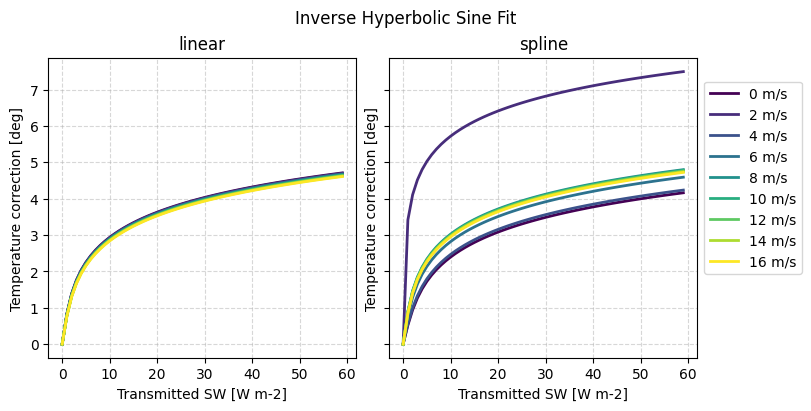

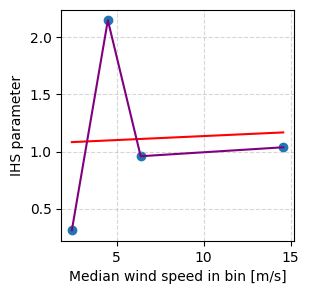

{'slope': np.float64(0.006983023395291629), 'intercept': np.float64(1.0653913094217535), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e66f8220>}
{'slope': np.float64(0.006983023395291629), 'intercept': np.float64(1.0653913094217535), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e66f8220>}


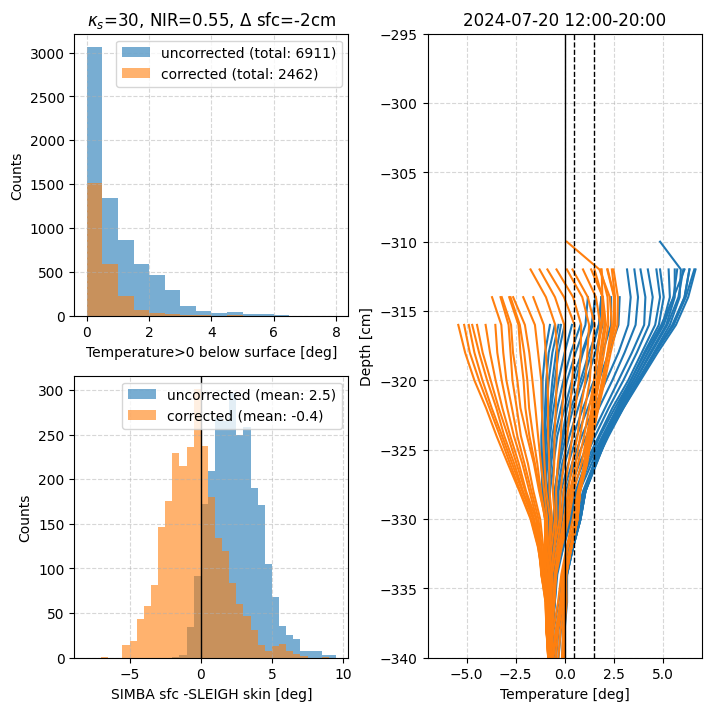

0.21717844903469086 0.34606801140803456
3.7767038345336914 2.3875270104357798
5.41530704498291 1.0653914225521741
7.368351697921753 1.152296596685305


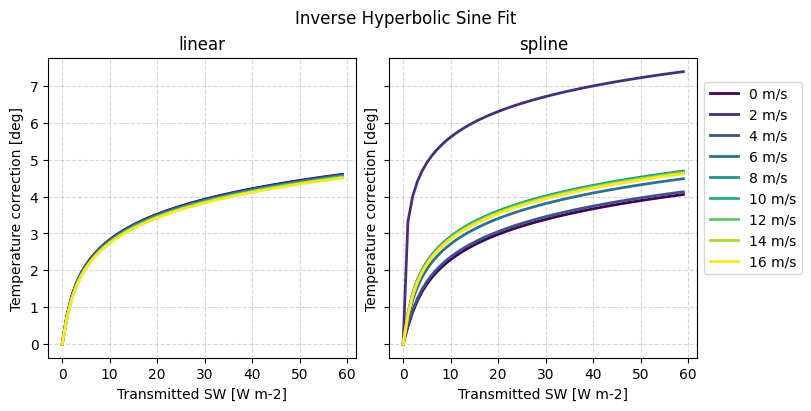

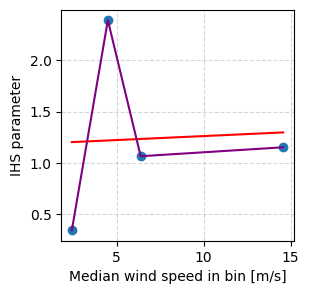

{'slope': np.float64(0.007759673939585044), 'intercept': np.float64(1.1837539920907105), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ded57eb0>}
{'slope': np.float64(0.007759673939585044), 'intercept': np.float64(1.1837539920907105), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75ded57eb0>}


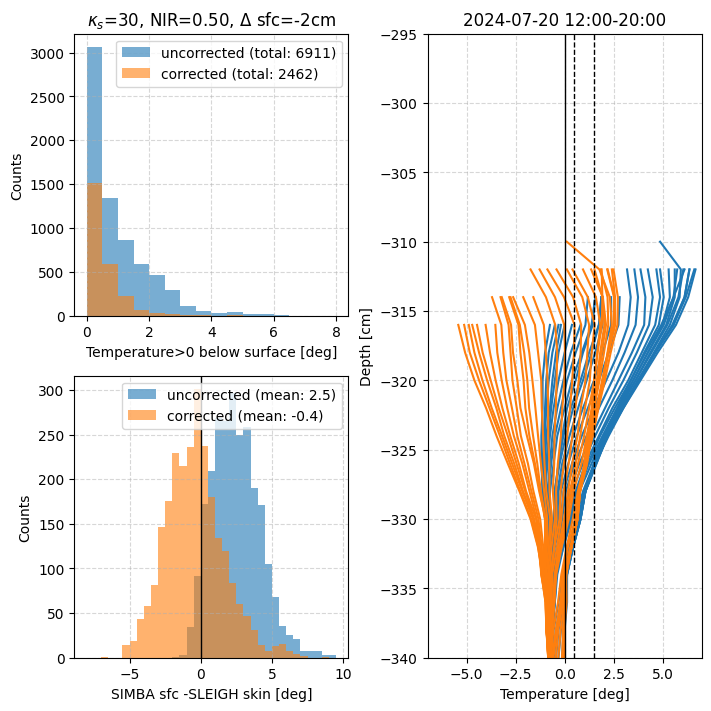

0.21717844903469086 0.38067480581531526
3.7767038345336914 2.626363524040744
5.41530704498291 1.171923770088469
7.368351697921753 1.26750434288179


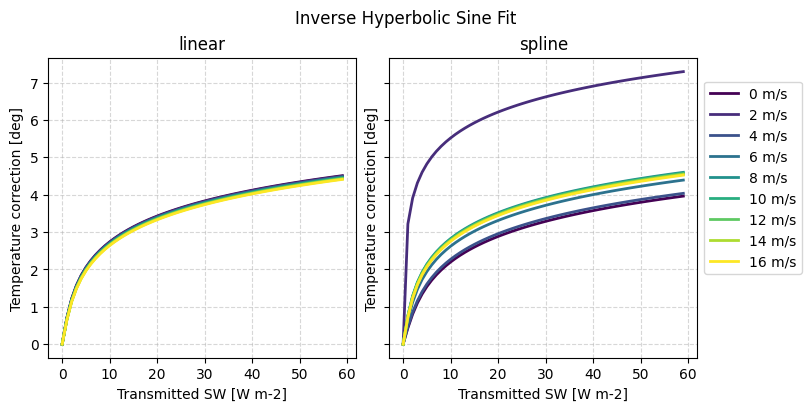

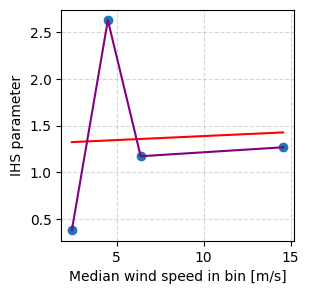

{'slope': np.float64(0.008531285081095526), 'intercept': np.float64(1.3021735185940717), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75de719820>}
{'slope': np.float64(0.008531285081095526), 'intercept': np.float64(1.3021735185940717), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75de719820>}


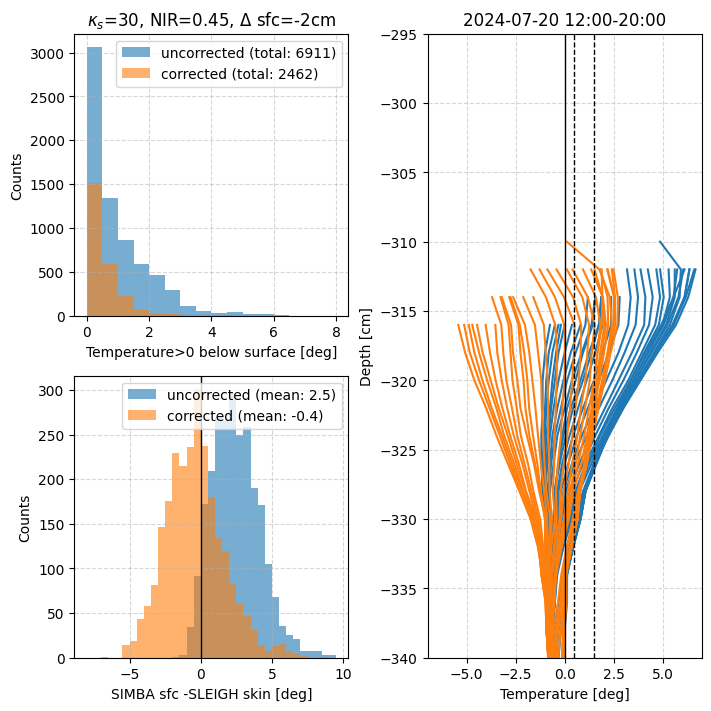

0.21717844903469086 0.41528165034200176
3.7767038345336914 2.8651163082579187
5.41530704498291 1.2784703825064194
7.368351697921753 1.382765439234138


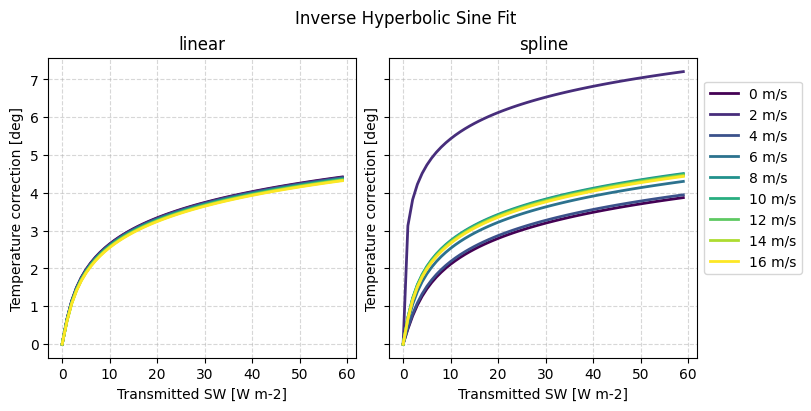

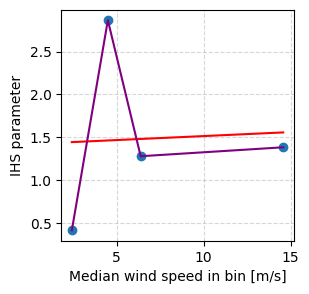

{'slope': np.float64(0.00931001122478327), 'intercept': np.float64(1.42053945412506), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75de2c1040>}
{'slope': np.float64(0.00931001122478327), 'intercept': np.float64(1.42053945412506), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75de2c1040>}


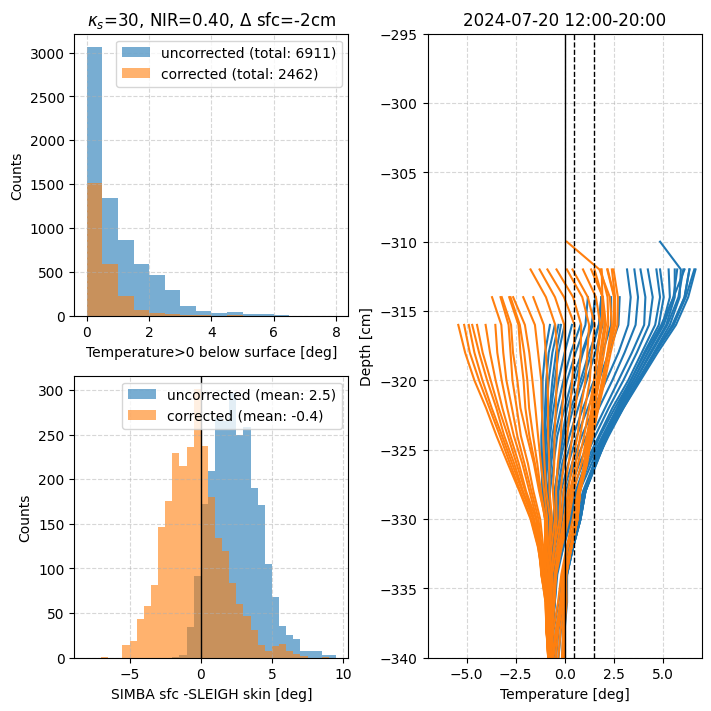

0.21717844903469086 0.1619006259656753
3.7767038345336914 1.4324072081719084
5.41530704498291 0.7140915467003738
7.368351697921753 0.7665597165489204


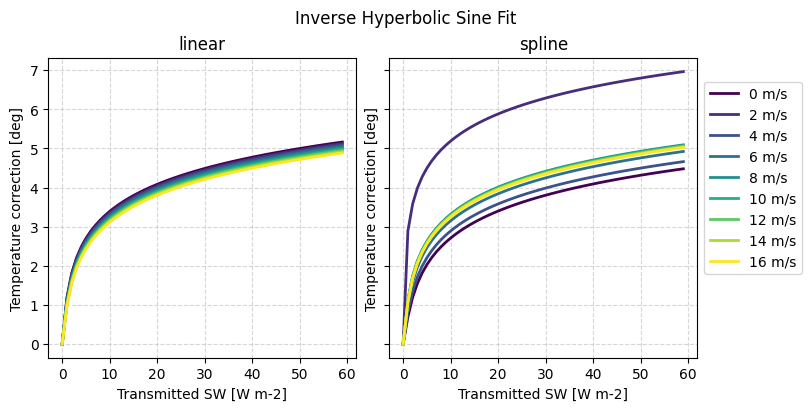

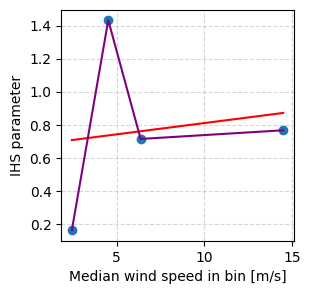

{'slope': np.float64(0.013623022526130337), 'intercept': np.float64(0.6739448166031085), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e52f6fd0>}
{'slope': np.float64(0.013623022526130337), 'intercept': np.float64(0.6739448166031085), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75e52f6fd0>}


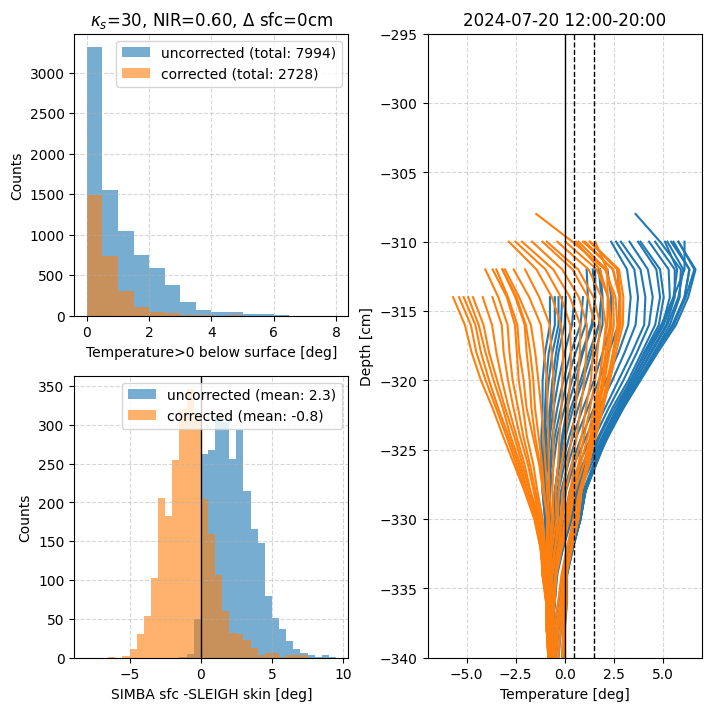

0.21717844903469086 0.18213819748829177
3.7767038345336914 1.6114379499137244
5.41530704498291 0.8033578236952524
7.368351697921753 0.8623739032303047


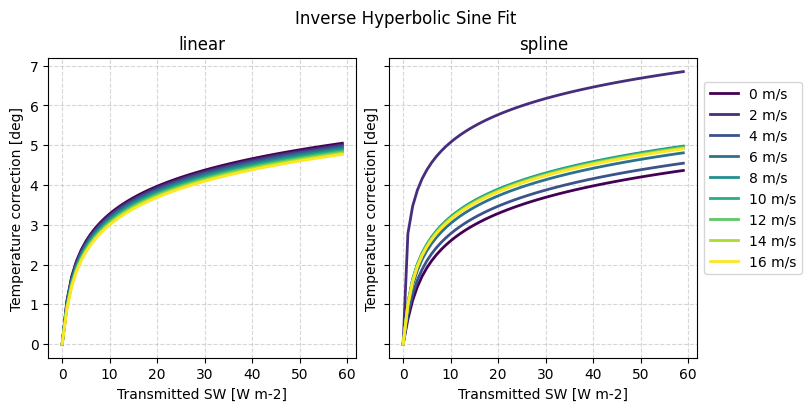

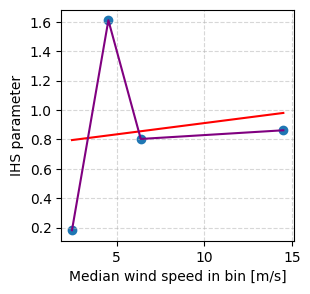

{'slope': np.float64(0.015325933179748128), 'intercept': np.float64(0.7581824126201767), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dd7dd340>}
{'slope': np.float64(0.015325933179748128), 'intercept': np.float64(0.7581824126201767), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dd7dd340>}


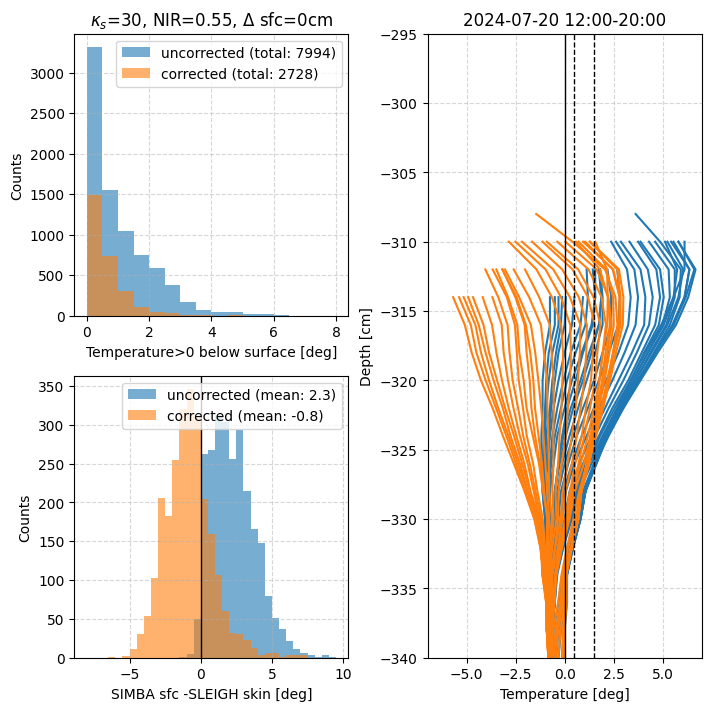

0.21717844903469086 0.20237581924012116
3.7767038345336914 1.7905301035258683
5.41530704498291 0.8926202148996393
7.368351697921753 0.9582020814737283


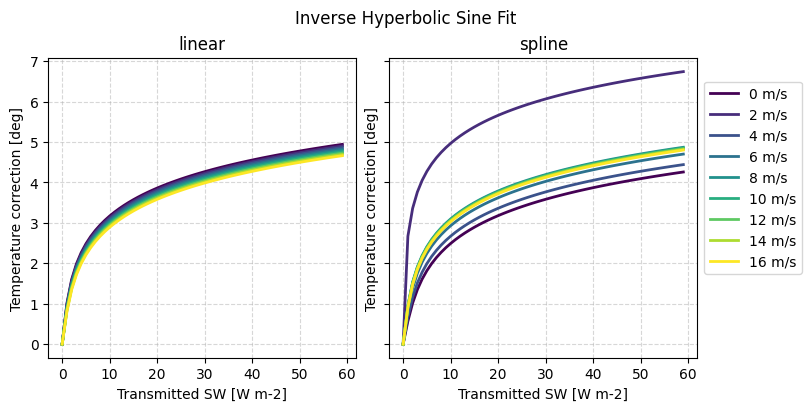

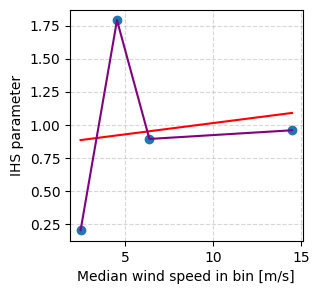

{'slope': np.float64(0.017028339580374263), 'intercept': np.float64(0.8424414094182006), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dd301850>}
{'slope': np.float64(0.017028339580374263), 'intercept': np.float64(0.8424414094182006), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dd301850>}


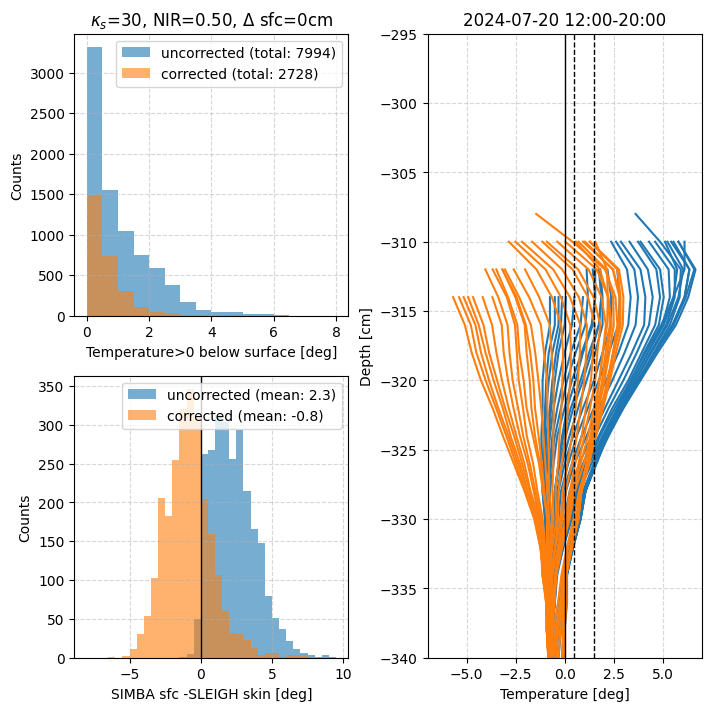

0.21717844903469086 0.22261338146114534
3.7767038345336914 1.969576363694859
5.41530704498291 0.9818847315364962
7.368351697921753 1.0539513239559197


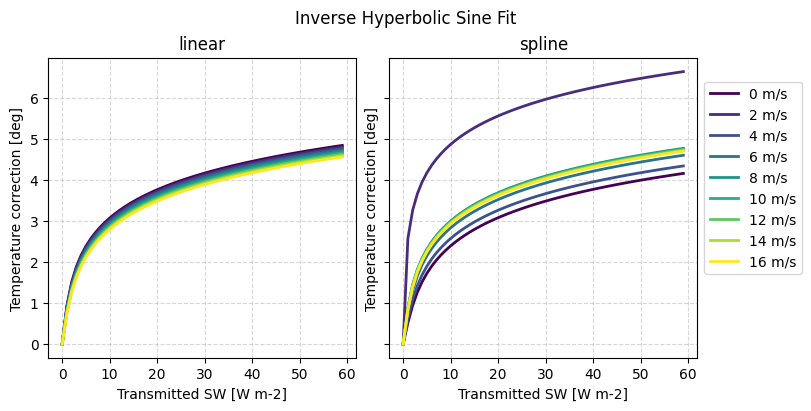

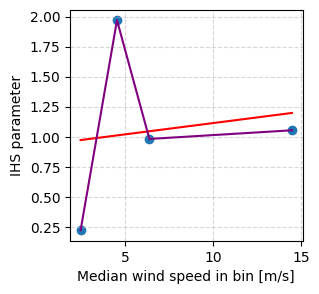

{'slope': np.float64(0.018724944517522896), 'intercept': np.float64(0.9267100845145143), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dcdd2f70>}
{'slope': np.float64(0.018724944517522896), 'intercept': np.float64(0.9267100845145143), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dcdd2f70>}


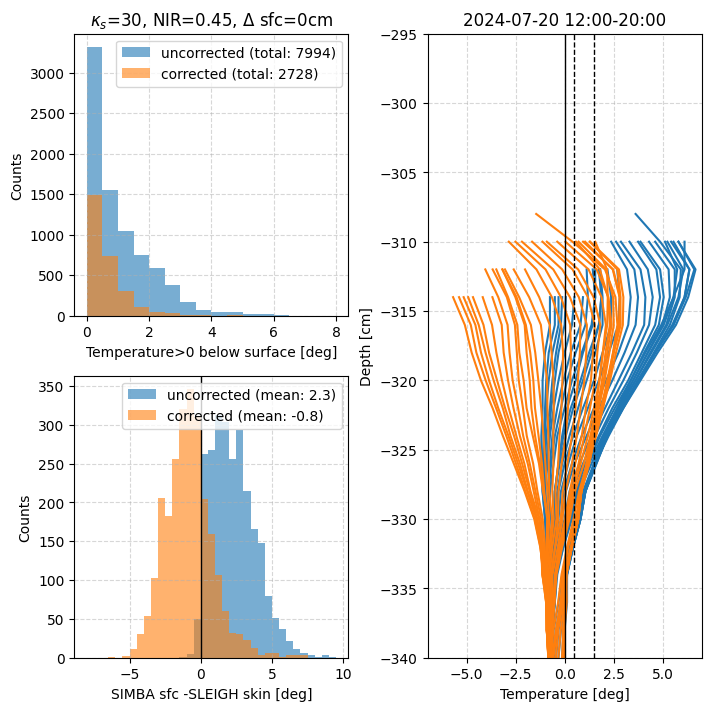

0.21717844903469086 0.24285094824178596
3.7767038345336914 2.1486210107344266
5.41530704498291 1.0711362886861198
7.368351697921753 1.1497786184546412


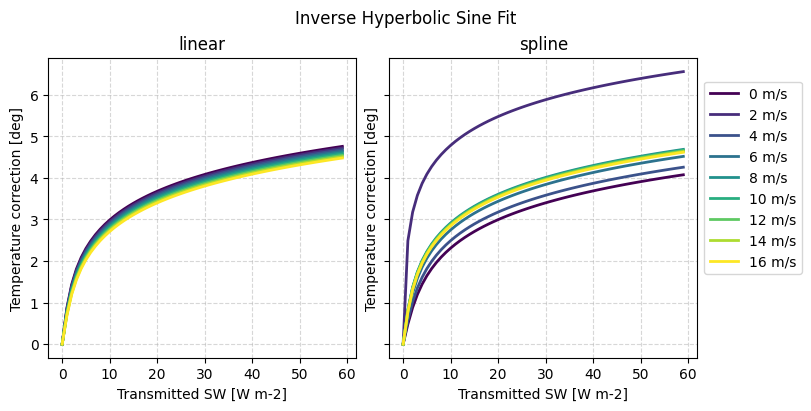

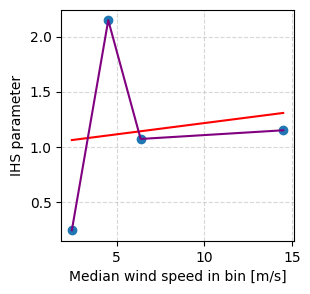

{'slope': np.float64(0.020428737387215592), 'intercept': np.float64(1.0109446138176794), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dc8d48b0>}
{'slope': np.float64(0.020428737387215592), 'intercept': np.float64(1.0109446138176794), 'spline': <scipy.interpolate._bsplines.BSpline object at 0x7f75dc8d48b0>}


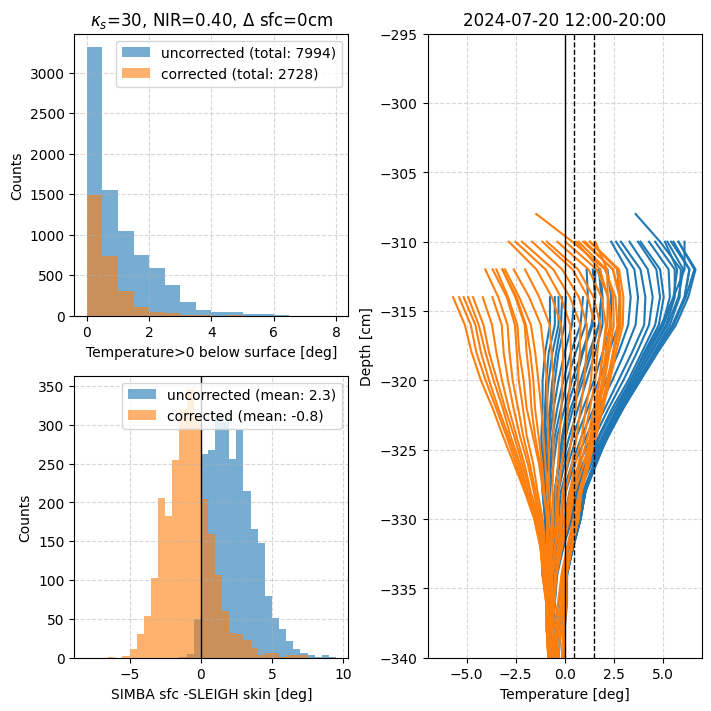

In [106]:
all_summary_values = {}

sfc_dif_i = 0.

for ks_i in np.arange(10,31,5):
    for sfc_dif_i in np.arange(-4,0.01,2):
        for fnir_i in np.arange(.4,.601,.05):
            
            simba_swn = f_swn(simba_seconds)
            simba_swn = np.ma.masked_equal(simba_swn, -999)
            
            simba_wspd = f_ws(simba_seconds)
            simba_wspd = np.ma.masked_equal(simba_wspd, -999)
            wr = np.percentile(simba_wspd[~simba_wspd.mask], np.arange(0,101,25)) ## 25% interval looks pretty good, what about many more?

            swt_out, wspd_2d_out = get_swt_for_correction(float(ks_i), fnir_i, 
                                                          simba_swn, simba_wspd, 
                                                          plt_fig=False)
            sub_temps_above_out, sub_swabs_above_out, sub_depths_out, sub_wspd_out = get_subsfc_above_zero_vals(simba_depths, swt_out, wspd_2d_out, 
                                                                                                                simba_sfc, sfc_dif_i, simba_temps, 
                                                                                                                melt_idx_in=False)
            ihs_params_out = get_ihs_correction(sub_wspd_out, sub_swabs_above_out, sub_temps_above_out, sub_depths_out, ks_i, 
                                                wind_ranges=wr, curve='ihs', plt_figs=False, binval='percentile')
        
            temp_correction_out = calc_temp_corrections(simba_sfc, sfc_dif_i, float(ks_i), fnir_i, simba_swn, 
                                                        simba_depths, ihs_params_out, plt_figs=False)
            
            mc_summary_vals = correct_compare_temp(temp_correction_out, simba_sfc, sfc_dif_i, ks_i, fnir_i, 
                                                   simba_temps, simba_depths, mc_fig_savepath, out_correct_t=False)
            
            all_summary_values[(sfc_dif_i, ks_i, fnir_i)] = mc_summary_vals


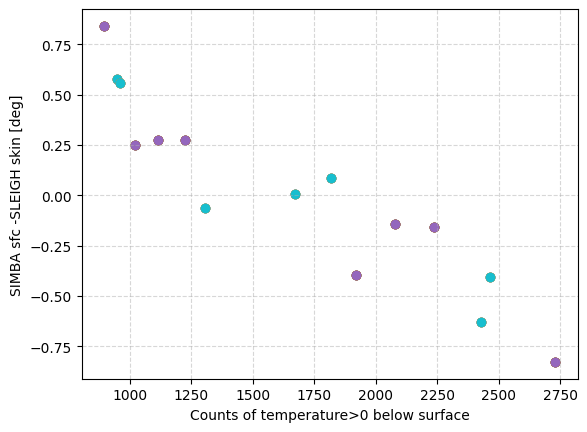

In [107]:
for key in all_summary_values:
    if np.ma.is_masked(all_summary_values[key]['above_zero_count']['corrected']) or np.ma.is_masked(all_summary_values[key]['ts_diff_mean']['corrected']):
        continue
    plt.scatter(all_summary_values[key]['above_zero_count']['corrected'], all_summary_values[key]['ts_diff_mean']['corrected'])

plt.ylabel('SIMBA sfc -SLEIGH skin [deg]')
plt.xlabel('Counts of temperature>0 below surface')
plt.grid(alpha=.5, ls='--')
# plt.xlim(250,300)
plt.show()

In [108]:
summary_varnames = ['ts_diff_mean', 'ts_diff_min', 'ts_diff_max', 'above_zero_count', 'above_0.5_count']

In [109]:
summary_arrays_corrected = {}
summary_arrays_uncorrected = {}
input_variables = {}

In [110]:
for varname in summary_varnames:
    var_array_corrected = np.array([ all_summary_values[key][varname]['corrected'] for key in all_summary_values] )
    var_array_uncorrected = np.array([ all_summary_values[key][varname]['uncorrected'] for key in all_summary_values] )

    summary_arrays_corrected[varname] = np.ma.masked_invalid(var_array_corrected)
    summary_arrays_uncorrected[varname] = np.ma.masked_invalid(var_array_uncorrected)

# (sfc_dif_i, ks_i, fnir_i)
summary_arrays_corrected['ts_diff_range'] = summary_arrays_corrected['ts_diff_max'] - summary_arrays_corrected['ts_diff_min']
pos_count_difference = summary_arrays_corrected['above_zero_count'] - summary_arrays_uncorrected['above_zero_count']

sfc_differences = np.array([ key[0] for key in all_summary_values] )
extinction_coefficients = np.array([ key[1] for key in all_summary_values] )
nir_fractions = np.array([ key[2] for key in all_summary_values] )


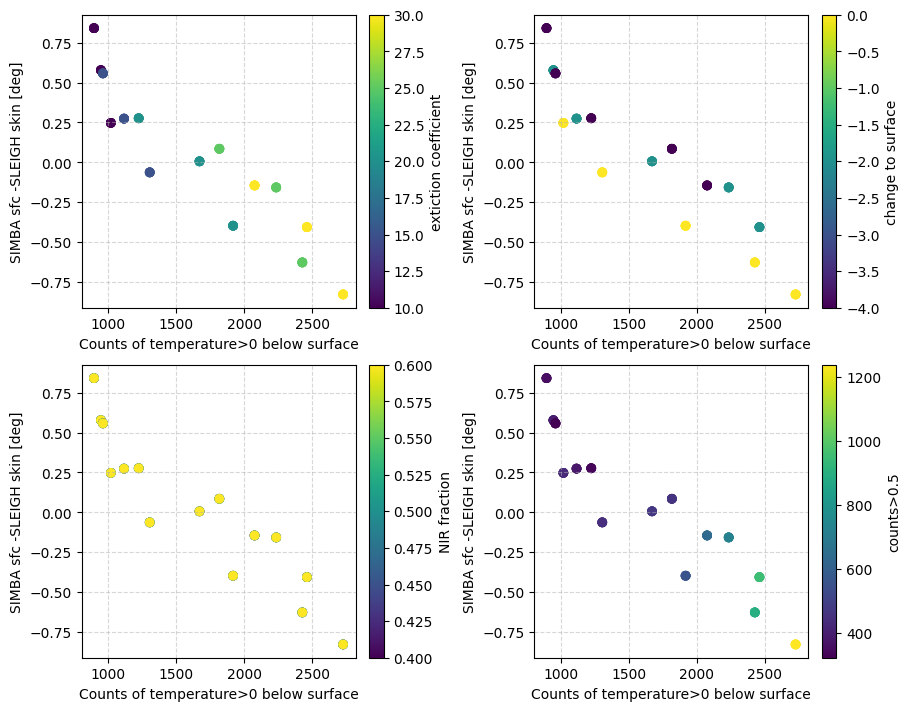

In [111]:
names = ['extiction coefficient','change to surface','NIR fraction','counts>0.5']
cvars = [extinction_coefficients, sfc_differences, nir_fractions, summary_arrays_corrected['above_0.5_count']]

fig, axs = plt.subplots(2,2, constrained_layout=True, figsize=(9,7))

# clevels = {'extiction coefficient':np.arange(15,41,5), 'change to surface':np.arange(-6,0.01,2), 
#            'NIR fraction':np.arange(0.4,0.61,0.1)}

for cname, cvar, ax in zip(names, cvars, axs.ravel()):
    cb = ax.scatter(summary_arrays_corrected['above_zero_count'], summary_arrays_corrected['ts_diff_mean'], c=cvar)
    # plt.errorbar(summary_arrays_corrected['above_zero_count'], summary_arrays_corrected['ts_diff_mean'], 
    #              np.array([summary_arrays_corrected['ts_diff_min'], summary_arrays_corrected['ts_diff_max']]), fmt='r^')
    
    
    plt.colorbar(cb, label=cname, ax=ax)

    ax.set_ylabel('SIMBA sfc -SLEIGH skin [deg]')
    ax.set_xlabel('Counts of temperature>0 below surface')
    ax.grid(alpha=.5, ls='--')
# plt.savefig('Raven_SIMBA_solar-correction_linear-IHS-theta-fit_ks-sfc-fnir_mc.png', dpi=200)
plt.show()

best result form above: fnir=0.5, ks=20,delta_sfc=-0.6

## Use what looks like the best values!

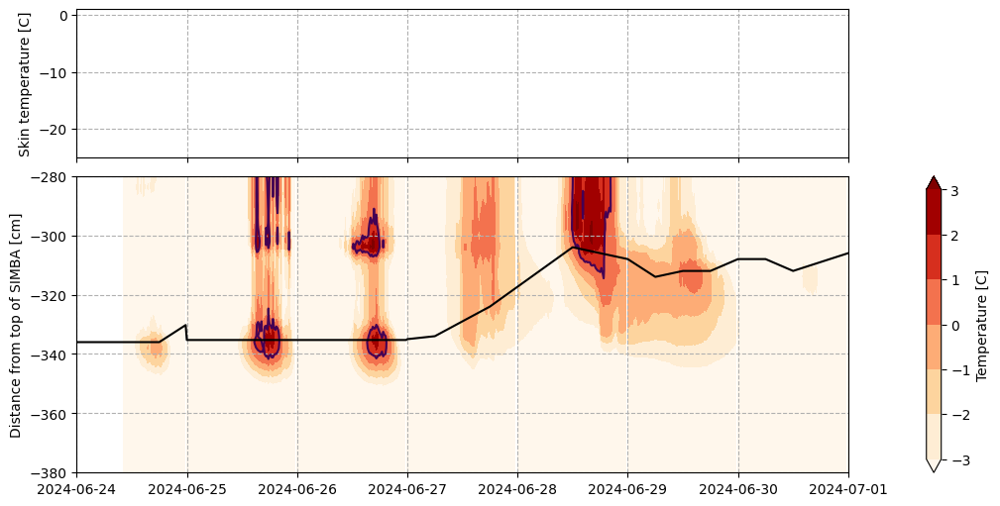

In [269]:
fig, axs = plt.subplots(2, figsize=(10,5), constrained_layout=True, sharex=True, gridspec_kw=dict(height_ratios=[1,2]))

axs[0].plot(np.squeeze(sleigh_dates), sleigh_skin-273.15)
axs[0].plot(np.squeeze(sleigh_dates), np.ma.masked_less(sleigh_skin-273.15, -0.32), c='r')
axs[0].set_ylabel('Skin temperature [C]')

cb = axs[1].contourf(simba_dates, simba_depths, np.swapaxes(simba_temps,0,1),
                cmap=plt.cm.OrRd, levels=np.arange(-3,4,1), extend='both')
axs[1].contour(simba_dates, simba_depths, np.swapaxes(simba_temps,0,1),
                levels=[1], extend='both')
plt.colorbar(cb, ax=axs[1], label='Temperature [C]')

# cb = axs[2].contourf(simba_dates, simba_depths, np.swapaxes(corrected_temps,0,1),
#                 cmap=plt.cm.OrRd, levels=np.arange(-3,4,1), extend='both')
# axs[2].contour(simba_dates, simba_depths, np.swapaxes(corrected_temps,0,1),
#                 levels=[0], extend='both')
# plt.colorbar(cb, ax=axs[2], label='Temperature [C]')

for i, ax in enumerate(axs.ravel()):
    ax.grid(ls='--')
    if i>0:
        ax.plot(simba_dates, simba_sfc, c='k')
        ax.plot(np.squeeze(sleigh_dates), asfs_data_lev2['snow_depth'][sleigh_idx]-350, c='c')
        ax.set_ylabel('Distance from top of SIMBA [cm]')
        ax.set_ylim(-380, -280)

axs[0].set_xlim(datetime.datetime(2024,6,24),datetime.datetime(2024,7,1))
axs[0].set_ylim(-25,1)

# axs[1].set_xlim(plt_times_not_smooth[0], plt_times_not_smooth[-1])
# plt.savefig('/home/asledd/ICECAPS/keff_retrieval/Raven_dtdz-flux-profile-timeseries_skinT_3level-smoothing-window.png', dpi=250)

plt.show()

In [34]:
f_skin = interpolate.interp1d(sleigh_seconds[~sleigh_skin.mask], sleigh_skin[~sleigh_skin.mask], 
                             fill_value=-999, bounds_error=False)

simba_skin = f_skin(simba_seconds)
simba_skin = np.ma.masked_equal(simba_skin, -999)

melt_idx = np.where(simba_skin>=273.15-0.32)[0]

/tmp/ipykernel_932538/1640716570.py:90: UserWarning: Adding colorbar to a different Figure <Figure size 1000x400 with 4 Axes> than <Figure size 400x400 with 1 Axes> which fig.colorbar is called on.
  plt.colorbar(cb, label='Depth below surface [cm]', ax=axs[-1])


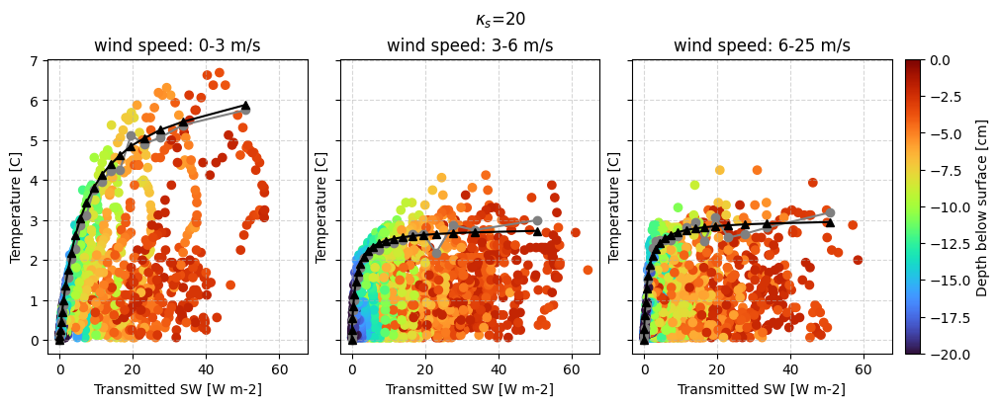

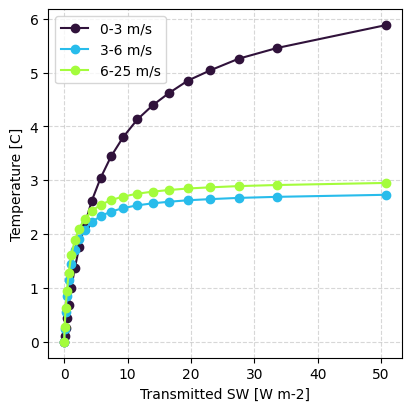

{(0, 3): (np.float64(7.508593398485152), np.float64(6.56491191846499)), (3, 6): (np.float64(1.2471072528608198), np.float64(2.783638377968373)), (6, 25): (np.float64(1.1717658534854898), np.float64(3.004645940974577))}
(0, 3) 6.019856237051749 82.92850500000003
(3, 6) 2.7447555642120434 88.03387
(6, 25) 2.9647635771210683 87.1063895833334


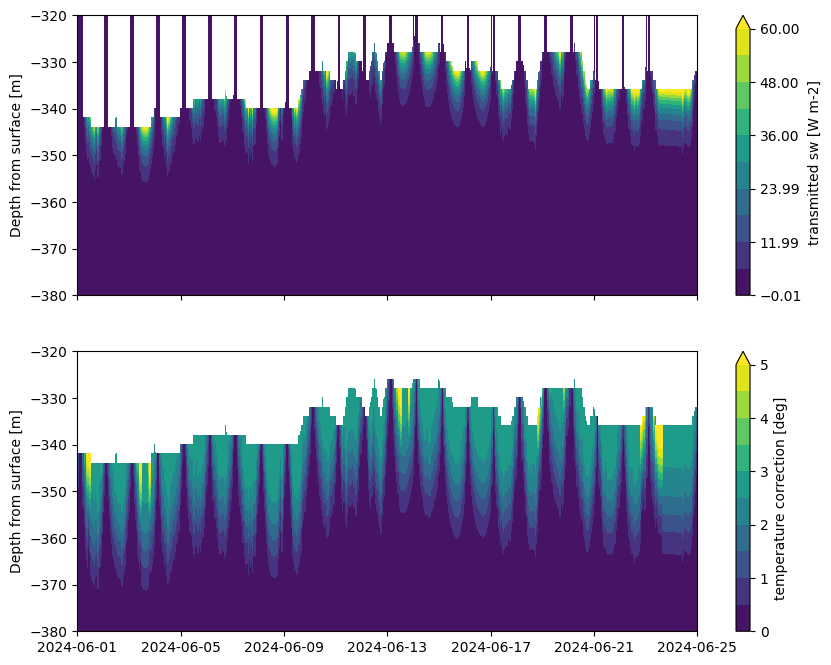

(6335, 241) (6335, 241)


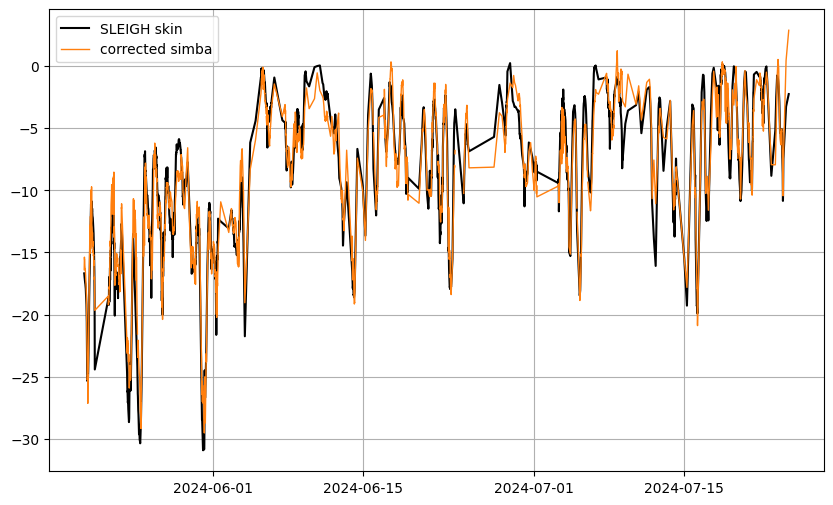

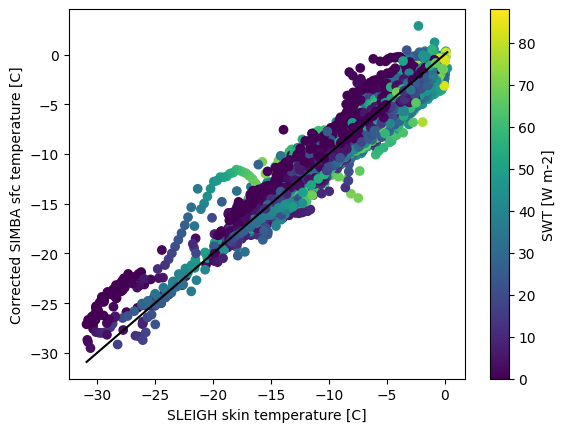

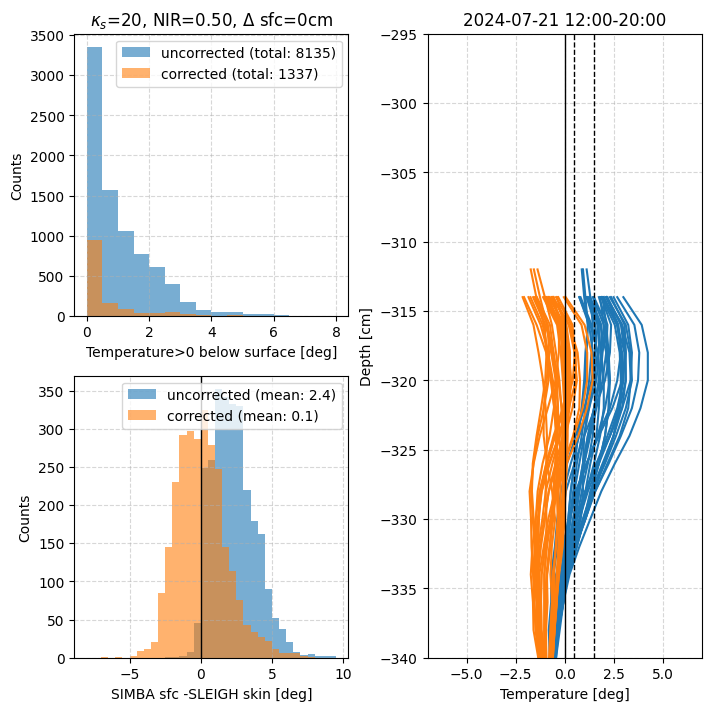

In [37]:
simba_swn = f_swn(simba_seconds)
simba_swn = np.ma.masked_equal(simba_swn, -999)

simba_wspd = f_ws(simba_seconds)
simba_wspd = np.ma.masked_equal(simba_wspd, -999)

# simba_wspd = simba_wspd**2

ks_i = 20.
fnir_i = 0.5
sfc_dif_i = 0.#-6.

swt_out, wspd_2d_out = get_swt_for_correction(float(ks_i), fnir_i, 
                                              simba_swn, simba_wspd, 
                                              plt_fig=False)
sub_temps_above_out, sub_swabs_above_out, sub_depths_out, sub_wspd_out = get_subsfc_above_zero_vals(simba_depths, swt_out, wspd_2d_out, 
                                                                                                    simba_sfc, sfc_dif_i, simba_temps, 
                                                                                                    melt_idx_in=False)
wr = [0,3,6,25]
# wr = [(0,2),(1,3),(2,4),(3,5),(5,25)]
# wr = [(0,3),(0,2),(1,3),(2,4),(3,5),(5,25)]

# wr = [0,2,4,25]
# wr = np.percentile(simba_wspd[~simba_wspd.mask], np.arange(0,101,25)) ## 25% interval looks pretty good, what about many more?
# ihs_params = get_ihs_correction(sub_wspd_out, sub_swabs_above_out, sub_temps_above_out, sub_depths_out, ks_i, 
#                                     wind_ranges=wr, plt_figs=True, curve='func', binval='percentile', p=90) #max



## choosing 85 vs 90 percentile impacts amount of correction for clearsky (high SWN) times
## colder temps are biased warm possibly because of greater thermistor uncertainty?
## so mean difference in surface-skin temp can look good with over correction
## divide into clear/cloudy and warm/cold times?
func_params = get_func_correction(sub_wspd_out, sub_swabs_above_out, sub_temps_above_out, sub_depths_out, ks_i, 
                                    wind_ranges=wr, plt_figs=True, binval='percentile', p=85) #max
# print('TESTING?')
# _ = get_spline_correction(sub_wspd_out, sub_swabs_above_out, sub_temps_above_out, sub_depths_out, ks_i, 
#                                     wind_threshold=3, plt_figs=True, binval='percentile', p=90, s=5, k=2)

temp_correction_out, swt_out = calc_temp_corrections(simba_sfc, sfc_dif_i, float(ks_i), fnir_i, simba_swn, 
                                            simba_depths, func_params, plt_figs=True, param_interp='bin', swt=True)

mc_summary_vals, corrected_temps_new = correct_compare_temp(temp_correction_out, simba_sfc, sfc_dif_i, ks_i, fnir_i, 
                                       simba_temps, simba_depths, mc_fig_savepath, out_correct_t=True, swi=swt_out)

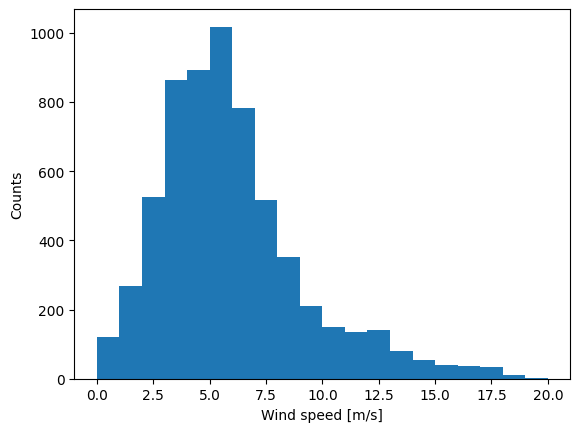

In [125]:
plt.hist(simba_wspd, bins=np.arange(0,21,1))
plt.xlabel('Wind speed [m/s]')
plt.ylabel('Counts')
plt.show()

In [254]:
print(corr_sfc_temp.shape, corrected_temps.shape)

(2599,) (6335, 241)


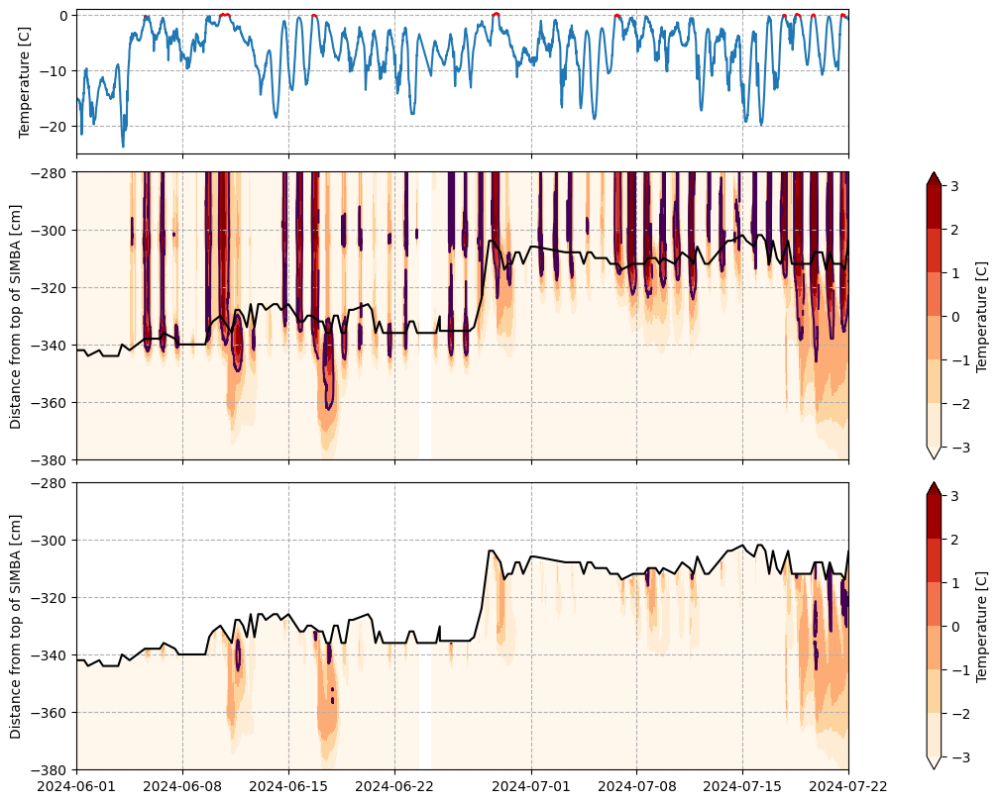

In [39]:
fig, axs = plt.subplots(3, figsize=(10,8), constrained_layout=True, sharex=True, gridspec_kw=dict(height_ratios=[1,2,2]))

axs[0].plot(simba_dates, simba_skin-273.15, label='SLEIGH skin')
axs[0].plot(simba_dates, np.ma.masked_less(simba_skin-273.15, -0.32), c='r')
axs[0].set_ylabel('Temperature [C]')

# axs[0].plot(simba_dates, corr_sfc_temp, label='corrected SIMBA sfc')

cb = axs[1].contourf(simba_dates, simba_depths, np.swapaxes(simba_temps,0,1),
                cmap=plt.cm.OrRd, levels=np.arange(-3,4,1), extend='both')
axs[1].contour(simba_dates, simba_depths, np.swapaxes(simba_temps,0,1),
                levels=[0], extend='both')
plt.colorbar(cb, ax=axs[1], label='Temperature [C]')

cb = axs[2].contourf(simba_dates, simba_depths, np.swapaxes(corrected_temps_new,0,1),
                cmap=plt.cm.OrRd, levels=np.arange(-3,4,1), extend='both')
axs[2].contour(simba_dates, simba_depths, np.swapaxes(corrected_temps_new,0,1),
                levels=[0], extend='both')
plt.colorbar(cb, ax=axs[2], label='Temperature [C]')

for i, ax in enumerate(axs.ravel()):
    ax.grid(ls='--')
    if i>0:
        ax.plot(simba_dates, simba_sfc, c='k')
        # ax.plot(simba_dates, simba_sfc-6.,  c='k')# ls='--',

        # ax.plot(sleigh_dates, asfs_data_lev2['snow_depth']-350, c='c')
        ax.set_ylabel('Distance from top of SIMBA [cm]')
        ax.set_ylim(-380, -280)

axs[0].set_xlim(datetime.datetime(2024,6,1),datetime.datetime(2024,7,22))
axs[0].set_ylim(-25,1)

# axs[1].set_xlim(plt_times_not_smooth[0], plt_times_not_smooth[-1])

# plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_skinT_un_corrected_simba_temps_20ks_0.5nir_-6sfc.png', dpi=250)

plt.show()

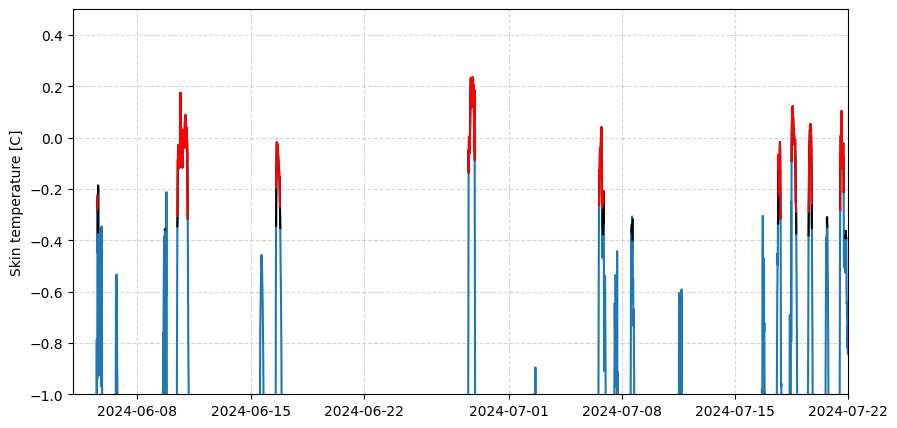

In [188]:
fig, ax = plt.subplots(1, figsize=(10,5))
plt.plot(simba_dates, simba_skin-273.15)
plt.plot(simba_dates, np.ma.masked_less(simba_skin-273.15, -0.4), c='k')
plt.plot(simba_dates, np.ma.masked_less(simba_skin-273.15, -0.32), c='r')

plt.ylabel('Skin temperature [C]')
plt.grid(ls='--', alpha=.5)
plt.ylim(-1,.5)
plt.xlim(dt(2024,6,4), dt(2024,7,22))
# plt.xlim(dt(2024,6,4), dt(2024,6,15))

plt.show()

## This should probably be in a different file, but this is what I have open

Want to get temperature profiles relative *to the surface*

In [40]:
depths_rel_to_sfc = np.repeat(simba_depths[np.newaxis,:], simba_temps.shape[0], axis=0)

sfc_2d = np.ma.repeat(simba_sfc[:,np.newaxis], simba_temps.shape[1], axis=1)
depths_rel_to_sfc = depths_rel_to_sfc-sfc_2d

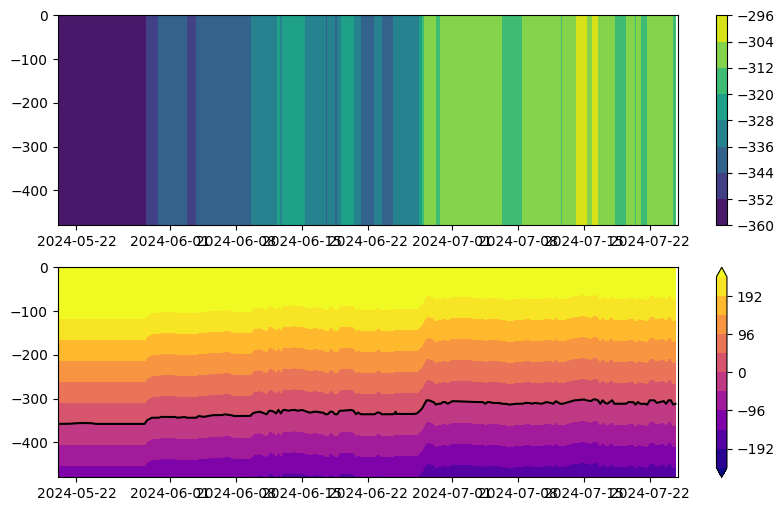

In [41]:
fig, axs = plt.subplots(2, figsize=(10,6))
cb = axs[0].contourf(simba_dates, simba_depths, np.swapaxes(sfc_2d,0,1),)
plt.colorbar(cb, ax=axs[0])

cb = axs[1].contourf(simba_dates, simba_depths, np.swapaxes(depths_rel_to_sfc,0,1),
                    cmap='plasma', levels=np.linspace(-240,240,11), extend='both')
axs[1].plot(simba_dates, simba_sfc,  c='k')
plt.colorbar(cb, ax=axs[1])
plt.show()

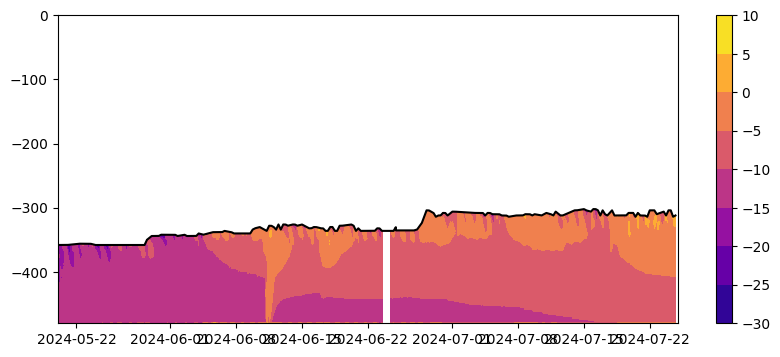

In [42]:
fig, axs = plt.subplots(1, figsize=(10,4))

temp_temp = np.ma.masked_where(depths_rel_to_sfc>0, corrected_temps_new)# temporary temperature
cb = plt.contourf(simba_dates, simba_depths, np.swapaxes(temp_temp,0,1), cmap='plasma')
plt.plot(simba_dates, simba_sfc,  c='k')
plt.colorbar(cb)
plt.show()

In [43]:
temps_rel_to_sfc = []

m = 100 # size of 

for i in range(temp_temp.shape[0]):
    temp_i = temp_temp[i,:-1]
    sub_t = temp_i[~temp_i.mask]

    sub_t_filled = np.ma.concatenate( (sub_t, np.full(int(m-sub_t.count()), -999 )) )
    temps_rel_to_sfc.append(sub_t_filled)
    
temps_rel_to_sfc = np.ma.masked_equal(temps_rel_to_sfc, -999)
# print(max(temps_rel_to_sfc))

In [44]:
sub_depths = np.arange(0,temps_rel_to_sfc.shape[1])
sub_depths *= -2

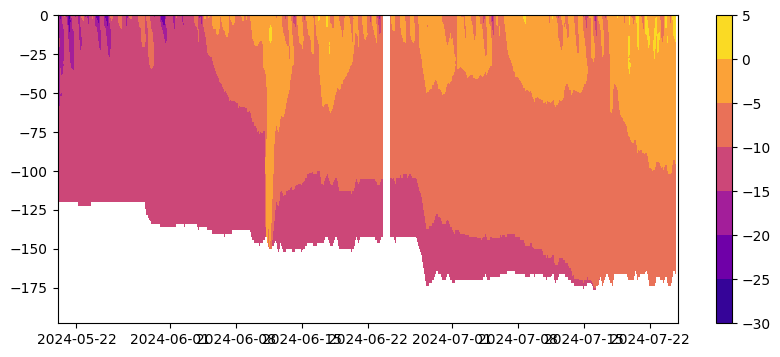

In [45]:
fig, axs = plt.subplots(1, figsize=(10,4))

cb = plt.contourf(simba_dates, sub_depths, np.swapaxes(temps_rel_to_sfc,0,1), cmap='plasma')
# plt.plot(simba_dates, simba_sfc-6.,  c='k')
plt.colorbar(cb)

# plt.xlim(dt(2024,6,8),dt(2024,6,15))
plt.show()

In [46]:
print(temps_rel_to_sfc.shape)

(6335, 100)


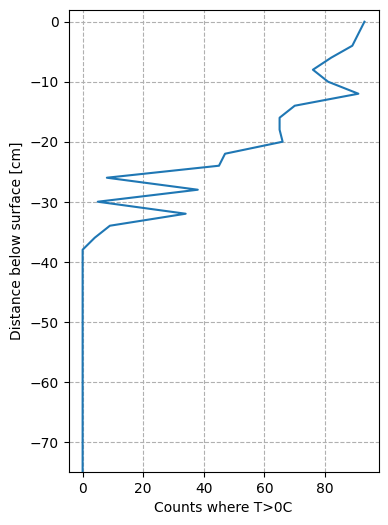

In [47]:
fig, ax = plt.subplots(1, figsize=(4,6))


above_zero_counts = np.ma.masked_less(temps_rel_to_sfc.copy(), 0).count(axis=0)

# for tprofile in temps_rel_to_sfc[np.where((simba_dates>dt(2024,6,15))&(simba_dates>dt(2024,6,17)))[0]]:
plt.plot(above_zero_counts, sub_depths)
plt.grid(ls='--')
plt.ylim(-75,2)
plt.xlabel('Counts where T>0C')
plt.ylabel('Distance below surface [cm]')
plt.show()

In [48]:
dates_2d = np.ma.repeat(simba_dates[:,np.newaxis], temps_rel_to_sfc.shape[1], axis=1)


In [49]:
print(dates_2d.shape, temps_rel_to_sfc.shape)

(6335, 100) (6335, 100)


In [50]:
temp_masked_perc = np.ma.masked_where( (dates_2d>=dt(2024,6,11))&(dates_2d<dt(2024,6,12)), temps_rel_to_sfc)

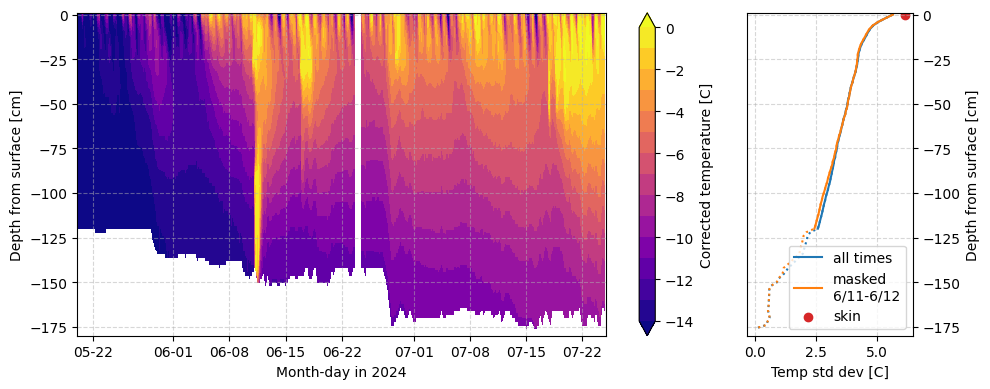

In [51]:
temp_counts = temps_rel_to_sfc.count(axis=0)

temp_std_profile = temps_rel_to_sfc.std(axis=0)
temp_std_profile_masked = temp_masked_perc.std(axis=0)

l = temps_rel_to_sfc.count(axis=0)[0]
temp_std_full = np.ma.masked_where(temp_counts<l, temp_std_profile)
temp_std_full_masked = np.ma.masked_where(temp_counts<l, temp_std_profile_masked)

fig, axs = plt.subplots(1, 2, figsize=(10,4), gridspec_kw=dict(width_ratios=[4,1]))

cb = axs[0].contourf(simba_dates, sub_depths, np.swapaxes(temps_rel_to_sfc,0,1), cmap='plasma',
                    levels=np.arange(-14,0.1,1), extend='both')
plt.colorbar(cb, label='Corrected temperature [C]', ax=axs[0])

axs[1].plot(temp_std_profile, sub_depths,ls=':', c='tab:blue')
axs[1].plot(temp_std_profile_masked, sub_depths, ls=':', c='tab:orange')

axs[1].plot(temp_std_full, sub_depths, label='all times', c='tab:blue')
axs[1].plot(temp_std_full_masked, sub_depths, label='masked\n6/11-6/12', c='tab:orange')

axs[1].scatter(simba_skin.std(), 0, c='tab:red', label='skin')

axs[1].legend(loc='lower right')

axs[1].set_xlabel('Temp std dev [C]')

axs[1].yaxis.set_label_position("right")
axs[1].yaxis.tick_right()

axs[0].xaxis.set_major_formatter(myFmt)
axs[0].set_xlabel('Month-day in 2024')

for ax in axs.ravel():
    ax.grid(ls='--', alpha=.5)
    ax.set_ylim(-180,1)
    ax.set_ylabel('Depth from surface [cm]')

plt.tight_layout()
# plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_corrected-simba_20ks_0.5nir_-6sfc_temp-rel-to-sfc_std-dev-depths.png', dpi=250)

plt.show()

### wavelet decomposition?

In [245]:
from scipy.signal import cwt, morlet


In [246]:
## shorten timeseries to avoid masked data
short_idx = np.where((simba_dates>=dt(2024,5,15))&(simba_dates<dt(2024,6,22)))[0]
short_temp_rel_sfc = temps_rel_to_sfc[short_idx]

In [247]:
## from https://medium.com/pythoneers/wavelet-transform-a-practical-approach-to-time-frequency-analysis-662bdadeb08b

# extract the seismic data from the trace
# seismic_data = tr.data
times = np.linspace(0, short_temp_rel_sfc.shape[0])

# increase the range and resolution of scales
## IDK WHAT THIS MEANS!
scales = np.arange(1, 256)

# perform wavelet transform using the Morlet wavelet
coefficients = cwt(short_temp_rel_sfc, morlet, scales)

# plot the original signal and the wavelet transform result
plt.figure(figsize=(12, 6))

# plot the seismic signal (time domain)
plt.subplot(2, 1, 1)
plt.plot(times, short_temp_rel_sfc)
plt.title('Seismic Signal (Time Domain)')
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')

# plot the wavelet transform (time-frequency domain) with adjusted color scaling
plt.subplot(2, 1, 2)
plt.imshow(np.abs(coefficients), extent=[times[0], times[-1], scales[-1], scales[0]],
           cmap='inferno', aspect='auto', vmax=np.percentile(np.abs(coefficients), 99),
           vmin=np.percentile(np.abs(coefficients), 1))
plt.title('Wavelet Transform (Time-Frequency Domain)')
plt.xlabel('Time [s]')
plt.ylabel('Scale')
plt.colorbar(label='Magnitude')
plt.tight_layout()
plt.show()

/tmp/ipykernel_459999/2573355581.py:12: DeprecationWarning: scipy.signal.cwt is deprecated in SciPy 1.12 and will be removed
in SciPy 1.15. We recommend using PyWavelets instead.

  coefficients = cwt(short_temp_rel_sfc, morlet, scales)


ValueError: volume and kernel should have the same dimensionality

## Cold content(?) calculation

In [52]:
# rho_s = 300. # kg m-3
c_i = 2.1*10**-3 # MJ kg-1 C-1
# d_s = .2 # m
d = 0.02 # m
T_m = 0. # C

# rough estimates from snow pits at install and demob; maximum range
# now averaged in upper 20 cm
# rho_lo = np.linspace(50, 120, temps_rel_to_sfc.shape[0])
# rho_hi = np.linspace(300, 400, temps_rel_to_sfc.shape[0])
rho_lo = np.linspace(238, 229, temps_rel_to_sfc.shape[0])
rho_hi = np.linspace(328, 379, temps_rel_to_sfc.shape[0])


d_layer = 20

# cold content units: MJ m−2
# Eq 2 in https://doi.org/10.5194/tc-12-1595-2018
cold_content_lo = c_i*rho_lo*d*temps_rel_to_sfc[:,np.where(sub_depths>=-d_layer)[0]].sum(axis=1)
cold_content_hi = c_i*rho_hi*d*temps_rel_to_sfc[:,np.where(sub_depths>=-d_layer)[0]].sum(axis=1)

cc_avg_lo = c_i*rho_lo*0.2*temps_rel_to_sfc[:,np.where(sub_depths>=-d_layer)[0]].mean(axis=1)
cc_avg_hi = c_i*rho_hi*0.2*temps_rel_to_sfc[:,np.where(sub_depths>=-d_layer)[0]].mean(axis=1)

## Saving for michael

with open('Raven_2024_20cm_cold_content_range_20250307.csv', 'w', ) as myfile:
    wr = csv.writer(myfile, quoting=csv.QUOTE_ALL)
    myfile.write("{},{}\n".format("Dates", "Low cold content [MJ m-2]", "High cold content [MJ m-2]", "Low Density [kg m-3]", "High Density [kg m-3]"))
    for item1, item2, item3, item4, item5 in zip(simba_dates, cold_content_lo, cold_content_hi, rho_lo, rho_hi):
        wr.writerow([item1, item2, item3, item4, item5])
        

In [53]:
print((simba_skin-273.15).mean(), temps_rel_to_sfc[:,0].mean(), sub_depths[0])

-7.9484395273631305 -7.806796507588904 0


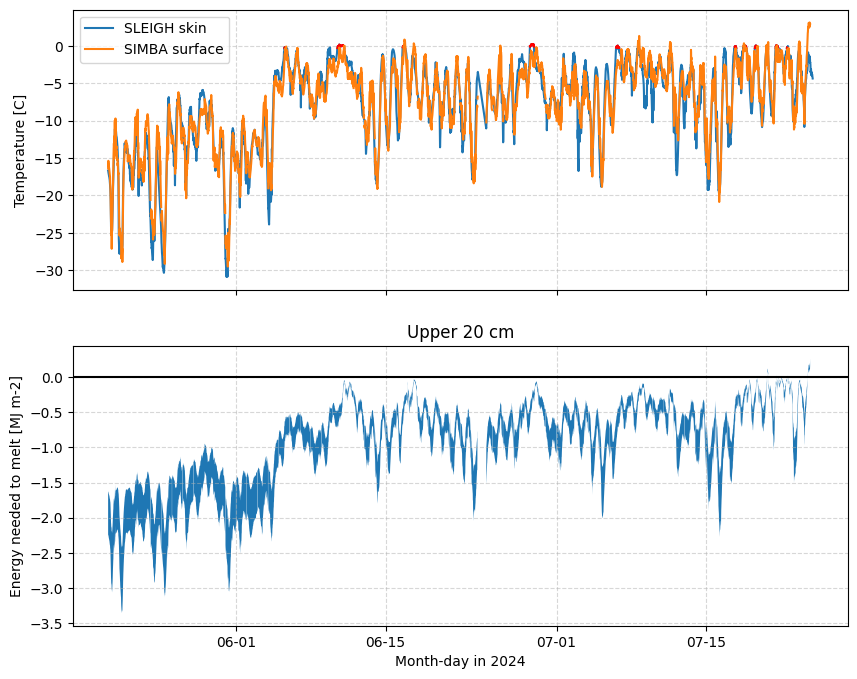

In [54]:
fig, axs = plt.subplots(2, figsize=(10,8), sharex=True)

axs[0].plot(simba_dates, simba_skin-273.15, label='SLEIGH skin')
# plt.plot(simba_dates, np.ma.masked_less(simba_skin-273.15, -0.4), c='k')
axs[0].plot(simba_dates, np.ma.masked_less(simba_skin-273.15, -0.32), c='r')

axs[0].plot(simba_dates, temps_rel_to_sfc[:,0], label='SIMBA surface')
axs[0].legend(loc='best')
axs[0].set_ylabel('Temperature [C]')

for ax in axs.ravel():
    ax.grid(ls='--', alpha=.5)


axs[1].fill_between(simba_dates, cold_content_lo, cold_content_hi)
# plt.plot(simba_dates, cc_avg_lo,c='tab:red')

axs[1].set_ylabel('Energy needed to melt [MJ m-2]')

axs[1].xaxis.set_major_formatter(myFmt)
axs[1].set_xlabel('Month-day in 2024')
axs[1].set_title('Upper {:.0f} cm'.format(d_layer))
axs[1].axhline(y=0,c='k')

# add: skin temperature, net radiation (SEB), GPR melt probability, others...?
# plt.savefig('/home/asledd/ICECAPS/simba_solar_correction_figs/Raven_corrected-simba_20ks_0.5nir_-6sfc_cold-content_sum-t.png', dpi=250)

plt.show()

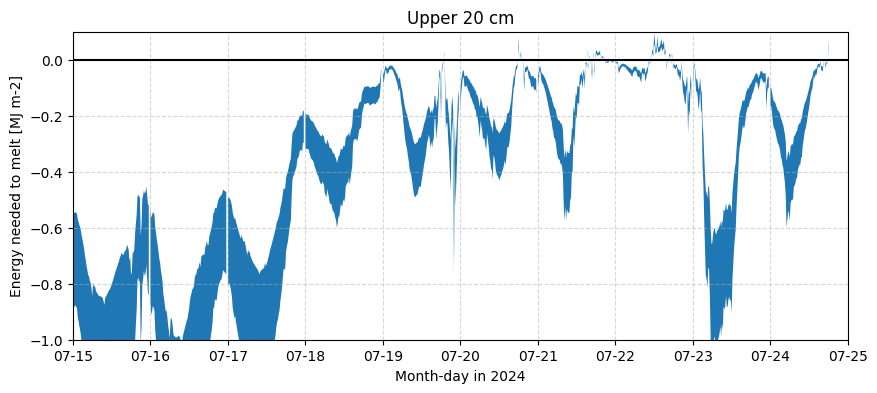

In [184]:
fig, ax = plt.subplots(1, figsize=(10,4))
plt.fill_between(simba_dates, cold_content_lo, cold_content_hi)
# plt.plot(simba_dates, cc_avg_lo,c='tab:red', lw=1)
# plt.plot(simba_dates, cc_avg_hi,c='tab:red', lw=1)

plt.ylabel('Energy needed to melt [MJ m-2]')
plt.grid(ls='--', alpha=.5)
ax.xaxis.set_major_formatter(myFmt)
ax.set_xlabel('Month-day in 2024')
plt.title('Upper {:.0f} cm'.format(d_layer))
plt.axhline(y=0,c='k')
plt.xlim(dt(2024,7,15), dt(2024,7,25))
plt.ylim(-1.,.1)
# add: skin temperature, net radiation (SEB), GPR melt probability, others...?
plt.show()